# Open Food Facts Data Clustering

### Part 1 Data Preprocessing <a class="anchor" id="chapter1"></a>

***Data preprocessing***, also known as data preparation or cleaning, involves the identification and rectification or removal of corrupt or inaccurate entries within a dataset. It encompasses the task of discerning incorrect, incomplete, or irrelevant segments of the data and subsequently modifying, replacing, or eliminating such erroneous or coarse data components.


### 1.1 Load and Prepare the Data
First, ensure the necessary libraries are imported and the dataset is loaded.

In [3]:
# Import necessary libraries
import re
import json
import squarify
import numpy as np
import pandas as pd
import seaborn as sns
import missingno as msno
import plotly.express as px
import plotly.graph_objs as go
import matplotlib.pyplot as plt
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MultiLabelBinarizer

In [4]:
# Load the dataset
df = pd.read_csv('en.openfoodfacts.org.products.tsv', sep='\t', header=0, low_memory=False)

### 1.2 Understand the Data

- Check the data size
- Display the first few rows of dataset to understand the structure.


In [5]:
df.shape

(356027, 163)

The data consists of 356,027 rows and 163 columns

In [6]:
# Check the first few rows to understand the structure
df.head()

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,fruits-vegetables-nuts_100g,fruits-vegetables-nuts-estimate_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
0,0000000003087,http://world-en.openfoodfacts.org/product/0000...,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,NaN,1kg,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0000000004530,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.0,14.0,NaN,NaN
2,0000000004559,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Peanuts,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN
3,0000000016087,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489055731,2017-03-09T10:35:31Z,1489055731,2017-03-09T10:35:31Z,Organic Salted Nut Mix,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,12.0,NaN,NaN
4,0000000016094,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489055653,2017-03-09T10:34:13Z,1489055653,2017-03-09T10:34:13Z,Organic Polenta,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 1.2.1 Set Index

Since the code should be unique to each product, thus we will check whether the code is unique in the dataset.

In [7]:
is_code_unique = df['code'].is_unique
is_code_unique

False

The 'False' from the .is_unique function indicates that the code is not unique, which means there is some duplicate code in the dataset.

In [8]:
# Get a boolean mask indicating duplicated values in the 'code' column
duplicated_mask = df['code'].duplicated()

# Use the mask to filter out the duplicated rows
duplicated_rows = df[duplicated_mask]

# Print the rows with duplicated 'code' values
duplicated_rows

,code,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,...,fruits-vegetables-nuts_100g,fruits-vegetables-nuts-estimate_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
193944,NaN,NaN,"villecomtal-sur-arros-gers-france,saint-just-c...","Villecresnes,Villeurbanne,France","Dia,Sogeres",France,en:france,France,"_Lait_ entier (59,5 %), _lait_ écrémé concentr...","Lait, lait, crème",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
193950,NaN,NaN,villecomtal-sur-arros-gers-france,France,NaN,"Belgique,France, en:switzerland","en:belgium,en:france,en:switzerland","Belgium,France,Switzerland","Lait entier 69.5 %, fruits : fraise 10 %, mang...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
193960,NaN,NaN,villecomtal-sur-arros-gers-france,"Veynes,France",Super U,France,en:france,France,"_Lait_ entier (78%), fruits : mangue, abricot...",Lait,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
193993,NaN,NaN,villecomtal-sur-arros-gers-france,"Torcy 77,France",Carrefour,France,en:france,France,"_Lait_ écrémé, _lait_ écrémé concentré ou en p...","Lait, lait",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
194001,NaN,NaN,villecomtal-sur-arros-gers-france,France,NaN,France,en:france,France,"_Lait_ écrémé, fruits : fraise (12 %), cerise ...","Lait, lait",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
194003,NaN,NaN,villecomtal-sur-arros-gers-france,"Saint-Priest,France",Auchan,France,en:france,France,"_Lait_ écrémé, _lait_ écrémé concentré ou en p...","Lait, lait, lait, lait, lait",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
194009,NaN,NaN,villecomtal-sur-arros-gers-france,NaN,NaN,France,en:france,France,"_Lait_ entier (59,5 %), _lait_ écrémé concentr...","Lait, lait, crème, lactiques",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
194055,NaN,NaN,villecomtal-sur-arros-gers-france,"Villers Bocage 80260,France,Lille","Banque alimentaire,Carrefour,Leclerc,E.Leclerc",France,en:france,France,"_Lait_ écrémé (72,6% en moyenne) (Origine Fran...","Lait, lait, lactiques",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
194084,NaN,NaN,villecomtal-sur-arros-gers-france,"Villers Bocage 80260,France",Carrefour market,France,en:france,France,"_Lait_ entier, rhubarbe (8 %), sucre (8 %), la...","Lait, lait, lait",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
194086,NaN,NaN,villecomtal-sur-arros-gers-france,"Villers Bocage 80260,France",Carrefour market,France,en:france,France,"_Lait_ entier, ananas (8 %), sucre (7,1 %), _l...","Lait, lait, lait, lait",...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


The results indicate rows with invalid 'code' values (e.g., NAN). Although the code may not significantly impact the analysis since it would not be used as a feature, the corresponding columns, such as categories, manufacturing_place, and allergens, are all filled with invalid (incompatible data type) entries. This suggests a parsing error or insertion error. In this case, we will consider dropping these invalid rows, which might affect the result.

In [9]:
# Drop rows where 'code' is NaN
df.dropna(subset=['code'], inplace=True)

# Set 'code' column as the index of the DataFrame
df.set_index('code', inplace=True)

In [10]:
print(f"Now the code is unique: {df.index.is_unique}")
# Check again the structure of the data
df.head()

Now the code is unique: True


,url,creator,created_t,created_datetime,last_modified_t,last_modified_datetime,product_name,generic_name,quantity,packaging,...,fruits-vegetables-nuts_100g,fruits-vegetables-nuts-estimate_100g,collagen-meat-protein-ratio_100g,cocoa_100g,chlorophyl_100g,carbon-footprint_100g,nutrition-score-fr_100g,nutrition-score-uk_100g,glycemic-index_100g,water-hardness_100g
code,,,,,,,,,,,,,,,,,,,,,
0000000003087,http://world-en.openfoodfacts.org/product/0000...,openfoodfacts-contributors,1474103866,2016-09-17T09:17:46Z,1474103893,2016-09-17T09:18:13Z,Farine de blé noir,NaN,1kg,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0000000004530,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.0,14.0,NaN,NaN
0000000004559,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489069957,2017-03-09T14:32:37Z,1489069957,2017-03-09T14:32:37Z,Peanuts,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN
0000000016087,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489055731,2017-03-09T10:35:31Z,1489055731,2017-03-09T10:35:31Z,Organic Salted Nut Mix,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,12.0,NaN,NaN
0000000016094,http://world-en.openfoodfacts.org/product/0000...,usda-ndb-import,1489055653,2017-03-09T10:34:13Z,1489055653,2017-03-09T10:34:13Z,Organic Polenta,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


### 1.2.2 Dropping Uninteresting Columns

Upon reviewing the dataset, we have identified several columns that we deem uninteresting and do not intend to use for the investigation. Most of these columns contain text data, repeated information, or are unrelated to our analysis. Therefore, we will drop these columns from the dataset.

In [11]:
# Manually drop unnecessary columns
drop_df = df.drop(columns=[
    'url',
    'creator',
    'created_t',
    'last_modified_t',
    'generic_name',
    'quantity',
    'packaging',
    'packaging_tags',
    'brands_tags',
    'categories',
    'categories_tags',
    'categories_en',
    'pnns_groups_1',
    'pnns_groups_2',
    'main_category',
    'origins',
    'origins_tags',
    'manufacturing_places',
    'manufacturing_places_tags',
    'labels',
    'labels_tags',
    'emb_codes',
    'emb_codes_tags',
    'first_packaging_code_geo',
    'cities',
    'cities_tags',
    'purchase_places',
    'stores',
    'countries',
    'countries_tags',
    'traces',
    'traces_tags',
    'traces_en',
    'additives',
    'no_nutriments',
    'states',
    'states_tags',
    'states_en',
    'main_category',
    'image_url',
    'image_small_url',
    'last_modified_datetime',
    'allergens',
    'allergens_en'
])

These columns consist of:

***Unrelated Column***:
1. **URL-related Columns (url, image_url, image_small_url)**: These are typically links to images or product pages. While they might be useful for web scraping or linking back to original sources, they don't contribute to numerical or categorical data analysis.
2. **Identification and Timestamps (creator, created_t, last_modified_t, last_modified_datetime)**: Information about who created the entry and timestamps of creation or modification is essential for database management but often irrelevant for analysis focused on product characteristics or nutritional information.
3. **Generic Descriptors (generic_name, quantity, packaging, packaging_tags, brands_tags)**: While these provide additional context about the products, they do not contribute to the specific objectives of the analysis.
4. **Origins (origins, origins_tags, manufacturing_places, manufacturing_places_tags)**: These columns are consider redundant as the analysis focuses on nutritional information rather than geographic or categorical distinctions.
5. **Geographic and Purchase Details (cities, cities_tags, purchase_places, stores)**: Geographic information is crucial for market analysis but may be unnecessary for nutritional or health-related studies.
6. **Nutritional and State Details (no_nutriments, states, states_tags, states_en, main_category)**: These might include various states of data entry completeness or categorisations that are not aligned with the analysis goals.

***Complex and Non standardised values***:
1. **Traces and Additives (traces, traces_tags, additives)**: Detailed lists of ingredients might good for understanding product composition. However, since this information is overly detailed and hard to quantify, simplifying by removing these columns might be beneficial.
2. **Allergens (traces, traces_tags, traces_en, allergens, allergens_en)**: Same as previous, the values in not standardised as they have written in multiple type of language, due to the nature of environment, these type of columns will be dropped.

***Repeated Information***:
1. **Categorisation (categories, categories_tags,categories_en,pnns_groups_1,pnns_groups_2, main_category)**: These columns provide detailed categorisation, but they might be considered redundant as similar information is captured in other column 'main_category_en'.
2. **Additives (additives)**: Similar situation as above, the information can be captured from other columns (additives_n,additives_tags,additives_en), the column seem redundant.
3. **Countries (countries, countries_tags)**:Repeated info which can captured from single column: countries_en which is considered more standardised.

In [12]:
# Check again the columns in the DataFrame
column_names = drop_df.columns.values
print("The columns left in the DataFrame are:", column_names)

The columns left in the DataFrame are: ['created_datetime' 'product_name' 'brands' 'labels_en' 'countries_en'
 'ingredients_text' 'serving_size' 'additives_n' 'additives_tags'
 'additives_en' 'ingredients_from_palm_oil_n' 'ingredients_from_palm_oil'
 'ingredients_from_palm_oil_tags'
 'ingredients_that_may_be_from_palm_oil_n'
 'ingredients_that_may_be_from_palm_oil'
 'ingredients_that_may_be_from_palm_oil_tags' 'nutrition_grade_uk'
 'nutrition_grade_fr' 'main_category_en' 'energy_100g'
 'energy-from-fat_100g' 'fat_100g' 'saturated-fat_100g'
 '-butyric-acid_100g' '-caproic-acid_100g' '-caprylic-acid_100g'
 '-capric-acid_100g' '-lauric-acid_100g' '-myristic-acid_100g'
 '-palmitic-acid_100g' '-stearic-acid_100g' '-arachidic-acid_100g'
 '-behenic-acid_100g' '-lignoceric-acid_100g' '-cerotic-acid_100g'
 '-montanic-acid_100g' '-melissic-acid_100g' 'monounsaturated-fat_100g'
 'polyunsaturated-fat_100g' 'omega-3-fat_100g'
 '-alpha-linolenic-acid_100g' '-eicosapentaenoic-acid_100g'
 '-docosahexa

### 1.2.3 Rename Columns with Hyphens ('-')

Rename to standardise the column name

In [13]:
# We rename all columns with hyphens ("-") to underscores ("_") since it may cause problems with python 3
drop_df.columns = [col[1:] if col.startswith('-') else col for col in
                   drop_df.columns]  # if the column name start with hyphens, then remove it
drop_df.columns = [col.replace('-', '_') for col in drop_df.columns]

In [14]:
drop_df.head()

,created_datetime,product_name,brands,labels_en,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,...,fruits_vegetables_nuts_100g,fruits_vegetables_nuts_estimate_100g,collagen_meat_protein_ratio_100g,cocoa_100g,chlorophyl_100g,carbon_footprint_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,glycemic_index_100g,water_hardness_100g
code,,,,,,,,,,,,,,,,,,,,,
0000000003087,2016-09-17T09:17:46Z,Farine de blé noir,Ferme t'y R'nao,NaN,France,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0000000004530,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,NaN,United States,"Bananas, vegetable oil (coconut oil, corn oil ...",28 g (1 ONZ),0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.0,14.0,NaN,NaN
0000000004559,2017-03-09T14:32:37Z,Peanuts,Torn & Glasser,NaN,United States,"Peanuts, wheat flour, sugar, rice flour, tapio...",28 g (0.25 cup),0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN
0000000016087,2017-03-09T10:35:31Z,Organic Salted Nut Mix,Grizzlies,NaN,United States,"Organic hazelnuts, organic cashews, organic wa...",28 g (0.25 cup),0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,12.0,12.0,NaN,NaN
0000000016094,2017-03-09T10:34:13Z,Organic Polenta,Bob's Red Mill,NaN,United States,Organic polenta,35 g (0.25 cup),0.0,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


-- --
### 1.3  Handle Missing Data

Missing data can significantly affect the performance and accuracy of machine learning models. Machine learning algorithms rely on complete and accurate data to make predictions and learn patterns. If the dataset contains missing values, many machine learning algorithms fail. For example, missing data can lead to a lack of precision in the statistical analysis, and biased machine learning models can produce incorrect results.

### 1.3.1  Missing Data across Columns

We assess and handle missing value, by dropping columns with a high percentage of missing data or imputing missing values for columns deemed important.

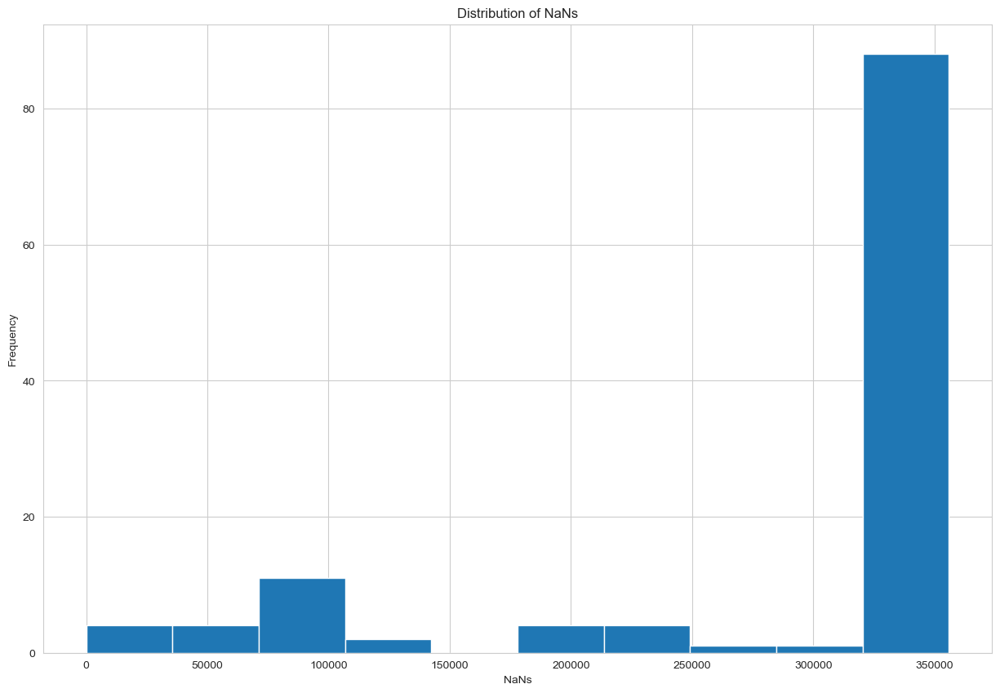

In [15]:
drop_df.isnull().sum().plot(kind='hist', figsize=(15, 10))
plt.title('Distribution of NaNs')
plt.xlabel('NaNs')

plt.show()

The histogram figure indicates the frequency of columns by the number of missing values (NaNs) they contain. More than 80 columns have 350,000 missing data along the column, representing about half of the portion in our dataset. There is a significant column with a large number of missing values.


In [16]:
# Check again using isnull & sum function
drop_df.isnull().sum().sort_values(ascending=False)

water_hardness_100g                      356001
ingredients_that_may_be_from_palm_oil    356001
dihomo_gamma_linolenic_acid_100g         356001
elaidic_acid_100g                        356001
gondoic_acid_100g                        356001
                                          ...  
energy_100g                               60634
brands                                    29024
product_name                              17512
countries_en                                275
created_datetime                              1
Length: 119, dtype: int64

There are 15 empty columns, and 10 columns have less than 10 values. About 91 columns have more than 300,000 missing values.

In [17]:
# Count non-null values in each column
non_null_counts = drop_df.notnull().sum()
# Filter columns based on the condition (at least 20% non-null values)
selected_columns = non_null_counts[non_null_counts >= len(df) * 0.2].index.tolist()
print(f"The number of columns remained after filtering: {len(selected_columns)}")
print("\nColumns will be kept:")
selected_columns

The number of columns remained after filtering: 30

Columns will be kept:


['created_datetime',
 'product_name',
 'brands',
 'countries_en',
 'ingredients_text',
 'serving_size',
 'additives_n',
 'additives_tags',
 'additives_en',
 'ingredients_from_palm_oil_n',
 'ingredients_that_may_be_from_palm_oil_n',
 'nutrition_grade_fr',
 'main_category_en',
 'energy_100g',
 'fat_100g',
 'saturated_fat_100g',
 'trans_fat_100g',
 'cholesterol_100g',
 'carbohydrates_100g',
 'sugars_100g',
 'fiber_100g',
 'proteins_100g',
 'salt_100g',
 'sodium_100g',
 'vitamin_a_100g',
 'vitamin_c_100g',
 'calcium_100g',
 'iron_100g',
 'nutrition_score_fr_100g',
 'nutrition_score_uk_100g']

In [18]:
# Drop columns with less than 20% usable data
filtered_df = drop_df.dropna(axis=1, thresh=len(df) * 0.2)
filtered_df.head()

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,ingredients_from_palm_oil_n,...,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g
code,,,,,,,,,,,,,,,,,,,,,
0000000003087,2016-09-17T09:17:46Z,Farine de blé noir,Ferme t'y R'nao,France,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
0000000004530,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,United States,"Bananas, vegetable oil (coconut oil, corn oil ...",28 g (1 ONZ),0.0,NaN,NaN,0.0,...,3.6,3.57,0.00000,0.000,0.0,0.0214,0.000,0.00129,14.0,14.0
0000000004559,2017-03-09T14:32:37Z,Peanuts,Torn & Glasser,United States,"Peanuts, wheat flour, sugar, rice flour, tapio...",28 g (0.25 cup),0.0,NaN,NaN,0.0,...,7.1,17.86,0.63500,0.250,0.0,0.0000,0.071,0.00129,0.0,0.0
0000000016087,2017-03-09T10:35:31Z,Organic Salted Nut Mix,Grizzlies,United States,"Organic hazelnuts, organic cashews, organic wa...",28 g (0.25 cup),0.0,NaN,NaN,0.0,...,7.1,17.86,1.22428,0.482,NaN,NaN,0.143,0.00514,12.0,12.0
0000000016094,2017-03-09T10:34:13Z,Organic Polenta,Bob's Red Mill,United States,Organic polenta,35 g (0.25 cup),0.0,NaN,NaN,0.0,...,5.7,8.57,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


When setting threshold to filter the dataset, we consider the nature of data. **Nutritional data** can be **inherently sparse**, especially for specific micronutrients or additives that may not be present in large quantities or in all food items. Thus, a lower threshold (20%) may help in retain more columns that could have significant implications for the analysis. The goal is to **avoid losing variables that are significant despite being infrequent**.

### 1.3.2  Missing Data across Row

In this section, the team will access the missing data across the nutrition rows, since they are the main features used for analysis. If there is an empty row in all nutrition columns, we will consider dropping the row.

In [19]:
columns_of_interest = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'trans_fat_100g',
    'cholesterol_100g', 'carbohydrates_100g', 'sugars_100g', 'fiber_100g',
    'proteins_100g', 'salt_100g', 'sodium_100g', 'vitamin_a_100g',
    'vitamin_c_100g', 'calcium_100g', 'iron_100g'
]

# Counting rows where all values in the selected columns are NaN
completely_nan_rows = filtered_df[columns_of_interest].isnull().all(axis=1).sum()

print("Number of rows with NaN values in all nutrition columns:", completely_nan_rows)

Number of rows with NaN values in all nutrition columns: 59140


In [20]:
filtered_df = filtered_df.dropna(subset=columns_of_interest, how='all')
print("Number of rows with NaN values in all nutrition columns:", completely_nan_rows)
print('There are now {:,} rows '.format(filtered_df.shape[0]) + 'and {} columns left in our data'.format(
    filtered_df.shape[1]))

Number of rows with NaN values in all nutrition columns: 59140
There are now 296,861 rows and 30 columns left in our data


### 1.3.3 Missing Data in Nutrition Columns

This section will focus on the missing data across each nutrition column; the team will choose to fill the NAN values with 0 instead of imputing mean/median/mode.

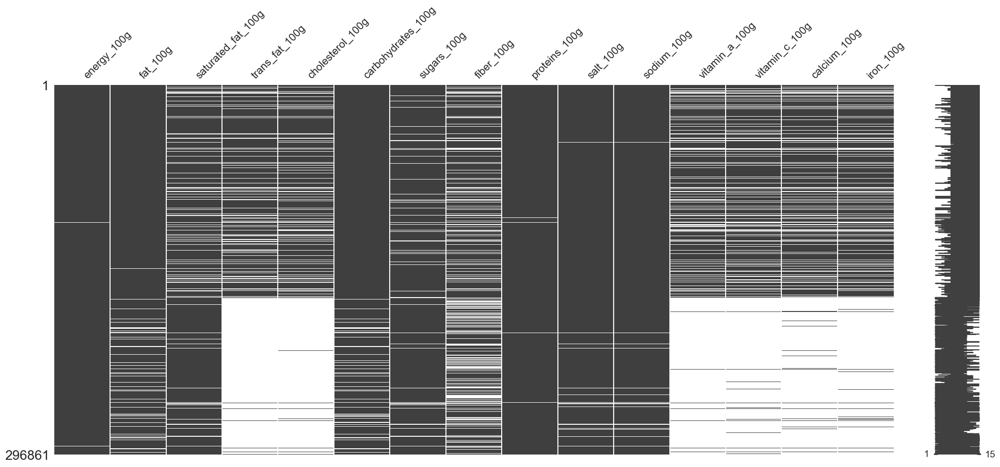

In [21]:
# Check the missing value in the nutrition columns
columns_of_interest = [
    "energy_100g", "fat_100g", "saturated_fat_100g", "trans_fat_100g",
    "cholesterol_100g", "carbohydrates_100g", "sugars_100g", "fiber_100g",
    "proteins_100g", "salt_100g", "sodium_100g", "vitamin_a_100g",
    "vitamin_c_100g", "calcium_100g", "iron_100g"
]

# Filter the DataFrame to include only the columns of interest
filtered_df_interest = filtered_df[columns_of_interest]

# Visualize missing data with a matrix
msno.matrix(filtered_df_interest)
plt.show()

**Missing Data Matrix**

The first image indicates missing matrix and the while lines in represent missing values in the data, while the black lines show non-missing values.

- According to the figure, the columns for ***trans_fat_100g, cholesterol_100g, vitamin_a_100g, vitamin_c_100g, calcium_100g, and iron_100g***  have the most white space, suggesting that these nutrients have the **most missing values**.
- Conversely, ***energy_100g, fat_100g, saturated_fat_100g, carbohydrates_100g, sugars_100g, fiber_100g, proteins_100g, salt_100g, and sodium_100g*** show a greater density of black, implying that data for these **nutrients is more complete**.
- The sparkline on the right side, representing data completeness for each row, shows variability, with some rows being complete (long lines) and others having significant missing data (short lines). This suggests some consistency in missing data within records; **most rows will have more than half of the columns filled**.

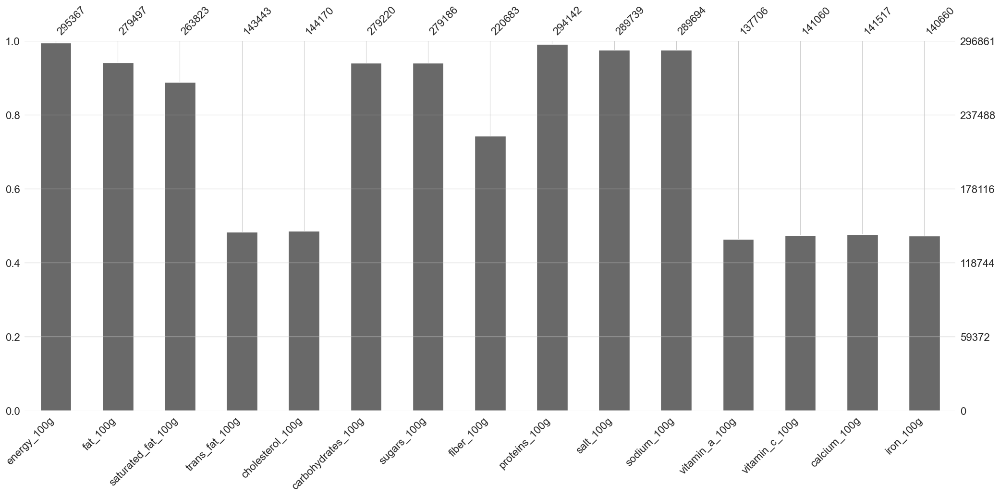

In [22]:
# Visualize missing data with a bar chart
msno.bar(filtered_df_interest)
plt.show()

**Missing Data Bar Chart**

The bar chart provides a quantitative view of the non-missing data across nutritional components.

- ***Energy_100g and proteins_100g*** have the highest counts of non-missing data, close to the full count of the dataset, suggesting they are the most consistently reported nutrients.
- ***Trans_fat_100g, cholesterol_100g, vitamin_a_100g, and vitamin_c_100g*** have the lowest counts of non-missing data, indicating they are often unreported or missing from the dataset entries.
- Other nutrients like ***fat_100g, saturated_fat_100g, carbohydrates_100g, sugars_100g, fiber_100g, salt_100g, sodium_100g, calcium_100g, and iron_100g*** have varying levels of completeness, with none as complete as energy_100g or proteins_100g, but also not as incomplete as the ones with the most missing data.

In [23]:
# fill the missing value in nutrition columns
filtered_df[columns_of_interest] = filtered_df[columns_of_interest].fillna(0.0)

# Check again the NAN value in column
print("Number of rows with NaN values now in all nutrition columns:",
      filtered_df[columns_of_interest].isnull().all(axis=1).sum())

Number of rows with NaN values now in all nutrition columns: 0


**Justification**

We decided to fill missing values with zero for these nutritional data columns as if a nutrient was tested but not listed; it might indicate non-detection. Thus, filling zero is more accurate in this case than imputing a mean or median, which might falsely suggest a higher nutritional content than actually exists.

### 1.3.4 Missing Data in Additives Number ('additives_n')

Similar to filling missing values in nutrition columns, null values in additives_n will be considered non-detectable. Thus, we directly fill 0 in the columns.

In [24]:
print("There is {:,} null value in additives_n column".format(filtered_df.additives_n.isnull().sum()))

There is 27,206 null value in additives_n column


In [25]:
filtered_df['additives_n'] = filtered_df['additives_n'].fillna(0.0)
print("Number of rows with NaN values now in additives_n column:", filtered_df.additives_n.isnull().sum())

Number of rows with NaN values now in additives_n column: 0


### 1.3.5 Missing Data in Number of Ingredients that are from Palm Oil or maybe from Palm Oil ('ingredients_from_palm_oil_n' & 'ingredients_that_may_be_from_palm_oil_n')

Also, we will assume the NAN values in ingredients_from_palm_oil_n and ingredients_that_may_be_from_palm_oil_n are non-detection; thus, we will fill them with 0.

In [26]:
print("Number of null values in 'ingredients_from_palm_oil_n' column: {:,}".format(
    filtered_df.ingredients_from_palm_oil_n.isnull().sum()))
print("Number of null values in 'ingredients_that_may_be_from_palm_oil_n' column: {:,}".format(
    filtered_df.ingredients_that_may_be_from_palm_oil_n.isnull().sum()))

Number of null values in 'ingredients_from_palm_oil_n' column: 27,206
Number of null values in 'ingredients_that_may_be_from_palm_oil_n' column: 27,206


In [27]:
# Fill missing values with zeros
filtered_df['ingredients_from_palm_oil_n'].fillna(0, inplace=True)
filtered_df['ingredients_that_may_be_from_palm_oil_n'].fillna(0, inplace=True)

# Check again for any remaining missing values
print("Number of null values in 'ingredients_from_palm_oil_n' column: {:,}".format(
    filtered_df.ingredients_from_palm_oil_n.isnull().sum()))
print("Number of null values in 'ingredients_that_may_be_from_palm_oil_n' column: {:,}".format(
    filtered_df.ingredients_that_may_be_from_palm_oil_n.isnull().sum()))


Number of null values in 'ingredients_from_palm_oil_n' column: 0
Number of null values in 'ingredients_that_may_be_from_palm_oil_n' column: 0


### 1.3.6 Removing Uninformative "Palm Oil" Columns

This section explores the exclusion of two data columns, "ingredients_from_palm_oil_n" and "ingredients_that_may_be_from_palm_oil_n". We will analyze the prevalence of zeros (indicating no palm oil content) in these columns to determine their usefulness for clustering products based on nutritional profiles. If the data suggests these columns offer minimal variation, they may be excluded to streamline the analysis and potentially improve the effectiveness of clustering algorithms.

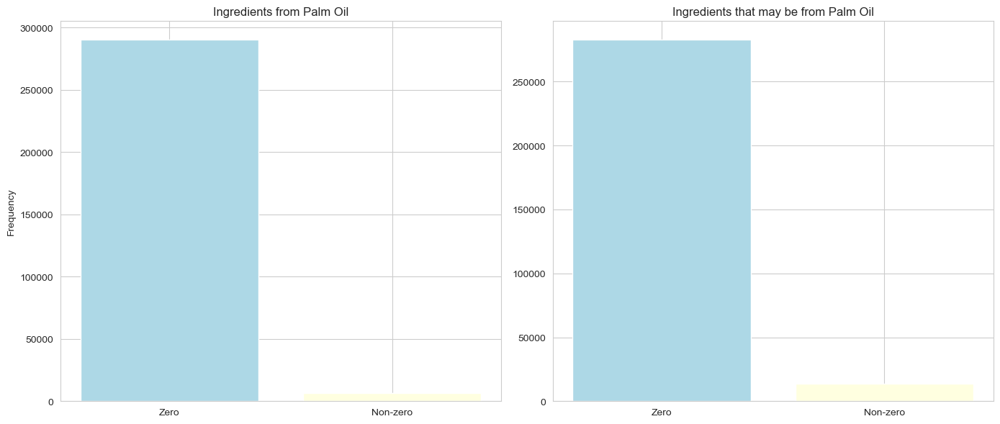

In [28]:
import matplotlib.pyplot as plt

# Create a figure with two subplots
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# Count the number of zero and non-zero values for each column
palm_oil_zeros = (filtered_df['ingredients_from_palm_oil_n'] == 0).sum()
palm_oil_nonzeros = (filtered_df['ingredients_from_palm_oil_n'] != 0).sum()

may_be_palm_oil_zeros = (filtered_df['ingredients_that_may_be_from_palm_oil_n'] == 0).sum()
may_be_palm_oil_nonzeros = (filtered_df['ingredients_that_may_be_from_palm_oil_n'] != 0).sum()

# Data for plotting
categories = ['Zero', 'Non-zero']
values_palm_oil = [palm_oil_zeros, palm_oil_nonzeros]
values_may_be_palm_oil = [may_be_palm_oil_zeros, may_be_palm_oil_nonzeros]

# Plot the first bar chart
ax[0].bar(categories, values_palm_oil, color=['lightblue', 'lightyellow'])
ax[0].set_title('Ingredients from Palm Oil')
ax[0].set_ylabel('Frequency')

# Plot the second bar chart
ax[1].bar(categories, values_may_be_palm_oil, color=['lightblue', 'lightyellow'])
ax[1].set_title('Ingredients that may be from Palm Oil')

# Show the plot
plt.tight_layout()
plt.show()


Upon examination of the 'Ingredients from Palm Oil' and 'Ingredients that may be from Palm Oil' columns, it was observed that the data is overwhelmingly composed of zeros, indicating an absence of these ingredients in most products. Since the clustering aimed to find groups of similar foods based on their nutrients, these "palm oil" columns weren't helpful, as almost everything had a zero, this information wouldn't help tell different foods apart. Consequently, they have been deemed as non-contributory for the clustering analysis. As a result, to streamline our dataset, these columns have been dropped from further analysis.

In [29]:
# Drop the palm oil columns
filtered_df.drop(columns=['ingredients_from_palm_oil_n', 'ingredients_that_may_be_from_palm_oil_n'], inplace=True)

# Check the dataframe
filtered_df.head()

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g
code,,,,,,,,,,,,,,,,,,,,,
0000000004530,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,United States,"Bananas, vegetable oil (coconut oil, corn oil ...",28 g (1 ONZ),0.0,NaN,NaN,d,...,3.6,3.57,0.00000,0.000,0.0,0.0214,0.000,0.00129,14.0,14.0
0000000004559,2017-03-09T14:32:37Z,Peanuts,Torn & Glasser,United States,"Peanuts, wheat flour, sugar, rice flour, tapio...",28 g (0.25 cup),0.0,NaN,NaN,b,...,7.1,17.86,0.63500,0.250,0.0,0.0000,0.071,0.00129,0.0,0.0
0000000016087,2017-03-09T10:35:31Z,Organic Salted Nut Mix,Grizzlies,United States,"Organic hazelnuts, organic cashews, organic wa...",28 g (0.25 cup),0.0,NaN,NaN,d,...,7.1,17.86,1.22428,0.482,0.0,0.0000,0.143,0.00514,12.0,12.0
0000000016094,2017-03-09T10:34:13Z,Organic Polenta,Bob's Red Mill,United States,Organic polenta,35 g (0.25 cup),0.0,NaN,NaN,NaN,...,5.7,8.57,0.00000,0.000,0.0,0.0000,0.000,0.00000,NaN,NaN
0000000016100,2017-03-09T10:34:11Z,Breadshop Honey Gone Nuts Granola,Unfi,United States,"Rolled oats, grape concentrate, expeller press...",52 g (0.5 cup),0.0,NaN,NaN,NaN,...,7.7,13.46,0.00000,0.000,0.0,0.0000,0.038,0.00346,NaN,NaN


-- --
### 1.4 Data validation and Outliers Detection

In machine learning, invalid data is data that is incomplete, incorrect, outdated, or irrelevant. If not addressed properly, invalid data can significantly impact the performance of a machine learning algorithm and lead to inaccurate predictions. For example, incomplete data can lead to biased statistical analysis and inaccurate parameter estimation.

### 1.4.1 Removing Extreme and Negative Nutrition Values

In this section, extreme high values and negative nutrition values are identified and removed from the dataset to ensure data integrity and reliability for subsequent analysis.

In [30]:
filtered_df.describe()

,additives_n,energy_100g,fat_100g,saturated_fat_100g,trans_fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g
count,296861.000000,296861.000000,2.968610e+05,296861.000000,296861.000000,296861.000000,2.968610e+05,296861.000000,2.968610e+05,2.968610e+05,296861.000000,296861.000000,296861.000000,296861.000000,296861.000000,296861.000000,254657.000000,254657.000000
mean,1.752696,1119.789298,5.278647e+04,4.525715,0.035509,0.009745,5.280406e+04,14.740238,2.857189e+05,5.278152e+04,1.894707,0.745946,0.000184,0.011116,0.060678,0.001796,9.173496,8.987831
std,2.460971,937.853137,2.875412e+07,7.677746,1.070716,0.249660,2.875412e+07,21.639346,1.556726e+08,2.875412e+07,119.091550,46.886436,0.049882,1.540638,2.313325,0.149084,8.999459,9.151689
min,0.000000,0.000000,0.000000e+00,0.000000,-3.570000,0.000000,0.000000e+00,-17.860000,-6.700000e+00,-8.000000e+02,0.000000,0.000000,-0.000340,-0.002100,0.000000,-0.000260,-15.000000,-15.000000
25%,0.000000,372.000000,0.000000e+00,0.000000,0.000000,0.000000,3.800000e+00,0.700000,0.000000e+00,7.000000e-01,0.043180,0.017000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000
50%,1.000000,1083.000000,4.000000e+00,1.020000,0.000000,0.000000,1.690000e+01,4.580000,0.000000e+00,4.760000e+00,0.510540,0.201000,0.000000,0.000000,0.000000,0.000000,10.000000,9.000000
75%,3.000000,1674.000000,1.900000e+01,6.360000,0.000000,0.000000,5.600000e+01,21.430000,2.900000e+00,1.000000e+01,1.315720,0.518000,0.000000,0.000000,0.032000,0.000890,16.000000,16.000000
max,30.000000,231199.000000,1.566667e+10,550.000000,369.000000,95.238000,1.566667e+10,3520.000000,8.481815e+10,1.566667e+10,64312.800000,25320.000000,26.700000,716.981100,694.737000,50.000000,40.000000,40.000000


From summary statistics, we can observe an obvious error as the minimum and maximum values for nutrients column that fall outside the logical range of 0 g to 100 g. Nutritional values, such as **fat_100g, carbohydrates_100g, fiber_100g, proteins_100g, and salt_100g**, show maximum values that are unusually **high and unrealistic** for standard food products. Columns like **sugars_100g and fiber_100g** have **negative minimum** values, which are not possible for these measures and indicate data errors. Also, fat_100g, carbohydrates_100g, proteins_100g, and fiber_100g have very **high standard deviations** relative to their means, suggesting significant outliers or data entry errors.

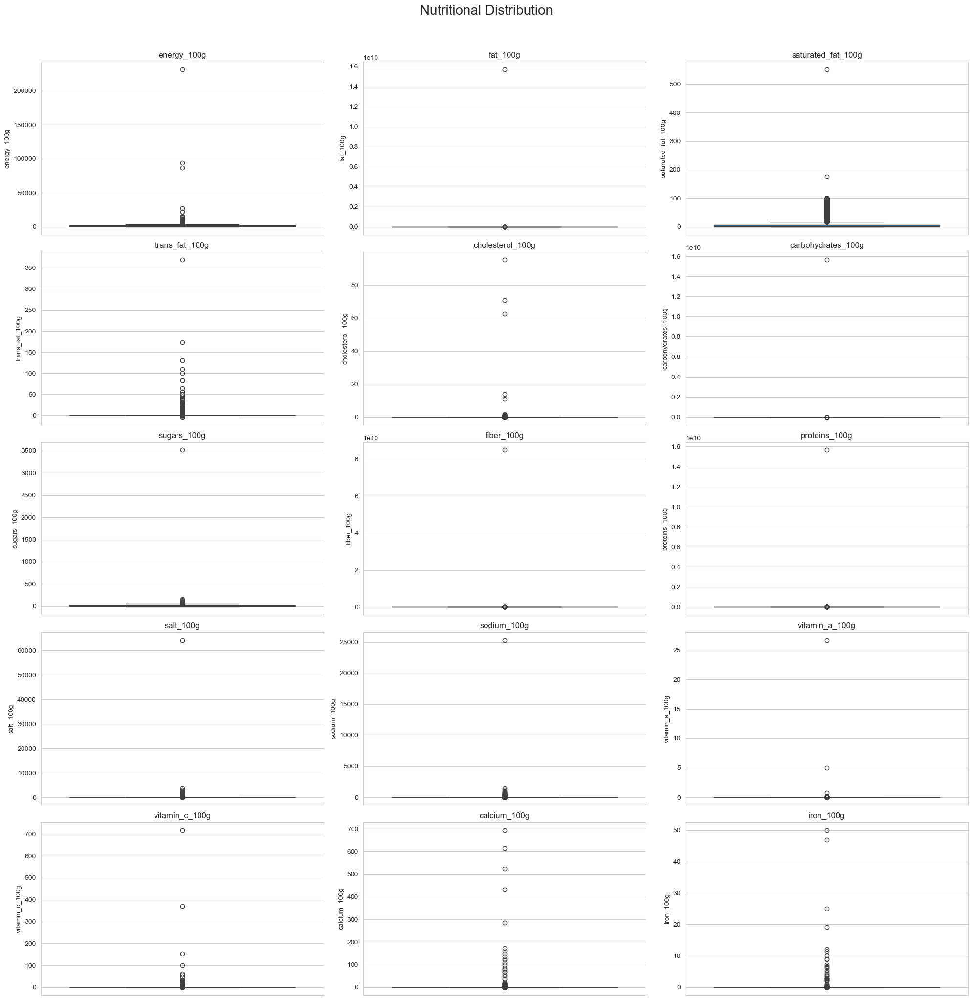

In [31]:
nutritional_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'trans_fat_100g',
    'cholesterol_100g', 'carbohydrates_100g', 'sugars_100g', 'fiber_100g',
    'proteins_100g', 'salt_100g', 'sodium_100g', 'vitamin_a_100g',
    'vitamin_c_100g', 'calcium_100g', 'iron_100g'
]

plt.figure(figsize=(20, 20))
rows = 5
columns = 3  # 5*3 = 15

for i, col in enumerate(nutritional_columns, 1):
    plt.subplot(rows, columns, i)  # Adjust the grid size to accommodate all plots
    sns.boxplot(filtered_df[col].dropna())  # Ensure to drop NA values for plotting
    plt.title(col)

plt.suptitle('Nutritional Distribution', fontsize=20, y=1.02)
plt.tight_layout()
plt.show()

As mentioned in the last part, each nutrition data point shows an extensive range of values, with extreme outliers far beyond the upper whisker. The presence of outliers suggests that possible errors in the data rather than natural variation. Thus, we will cap all individual nutrient values at a maximum of 100g and a minimum of 0 g. For energy specifically, the maximum limit will be set at 3766 kilojoules (kJ) with a minimum of 0 kJ. (Since fat has 9 kilocalories (kcal) per gram, 100 grams would be equivalent to 900 kcal or 3765.6 kJ).

In [32]:
# Remove rows where any nutrient exceeds 100g per 100g or is negative
invalid_nutrients_mask = (filtered_df[[col for col in nutritional_columns if col != 'energy_100g']].apply(lambda x: (x > 100) | (x < 0)).any(axis=1))
filtered_df = filtered_df[~invalid_nutrients_mask]

# Remove rows where energy exceeds 3766 kj or is negative
invalid_energy_mask = (filtered_df['energy_100g'] > 3766) | (filtered_df['energy_100g'] < 0)
filtered_df = filtered_df[~invalid_energy_mask]

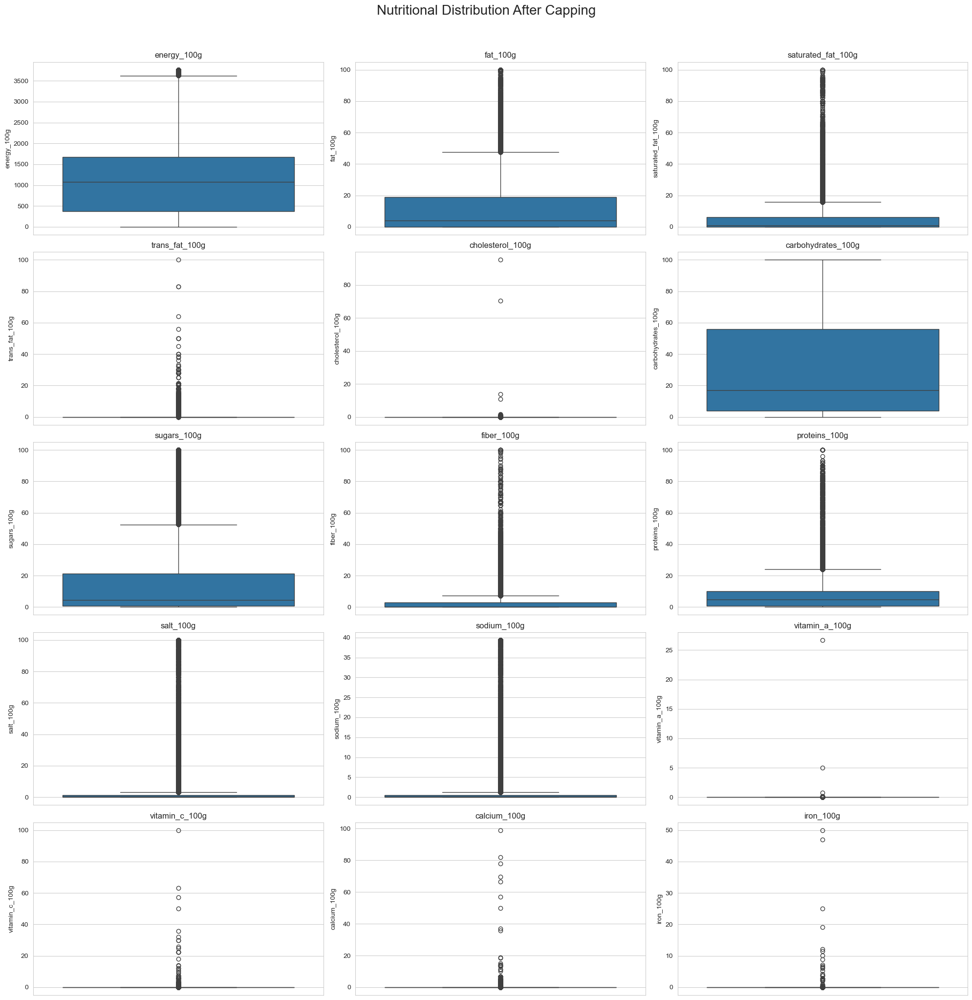

In [33]:
plt.figure(figsize=(20, 20))
rows = 5
columns = 3  # 5*3 = 15

for i, col in enumerate(nutritional_columns, 1):
    plt.subplot(rows, columns, i)  # Adjust the grid size to accommodate all plots
    sns.boxplot(filtered_df[col].dropna())  # Ensure to drop NA values for plotting
    plt.title(col)

plt.suptitle('Nutritional Distribution After Capping', fontsize=20, y=1.02)
plt.tight_layout()
plt.show()

The clipping shows no outliers beyond the 100g mark, indicating that extreme values have been effectively removed. For most nutrients, the boxes (representing the interquartile range) are relatively narrow, suggesting that most data falls within a smaller range of values. This is typical for many nutrients where the majority of food items don't have very high content. However, outliers are still present within the 0-100g range. These could be real, especially for nutrients like fat and sugars where some food products, like olive oil and candy, can have high content. The further investigation will be performed later.

### 1.4.2 Removing Components Values Greater Than 100g

In this section, we conduct a sum check of macronutrients (fat, carbohydrates, and proteins) and micronutrients (such as fiber, sodium, vitamins, and minerals) to ensure they do not collectively exceed 100g per 100g serving. The total weight of all components in a 100g serving should ideally add up to 100g. Any sum exceeding 100g indicates potential errors in data reporting or measurement, such as mislabeling or miscalculation.

In [34]:
# Define the columns to check for the sum of nutrients
# Exclude micronutrients that included in otehr components such as 'saturated_fat_100g', 'trans_fat_100g', 'cholesterol_100g', 'suagrs_100g', 'sodium_100g'
components_columns = ['fat_100g', 'carbohydrates_100g', 'proteins_100g', 'fiber_100g', 'salt_100g', 'vitamin_a_100g', 'vitamin_c_100g', 'calcium_100g', 'iron_100g']

# Calculate the sum of nutrients and add it as a new column
filtered_df['total_components'] = filtered_df[components_columns].sum(axis=1)

# Check for rows where the sum of nutrients exceeds 100g per 100g
rows_with_excess_nutrients = filtered_df[filtered_df['total_components'] > 100]

# Display the number of rows with excess nutrients and some examples
num_rows_excess = rows_with_excess_nutrients.shape[0]
rows_with_excess_nutrients_examples = rows_with_excess_nutrients.head()

print(f"There are {num_rows_excess} rows where components are equal to or exceed 100g")
rows_with_excess_nutrients_examples

There are 22641 rows where components are equal to or exceed 100g


,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components
code,,,,,,,,,,,,,,,,,,,,,
0000000004530,2017-03-09T14:32:37Z,Banana Chips Sweetened (Whole),NaN,United States,"Bananas, vegetable oil (coconut oil, corn oil ...",28 g (1 ONZ),0.0,NaN,NaN,d,...,3.57,0.00000,0.000,0.0,0.0214,0.000,0.00129,14.0,14.0,100.05269
0000000004559,2017-03-09T14:32:37Z,Peanuts,Torn & Glasser,United States,"Peanuts, wheat flour, sugar, rice flour, tapio...",28 g (0.25 cup),0.0,NaN,NaN,b,...,17.86,0.63500,0.250,0.0,0.0000,0.071,0.00129,0.0,0.0,104.23729
0000000016087,2017-03-09T10:35:31Z,Organic Salted Nut Mix,Grizzlies,United States,"Organic hazelnuts, organic cashews, organic wa...",28 g (0.25 cup),0.0,NaN,NaN,d,...,17.86,1.22428,0.482,0.0,0.0000,0.143,0.00514,12.0,12.0,101.33242
0000000016100,2017-03-09T10:34:11Z,Breadshop Honey Gone Nuts Granola,Unfi,United States,"Rolled oats, grape concentrate, expeller press...",52 g (0.5 cup),0.0,NaN,NaN,NaN,...,13.46,0.00000,0.000,0.0,0.0000,0.038,0.00346,NaN,NaN,102.93146
0000000016124,2017-03-09T10:35:11Z,Organic Muesli,Daddy's Muesli,United States,"Org oats, org hemp granola (org oats, evaporat...",64 g (0.5 cup),1.0,en:e307c,E307c - Tocopherol,c,...,14.06,0.13970,0.055,0.0,0.0000,0.062,0.00422,7.0,7.0,100.22592


In the example we see several rows with macronutrient values that slightly exceed 100g. This may be due to rounding errors in the data. Rounding can indeed cause the sum of macronutrients to be slightly higher than 100 when each nutrient is rounded up individually. Thus, we will set a threshold of 105g to account for these potential rounding errors.

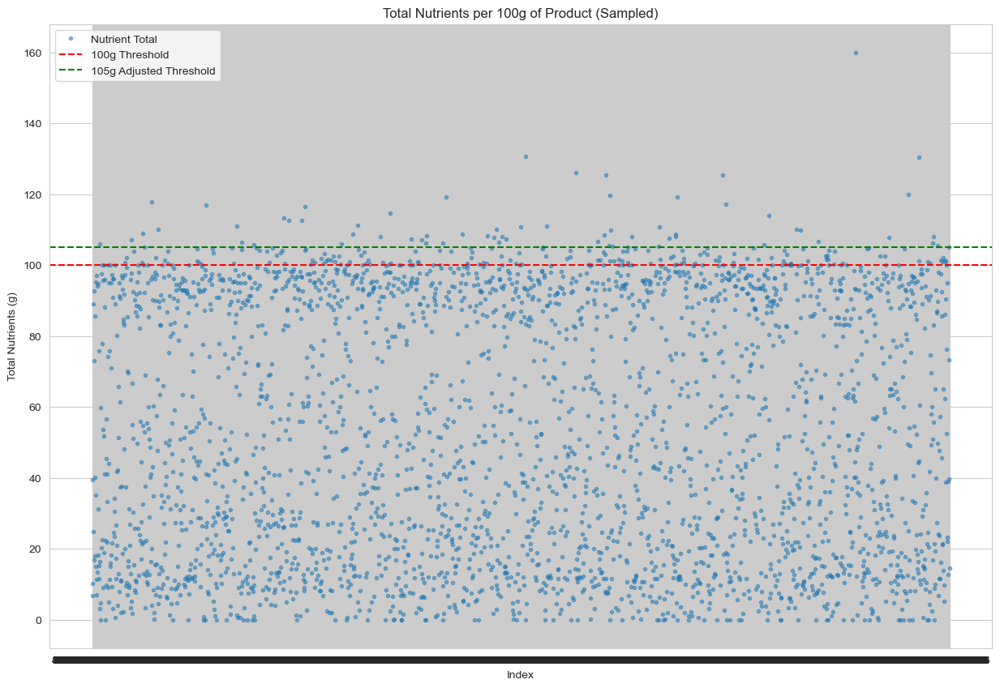

In [35]:
sample_size = int(0.01 * filtered_df.shape[0])
sampled_df = filtered_df.sample(n=sample_size, random_state=1)

# Create the scatter plot using a faster plotting method
plt.figure(figsize=(15, 10))
plt.plot(sampled_df.index, sampled_df['total_components'], 'o', markersize=3, alpha=0.5, label='Nutrient Total')
plt.axhline(y=100, color='r', linestyle='--', label='100g Threshold')
plt.axhline(y=105, color='g', linestyle='--', label='105g Adjusted Threshold')
plt.title('Total Nutrients per 100g of Product (Sampled)')
plt.xlabel('Index')
plt.ylabel('Total Nutrients (g)')
plt.legend()
plt.grid(True)
plt.show()

This scatter plot shows the distribution of total macronutrients (fat, carbs, protein) per 100 grams of product in our dataset. Each data point represents a product.

- Red line (100g): Maximum expected combined macronutrient content (physical limitation).
- Green line (105g): Adjusted threshold for potential rounding errors.

Most points cluster below 100g, indicating typical values. A few exceed 100g but fall below 105g, suggesting possible rounding errors. Outliers above 105g warrant investigation.

**Cleaning Step:**

- **Outliers (> 105g):** Removed due to potential data errors that could distort analysis.
- **Rounding Adjustments (100g - 105g):** Proportionally adjusted down to 100g to maintain macronutrient ratios. This addresses rounding without significant data modification.

In [36]:
# Define the threshold
threshold = 105

# Identify rows where the total macronutrients exceed the threshold
excessive_rows = filtered_df[filtered_df['total_components'] > threshold]

# Drop these rows from the dataset
filtered_df = filtered_df.drop(excessive_rows.index)

# For the remaining rows with a sum between 100 and the threshold, adjust values proportionally
near_threshold_rows = filtered_df[(filtered_df['total_components'] > 100) & (filtered_df['total_components'] <= threshold)]

# Calculate the adjustment factor for these rows
adjustment_factor = 100 / near_threshold_rows['total_components']

# Apply the adjustment
for col in components_columns:
    filtered_df.loc[near_threshold_rows.index, col] *= adjustment_factor

# Recalculate the total after adjustment
filtered_df['total_components'] = filtered_df[components_columns].sum(axis=1)

For the rows that are slightly above 100g but below the threshold, it will scale down the macronutrients to make their sum exactly 100g. This proportional adjustment assumes that the rounding errors are evenly distributed across the macronutrients.

In [37]:
print(f"There are {filtered_df[filtered_df['total_components']> 100.01].shape[0]} rows where total nutrients exceed 100g.")

There are 0 rows where total nutrients exceed 100g.


### 1.4.3 Addressing Nutrient Discrepancies

In this section, we scrutinize the relationship between various macronutrients and micronutrients to identify discrepancies. We conduct checks to ensure that subsets of nutrients do not exceed their overarching nutritional category totals. Specifically, we examine the following:

- The combined total of **saturated fats, trans fats,** and **cholesterol** should not exceed the total **fat** content.
- The amount of **sugars** should not exceed the total **carbohydrates**.
- The weight of **sodium** should be less than the weight of **salt**, taking into account the conversion factor from sodium to salt (Na to NaCl).

In [38]:
# Check if the sum of saturated fat, trans fat, and cholesterol exceeds total fat
fat_issues = filtered_df[
    (filtered_df['saturated_fat_100g'] + filtered_df['trans_fat_100g'] + filtered_df['cholesterol_100g'])  > filtered_df['fat_100g']
    ]

# Check if sugars exceed total carbohydrates
carb_issues = filtered_df[
    (filtered_df['sugars_100g']) > filtered_df['carbohydrates_100g']
    ]

# Check if sodium exceeds salt
# Sodium is roughly 40% of the weight of salt. So, to get the salt equivalent: sodium * 2.5
salt_issues = filtered_df[
    filtered_df['sodium_100g'] * 2.5 > filtered_df['salt_100g']
    ]

print(f"Number of rows where micronutrients exceed macronutrients: {fat_issues.shape[0]}")
print(f"Number of rows where sugars exceed carbohydrates: {carb_issues.shape[0]}")
print(f"Number of rows where sodium exceeds salt: {salt_issues.shape[0]}")

Number of rows where micronutrients exceed macronutrients: 16902
Number of rows where sugars exceed carbohydrates: 16088
Number of rows where sodium exceeds salt: 6150


In our analysis, we observed significant discrepancies in the dataset. In 16902 rows, micronutrients such as saturated fat, trans fat, and cholesterol exceeded the total fat content. Additionally, sugars surpassed total carbohydrates in 16088 rows. Notably, sodium content exceeded its salt equivalent in 6150 rows. These discrepancies highlight potential data inaccuracies and should be removed before further analysis.

In [39]:
# Remove rows where combined micronutrients exceed macronutrients
filtered_df = filtered_df[
    ~((filtered_df['saturated_fat_100g'] + filtered_df['trans_fat_100g'] + filtered_df['cholesterol_100g']) > filtered_df['fat_100g'])
]

# Remove rows where sugars exceed total carbohydrates
filtered_df = filtered_df[
    ~((filtered_df['sugars_100g']) > filtered_df['carbohydrates_100g'])
]

# Remove rows where the sodium exceeds salt content, considering the conversion from sodium to salt
filtered_df = filtered_df[
    ~(filtered_df['sodium_100g'] * 2.5 > filtered_df['salt_100g'])
]

### 1.4.3 Outliers Detection and Elimination

Outliers are data points that differ significantly from the majority of the data. Some outliers represent natural variations in the population and should be left as is. Other outliers should be removed because they represent: measurement errors, data entry or processing errors, and poor sampling.

In [40]:
filtered_df.describe()

,additives_n,energy_100g,fat_100g,saturated_fat_100g,trans_fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components
count,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,263135.000000,222403.000000,222403.000000,263135.000000
mean,1.885956,1071.578615,11.992555,4.302776,0.025504,0.009556,30.265526,14.571373,1.698012,6.698290,1.492198,0.587565,0.000096,0.006881,0.046315,0.001178,9.063862,8.868927,52.201050
std,2.519638,777.976162,16.900944,7.247930,0.409095,0.035818,28.777741,20.602519,3.110857,7.959077,6.082820,2.394869,0.009893,0.308490,0.214003,0.097432,8.998916,9.158997,33.793349
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,-15.000000,-15.000000,0.000000
25%,0.000000,356.000000,0.000000,0.000000,0.000000,0.000000,5.000000,0.600000,0.000000,0.500000,0.038100,0.015000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,20.460000
50%,1.000000,1041.000000,4.600000,0.900000,0.000000,0.000000,17.840000,4.420000,0.000000,4.290000,0.508000,0.200000,0.000000,0.000000,0.000000,0.000000,9.000000,9.000000,48.470000
75%,3.000000,1628.000000,18.750000,6.000000,0.000000,0.000000,56.000000,21.050000,2.500000,9.600000,1.300000,0.512000,0.000000,0.000000,0.028000,0.000780,16.000000,16.000000,88.413700
max,30.000000,3766.000000,100.000000,100.000000,30.000000,10.900000,100.000000,100.000000,100.000000,100.000000,100.000000,39.370079,5.000000,100.000000,69.500000,47.058820,40.000000,37.000000,100.000000


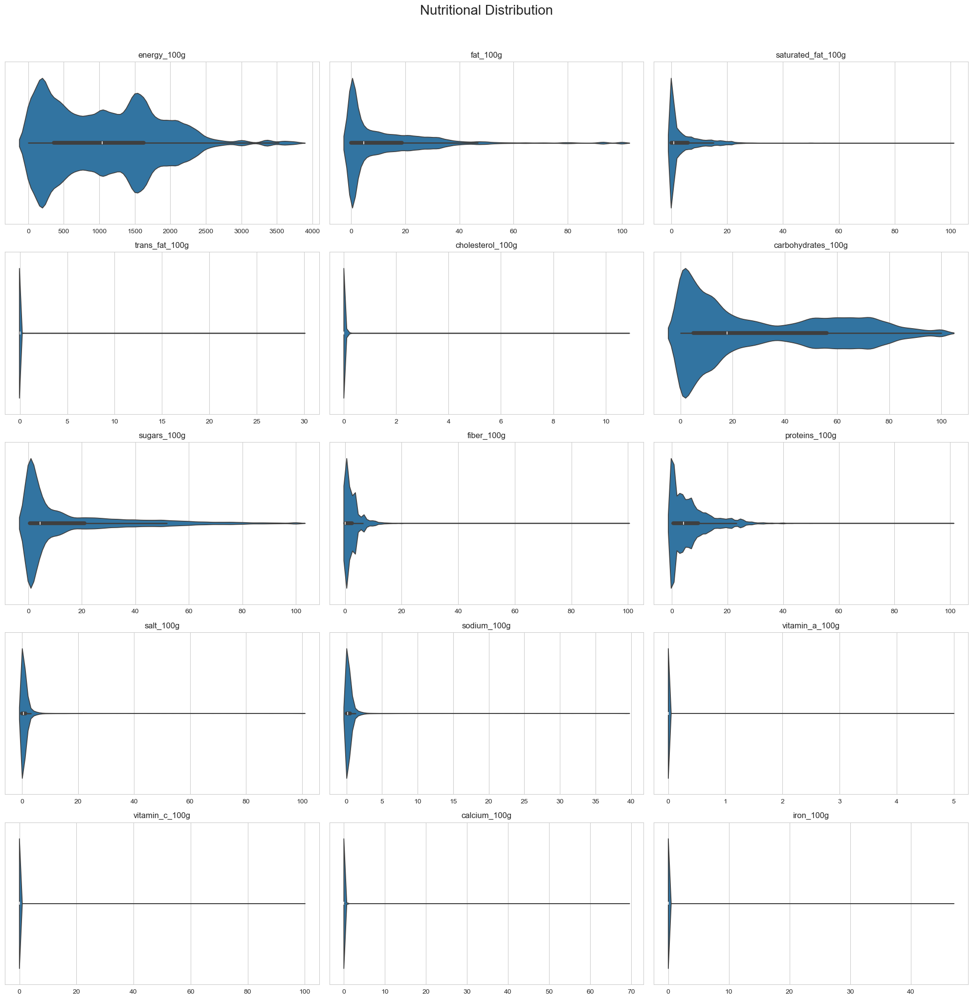

In [41]:
plt.figure(figsize=(20, 20))
rows = 5
columns = 3

for i, col in enumerate(nutritional_columns, 1):
    plt.subplot(rows, columns, i)
    sns.violinplot(x=filtered_df[col].dropna())
    plt.title(col)
    plt.xlabel('')

plt.suptitle('Nutritional Distribution', fontsize=20, y=1.02)
plt.tight_layout()
plt.show()

From the combination of summary statistcs and violin plots:

**Energy (kJ)**
- Broad distribution with multiple peaks indicating varying energy content.
- Maximum value of 3766 kJ, realistic for energy-dense foods.

**Fat, Saturated Fat, Trans Fat, Cholesterol**
- High range of values for fat and saturated fat, but presence of values up to 100g suggests possible errors.
- Long tails for trans fat and cholesterol, especially concerning for trans fat where values should be low.

**Carbohydrates, Sugars, Fiber**
- Considerable spread in distribution for carbohydrates and sugars.
- Peak at lower end may indicate non-sugary foods, while long tail includes sugary foods.
- Fiber distribution peaks at zero with long tail towards higher values, but 100g value is likely an error.

**Proteins**
- Reasonable distribution with tail towards higher protein contents.
- Maximum value of 100g unrealistic for common foods, possible for pure protein powders.

**Salt and Sodium**
- Long tail suggests moderate salt content in most foods, but some very salty items present.
- Physiologically impossible maximum salt value of 100g.

**Vitamins and Minerals (Vitamin A, Vitamin C, Calcium, Iron)**
- Most values cluster near zero, with tails suggesting fortified foods or supplements.
- Maximum values likely errors, especially 100g for vitamin C.

In [42]:
# Access the columns manually
filtered_df[filtered_df['vitamin_c_100g'] == 100]

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components
code,,,,,,,,,,,,,,,,,,,,,
3160921610300,2014-06-05T14:26:55Z,Juvamine Vitamine C500 à croquer sans sucres,Juvamine,France,"Agent de charge : Sorbitol, Vitamine C, Anti-a...",125 mg ou 1/4 de comprimé,4.0,"en:e300,en:e420,en:e420i,en:e572,en:e954","E300 - Ascorbic acid,E420 - Sorbitol,E420i - S...",NaN,...,0.0,0.0,0.0,0.0,100.0,0.0,0.0,NaN,NaN,100.0


In [43]:
filtered_df[filtered_df['fiber_100g'] == 100]

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components
code,,,,,,,,,,,,,,,,,,,,,
3560070761180,2017-06-27T11:00:20Z,Moulin 4 baies,Carrefour,France,Mourin mélange de poivres et épice. Poivre bla...,NaN,0.0,NaN,NaN,a,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-5.0,-5.0,100.0
3590670000174,2017-04-17T15:10:20Z,Noix sèches,Pepinoix,France,Noix sèches,NaN,0.0,NaN,NaN,a,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,-5.0,-5.0,100.0


In [44]:
filtered_df[filtered_df['vitamin_a_100g'] == 5]

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components
code,,,,,,,,,,,,,,,,,,,,,
9504000004064,2014-07-12T09:07:30Z,Cocktail Mangue Ananas Fruit de la passion,DAFANI,Burkina Faso,"Eau, pulpe de mangue, concentré d'ananas et de...",NaN,1.0,en:e330,E330 - Citric acid,NaN,...,0.14,0.0,0.0,5.0,0.0098,0.0,0.0,NaN,NaN,18.6498


In [45]:
filtered_df[filtered_df['iron_100g'] > 47]

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components
code,,,,,,,,,,,,,,,,,,,,,
0075810023358,2017-03-09T12:30:15Z,Gluten Free Soy Sauce,San-J International Inc.,United States,"Water, soybeans, salt, alcohol (to preserve fr...",17 g (1 Tbsp),1.0,en:e1510,E1510 - Ethanon,NaN,...,11.76,10.60704,4.176,0.0,0.0,0.0,47.05882,NaN,NaN,75.30586


In [46]:
filtered_df[filtered_df['calcium_100g'] > 69]

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components
code,,,,,,,,,,,,,,,,,,,,,
3428274140029,2015-10-15T19:28:44Z,Milk'nGO,Lactel,France,"_Lait_ demi-écrémé (55%), préparation fruits e...",NaN,4.0,"en:e160a,en:e160ai,en:e300,en:e330,en:e440,en:...","E160a - Alpha-carotene,E160ai - Beta-carotene,...",e,...,2.1,0.1,0.03937,0.0,0.0,69.5,0.0,18.0,1.0,85.2


By checking the product, we can identify these values as invalid entry records for essential nutrition. For instance, if a product claims to contain 69 grams of calcium in 100 grams of milk, this value far exceeds any realistic concentration. Similarly, if vitamin C, fiber, or iron values are exceptionally high, it suggests a data entry error or misleading information. Therefore, to ensure the integrity of our data, we will remove these entries directly.

In [47]:
filtered_df = filtered_df[~((filtered_df['vitamin_c_100g'] == 100) | (filtered_df['fiber_100g'] == 100) | (filtered_df['iron_100g'] > 47) | (filtered_df['vitamin_a_100g'] == 5)| (filtered_df['calcium_100g'] > 47) | (filtered_df['calcium_100g'] > 69))]

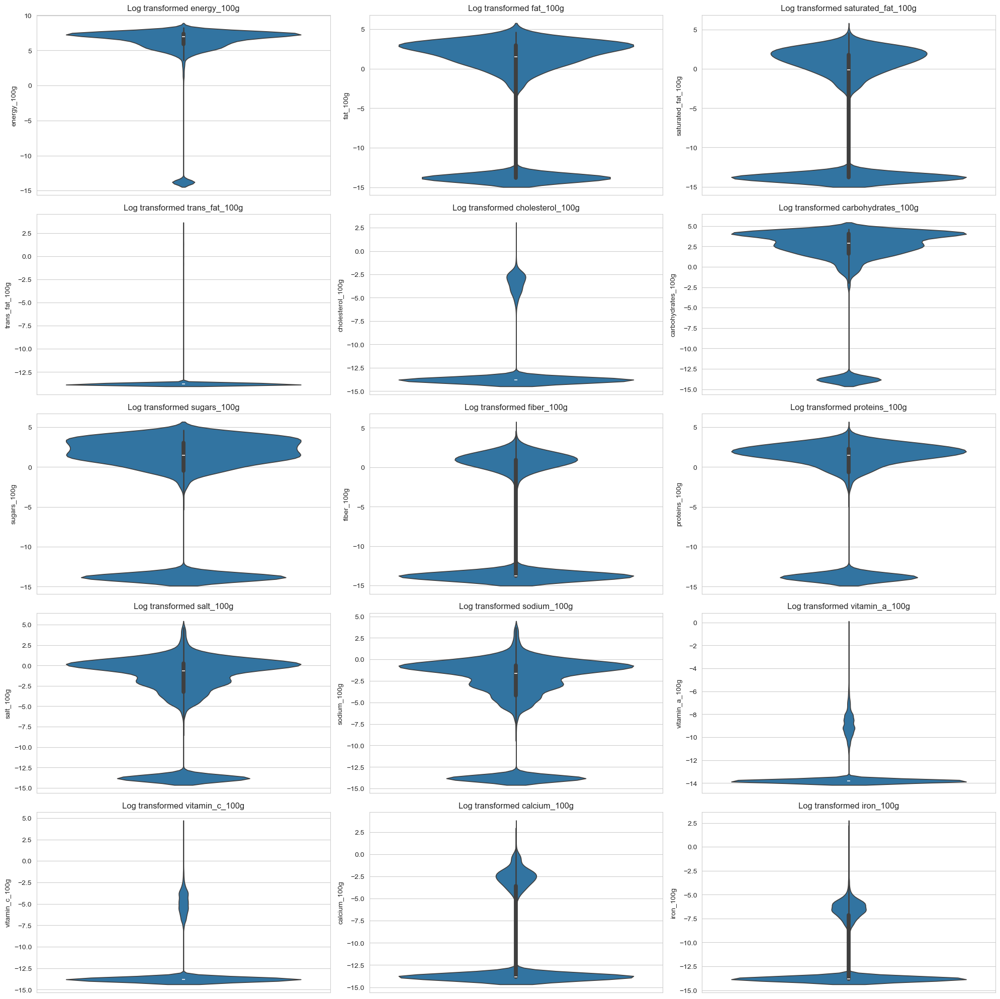

In [48]:
# Define a small constant to add before log transformation to avoid taking log of zero
small_constant = 1e-6

plt.figure(figsize=(20, 20))

for i, col in enumerate(nutritional_columns, 1):
    # Apply log transformation with a small constant to handle zeros
    log_data = np.log(filtered_df[col] + small_constant)

    plt.subplot(5, 3, i)
    sns.violinplot(log_data)
    plt.title(f'Log transformed {col}')

plt.tight_layout()
plt.show()

Due to the skewed nature of the data, a log transformation was implemented to mitigate skewness. Although log transformation is known to de-emphasize outliers and potentially yield a more symmetric distribution, it did not adequately reduce skewness for most nutritional components, except for energy and carbohydrates.

To address outliers in energy and carbohydrates, z-score transformation was employed, and utilizing mean and standard deviation for those skewed. This method offers robust outlier detection, especially in skewed data with many zero values, where traditional methods like the Interquartile Range (IQR) may not be suitable.

***Here's the justification:***

- **Z-score:** Ideal for data that is close to normally distributed, even if it's log-transformed. Z-scores measure how far a data point is from the mean in terms of standard deviations. In datasets with fewer zero values and less skew, this is a robust method to detect outliers.

- **Median Absolute Deviation (MAD):** More robust in the presence of skewness, the MAD is a great choice for heavily skewed distributions. It's less sensitive to outliers in the data, which could distort the mean and standard deviation used in Z-scores. This method uses the median to describe data dispersion, providing a better metric in skewed conditions.


**Way to handle outliers - Remove**
Imputing outliers involves replacing their values with estimates or averages. However, this can introduce bias into the data, as the imputed values may not accurately represent the true characteristics of the outliers. This bias can propagate through the clustering process and lead to the formation of misleading clusters. Removing outliers instead of imputing them helps mitigate this risk and ensures that the clustering is based on the most accurate representation of the data.

***References***
- [Stack Exchange - Outlier Handling with Many Zero Values](https://datascience.stackexchange.com/questions/128024/outlier-handing-when-most-value-is-0#:~:text=It's%20crucial%20to%20consider%20the,not%20be%20treated%20as%20outliers)
- [Towards Data Science - Practical Guide to Outlier Detection Methods](https://towardsdatascience.com/practical-guide-to-outlier-detection-methods-6b9f947a161e)
- [FreeCodeCamp - How to Detect Outliers in Machine Learning](https://www.freecodecamp.org/news/how-to-detect-outliers-in-machine-learning/)


In [49]:
from scipy.stats import zscore

suitable_columns = ['energy_100g', 'carbohydrates_100g', 'proteins_100g', 'sugars_100g']

small_constant = 1e-6
log_transformed_df = filtered_df[suitable_columns].apply(lambda x: np.log(x + small_constant))

z_scores = log_transformed_df.apply(zscore)

z_threshold = 3

outliers_mask = (z_scores.abs() > z_threshold).any(axis=1)

filtered_df1 = filtered_df[~outliers_mask]

In [50]:
from statsmodels.robust.scale import mad

def find_mad_outliers(series, threshold=3.5):
    # Separate non-zero values
    if len(series) == 0:
        return pd.Series(False, index=series.index)

    median = series.median()
    series_mad = mad(series)
    if series_mad == 0:
        series_mad = np.mean(np.abs(series - median))

    modified_z_scores = 0.6745 * (series - median) / series_mad
    outlier_indices = modified_z_scores.abs() > threshold

    outlier_mask = pd.Series(False, index=series.index)
    outlier_mask[series.index] = outlier_indices
    return outlier_mask

outliers_dict = {}
columns_to_check = ['vitamin_c_100g', 'vitamin_a_100g', 'calcium_100g', 'iron_100g', 'cholesterol_100g', 'trans_fat_100g', 'fiber_100g', 'fat_100g', 'saturated_fat_100g', 'salt_100g', 'sodium_100g']

for column in columns_to_check:
    outliers_dict[column] = find_mad_outliers(filtered_df1[column])

combined_outliers = pd.DataFrame(outliers_dict).any(axis=1)
filtered_df2 = filtered_df1[~combined_outliers]

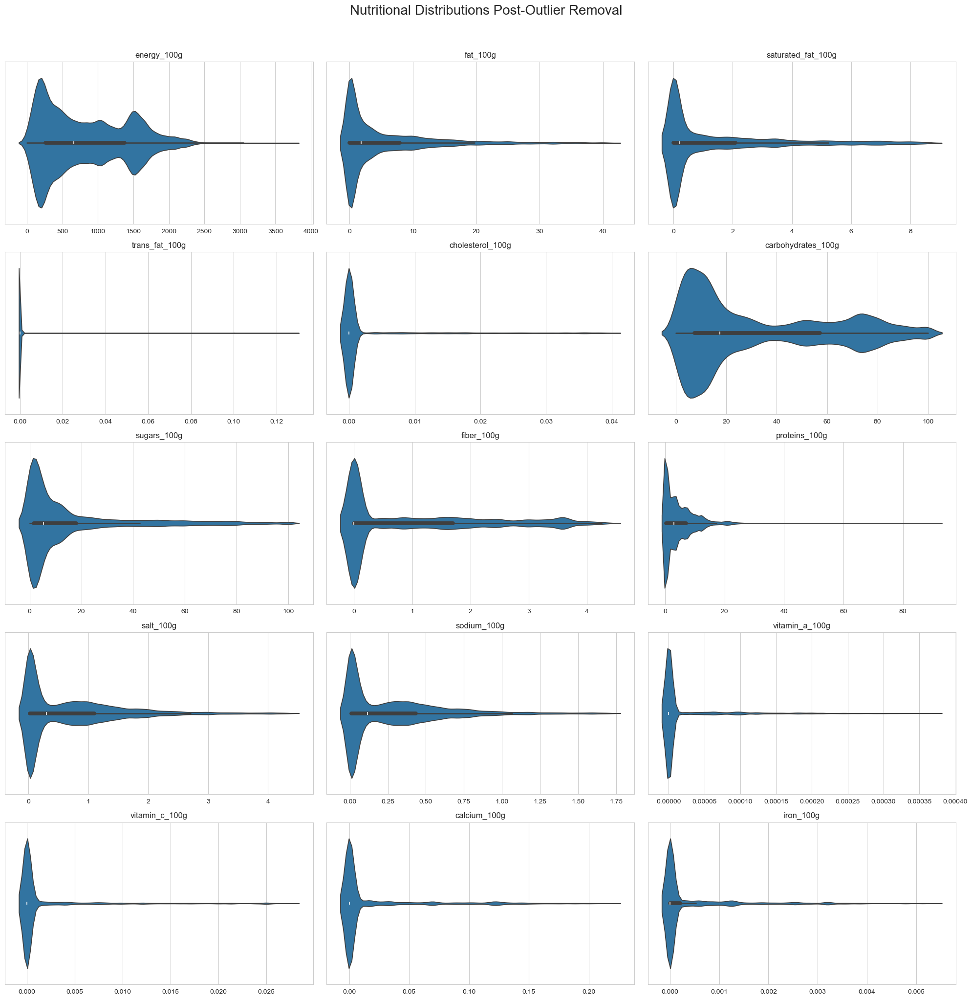

In [51]:
plt.figure(figsize=(20, 20))
rows = 5
columns = 3

for i, col in enumerate(nutritional_columns, 1):
    plt.subplot(rows, columns, i)
    sns.violinplot(x=filtered_df2[col].dropna())
    plt.title(col)
    plt.xlabel('')

plt.suptitle('Nutritional Distributions Post-Outlier Removal', fontsize=20, y=1.02)
plt.tight_layout()
plt.show()

From the violin plot, we can notice that distributions, after outlier removal, should appear more symmetric, with reduced extreme tails. Symmetric distributions, especially for macronutrients like proteins, fats, and carbohydrates, indicate that extreme values have been effectively managed.

Energy and macronutrients show distributions that are broad due to their general presence in varying amounts across different food products. Micronutrients like vitamins and minerals show skewness due to their varied presence in foods. However, after the outlier removal, the value range of these micronutrients can be appropriate within the logical range.

-- --

### 1.5 Data Type Handling

Inconsistent data types can be caused by human error, missing values, typos, different sources, different standards, or misalignment between the operation and data architecture teams. In machine learning, handling data types involves encoding categorical variables and standardizing numerical features to ensure uniformity in scale and representation across the dataset, which facilitates effective model training and prevents biases stemming from disparate scales or inconsistent formats.

In [52]:
# Check the data type of the columns in dataset
filtered_df2.dtypes

created_datetime            object
product_name                object
brands                      object
countries_en                object
ingredients_text            object
serving_size                object
additives_n                float64
additives_tags              object
additives_en                object
nutrition_grade_fr          object
main_category_en            object
energy_100g                float64
fat_100g                   float64
saturated_fat_100g         float64
trans_fat_100g             float64
cholesterol_100g           float64
carbohydrates_100g         float64
sugars_100g                float64
fiber_100g                 float64
proteins_100g              float64
salt_100g                  float64
sodium_100g                float64
vitamin_a_100g             float64
vitamin_c_100g             float64
calcium_100g               float64
iron_100g                  float64
nutrition_score_fr_100g    float64
nutrition_score_uk_100g    float64
total_components    

### 1.5.1 DateTime Type Conversion

In this section, we will focus on converting the 'created_datetime' columns from object to standard datatime data type.

In [53]:
filtered_df2.loc[:,['created_datetime']] = pd.to_datetime(filtered_df2['created_datetime'], format='%Y-%m-%dT%H:%M:%SZ',errors='coerce')

# Check the result
filtered_df2.created_datetime.head()

code
0000000016117    2017-03-09 10:35:30
0000000016650    2017-03-09 10:34:28
0000000018197    2017-03-09 10:34:12
0000000018562    2017-03-09 09:07:42
0000000032070    2017-03-09 10:35:20
Name: created_datetime, dtype: object

In [54]:
# Check the null values in created_datetime
filtered_df2[filtered_df2.created_datetime.isnull()]

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components
code,,,,,,,,,,,,,,,,,,,,,
3017760038409,NaT,Lulu la barquette (Fraise),LU,"France,Switzerland","Sirop de glucose-fructose, purée de fraises 27...","Un biscuit (6,66g)",2.0,"en:e330,en:e440","E330 - Citric acid,E440 - Pectins",d,...,4.2,0.08,0.031496,0.0,0.0,0.0,0.0,13.0,13.0,85.58


When we access the record with null values at 'created_datetime', we found that there is a record with invalid created_datetime, and lastly be converted to NAT, but it would not affect tha analysis result, so we can just keep it.

### 1.5.2 Label Encoding of Categories Column
In this section, we will establish a percentage threshold for category frequency. As we assume that each product belongs to only one category, we will employ label encoding. To ensure efficient encoding while preserving data integrity, we will limit the number of categories to a maximum of 15, excluding 'Other'. This approach guarantees effective encoding without compromising data integrity.

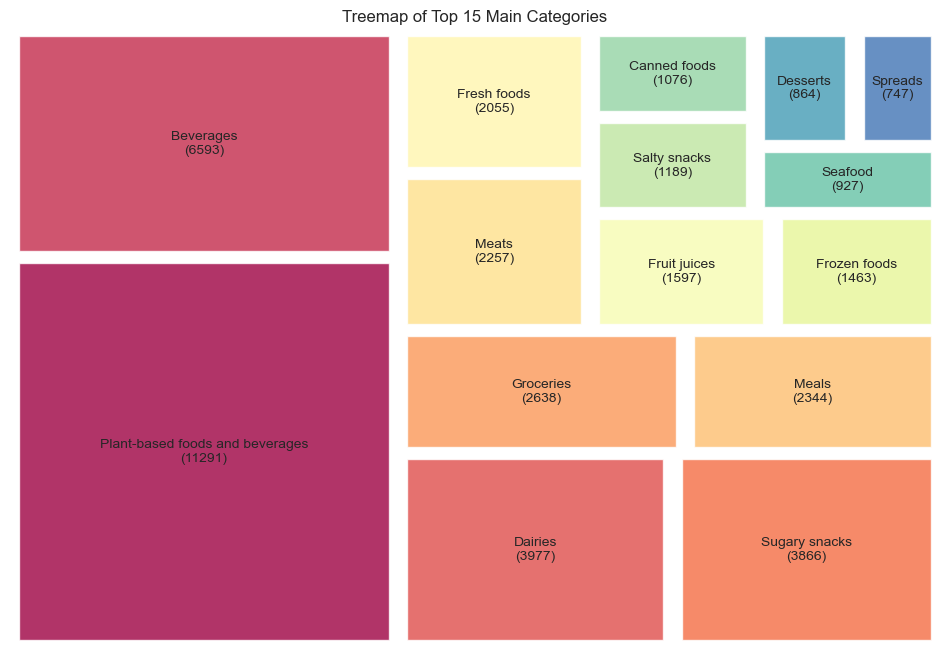

In [55]:
category_counts = filtered_df2['main_category_en'].value_counts().head(15)

labels = [f'{label}\n({size})' for label, size in zip(category_counts.index, category_counts.values)]
sizes = category_counts.values
colors = [plt.cm.Spectral(i / float(len(labels))) for i in range(len(labels))]

# Create a figure
plt.figure(figsize=(12, 8))

# Plot treemap with the label argument modified to include sizes
squarify.plot(sizes=sizes, label=labels, color=colors, alpha=0.8, pad=True)

# Set title
plt.title('Treemap of Top 15 Main Categories')

# Remove axis
plt.axis('off')

# Show plot
plt.show()

The treemap illustrates the distribution of the top 15 main food categories in the dataset, each represented by a uniquely colored rectangle which the size of each rectangle is proportional to the category's frequency. Categories like 'Plant-based foods and beverages' and 'Sugary Snacks' take up larger areas, reflecting their higher occurrence, while smaller rectangles such as 'Canned foods', 'Seafood', and 'Desserts' indicate less common categories.


In [56]:
# Select the top 15 most frequent categories (excluding the 'Other' category)
top_categories = category_counts.head(15).index

# Replace categories that are not in the top_categories list with 'Other'
filtered_df2.loc[:, ['main_category_en_encoded']] = filtered_df2['main_category_en'].apply(
    lambda x: x if x in top_categories else 'Other')

# Apply Label Encoding
label_encoder = LabelEncoder()

# Fit label encoder and return encoded labels
filtered_df2.loc[:, ['main_category_en_encoded_label']] = label_encoder.fit_transform(filtered_df2['main_category_en_encoded'])

In [57]:
# Check the structure of dataframe
filtered_df2.head()

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g,nutrition_score_fr_100g,nutrition_score_uk_100g,total_components,main_category_en_encoded,main_category_en_encoded_label
code,,,,,,,,,,,,,,,,,,,,,
0000000016117,2017-03-09 10:35:30,Organic Long Grain White Rice,Lundberg,United States,Organic long grain white rice,45 g (0.25 cup),0.0,NaN,NaN,NaN,...,0.000,0.0,0.0027,0.044,0.00000,NaN,NaN,88.93670,Other,10
0000000016650,2017-03-09 10:34:28,Organic Penne Pasta,Gardentime,United States,Organic refined durum semolina wheat flour,57 g (0.5 cup),0.0,NaN,NaN,NaN,...,0.000,0.0,0.0042,0.000,0.00126,NaN,NaN,91.27546,Other,10
0000000018197,2017-03-09 10:34:12,Lotus Organic Brown Jasmine Rice,Unfi,United States,Organic brown jasmine rice,45 g (0.25 cup),0.0,NaN,NaN,NaN,...,0.000,0.0,0.0000,0.000,0.00000,NaN,NaN,91.09000,Other,10
0000000018562,2017-03-09 09:07:42,"Sweeteners, Demerara Turbinado Sugar","Wholesome, Wholesome Sweeteners",United States,Raw cane demerara sugar.,4 g (1 tsp),0.0,NaN,NaN,NaN,...,0.000,0.0,0.0000,0.000,0.00000,NaN,NaN,100.00000,Other,10
0000000032070,2017-03-09 10:35:20,Organic Mixed Vegetable Spirals,Gardentime,United States,"Organic semolina flour, organic spinach powder...",57 g (0.5 cup),0.0,NaN,NaN,NaN,...,0.046,0.0,0.0000,0.000,0.00126,NaN,NaN,89.63810,Other,10


Now, the data frame contains the label encoding for the main category of products. However, the top five products are all in the category 'Other'; thus, let's check the portion of "Other" category.

(-1.1096439862138183,
 1.0903540703862011,
 -1.2045097331103043,
 1.1049766539541204)

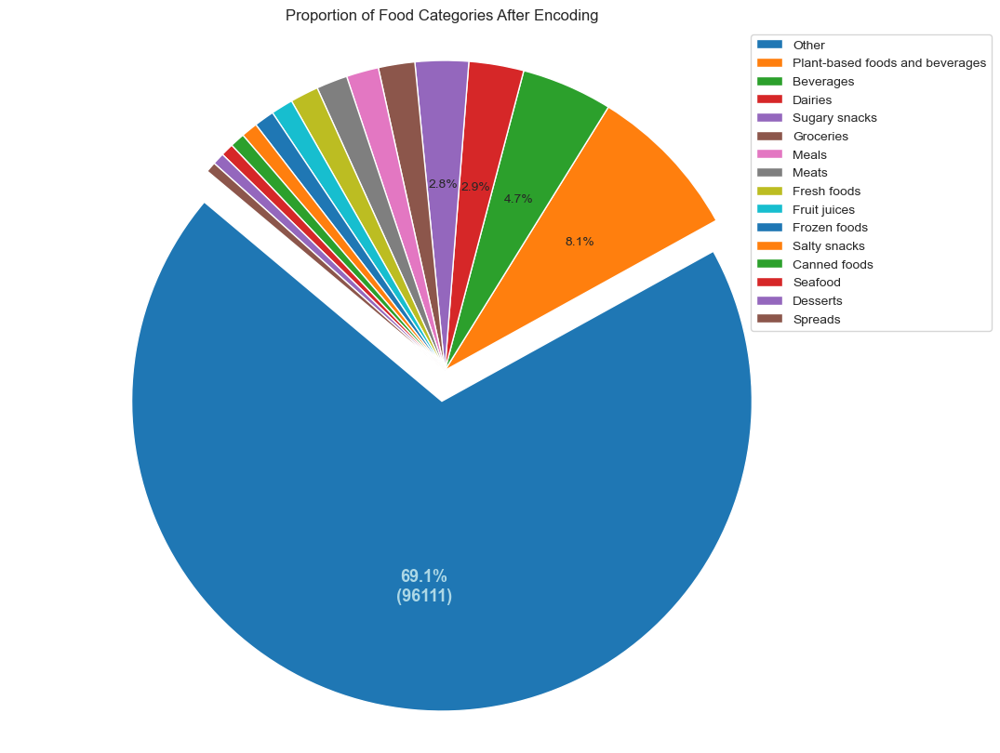

In [58]:
# Check the portion of 'Other' category
category_counts = filtered_df2['main_category_en_encoded'].value_counts()

labels = category_counts.index
counts = category_counts.values

# Calculate the percentage for the 'Other' slice to display it
other_percentage = counts[0] / sum(counts) * 100

# Set up explode to highlight the 'Other' slice
explode = [0.1] + [0] * (len(labels) - 1)

# Plot pie chart with adjusted figure size
plt.figure(figsize=(12, 10))
patches, texts, autotexts = plt.pie(counts, autopct='%1.1f%%', startangle=140, explode=explode)

# Make the 'Other' percentage bigger and bold, and add the count
for autotext in autotexts:
    if autotext.get_text() == f'{other_percentage:.1f}%':  # Match the 'Other' percentage
        autotext.set_text(f'{autotext.get_text()}\n({counts[0]})')
        autotext.set_color('lightblue')
        autotext.set_fontsize(13)
        autotext.set_fontweight('bold')

# Turn off the percentages for small slices by setting their color to None
for i, autotext in enumerate(autotexts):
    if counts[i] / sum(counts) < 0.02:
        autotext.set_color('none')

# Add a legend
plt.legend(patches, labels, loc='best', bbox_to_anchor=(0.85, 1))

plt.title('Proportion of Food Categories After Encoding')
plt.axis('equal')

The pie chart reveals a significant imbalance in our dataset. The "Other" category, encompassing a wide variety of items not classified into more specific categories, accounts for a whopping 69.1% (or 96,111 entries).

In [59]:
filtered_df2['main_category_en'].value_counts().tail(-15).sum()

5554

In [60]:
filtered_df2['main_category_en'].isnull().sum()

90557

A substantial number of product entries (90,557) lack a designated main category. Additionally, the tail end of the category distribution exhibits a long tail, with over 2,000 categories containing very few products each. These categories contribute a mere total of 5,554 entries when excluding the top 15 categories.

In this case, rather than simply assigning "Other" to categories beyond the top 15 and null values, we have decided on the following approach:

**Null Values:**
- Since we cannot accurately infer the category for these entries, we will designate them as "Unknown" instead of lumping them into "Other." This helps maintain the meaningfulness of the "Other" category for known but infrequent categories.

**Long Tail of Categories:**

- We will consider manually grouping smaller categories into larger, higher-level categories.
- Any category with a frequency less than 2 will be grouped into "Other."

In [61]:
# Load manual category mappings
with open('manual_category.json', 'r', encoding='utf-8') as json_file:
    manual_categories = json.load(json_file)


# Function to apply manual categorization
def apply_manual_categorization(category):
    for broad_category, subcategories in manual_categories.items():
        if category in subcategories:
            return re.sub(r'"(.*?)"', r'\1', broad_category)
    return category

filtered_df2.loc[:,['adjusted_category']] = filtered_df2['main_category_en'].apply(
    lambda x: apply_manual_categorization(x) if pd.notnull(x) else x)

# Label categories with frequency < 2 as 'Other' in the new column
value_counts = filtered_df2['adjusted_category'].value_counts()
to_replace = value_counts[value_counts < 2].index
filtered_df2.loc[:,['adjusted_category']] = filtered_df2['adjusted_category'].replace(to_replace, 'Other')

# Label null values as 'Unknown' in the new column
filtered_df2.loc[:,['adjusted_category']] = filtered_df2['adjusted_category'].fillna('Unknown')

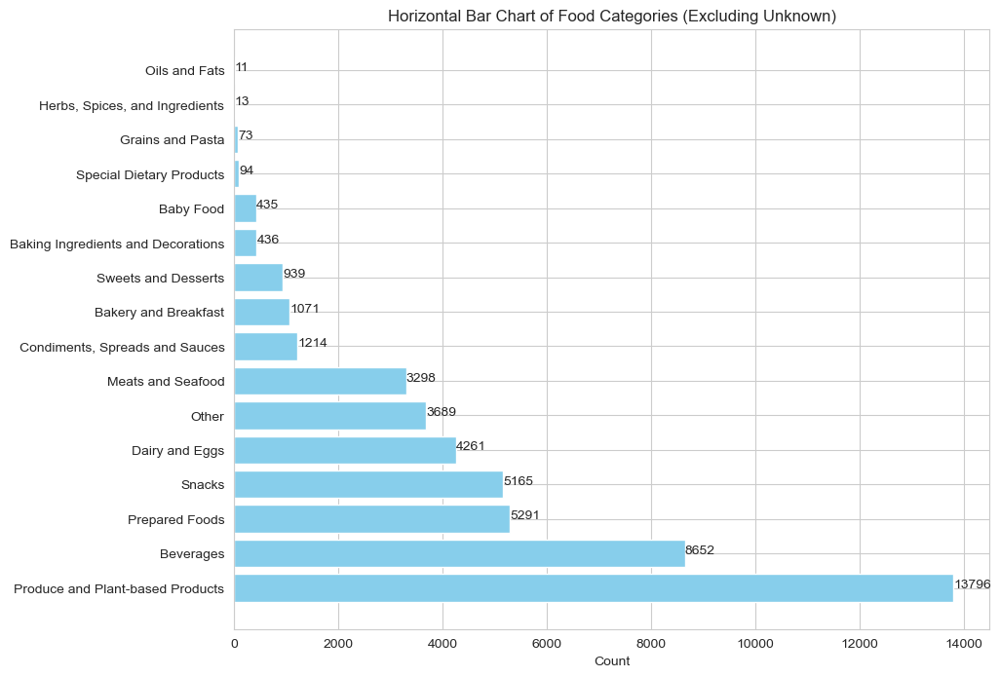

In [62]:
adjusted_category_counts = filtered_df2['adjusted_category'].value_counts()
adjusted_category_counts = adjusted_category_counts[adjusted_category_counts.index != 'Unknown']  # Exclude 'Unknown'
categories = adjusted_category_counts.index
counts = adjusted_category_counts.values

# Create horizontal bar chart
plt.figure(figsize=(10, 8))
y_pos = range(len(categories))
plt.barh(y_pos, counts, color='skyblue')
plt.yticks(y_pos, categories)
plt.xlabel('Count')
plt.title('Horizontal Bar Chart of Food Categories (Excluding Unknown)')

# To show the value next to each bar
for index, value in enumerate(counts):
    plt.text(value, index, str(value))

plt.show()

In [63]:
unknown_count = filtered_df2['adjusted_category'].value_counts()[
    filtered_df2['adjusted_category'].value_counts().index == 'Unknown'].values[0]
print(f"There are {'{:,}'.format(unknown_count)} occurrences of the 'Unknown' category.")

There are 90,557 occurrences of the 'Unknown' category.


***Considerations after Recategorization:***

After re-categorised, the "Other" category is not too large compared to other categories. However, there are still aspects to consider:

**The large "Unknown" category**: Including it in clustering might mask underlying patterns or form its own uninformative cluster.
**Underrepresented categories**: Categories with few items like "Herbs, Spices, and Ingredients" might be overshadowed in clustering results.
**Diversity within "Other"**: Its mix of various products could create a less cohesive cluster.
<br>

***Possible Solutions:***

**Handling "Unknown"**: Exclude it or handle it separately to avoid distorting clustering results.
**Feature exclusion**: Consider excluding the category feature altogether from the clustering process.

Let's continue performing the encoding

In [64]:
# One-hot encoding and create and 'encoded_df'
encoded_category_df = pd.get_dummies(filtered_df2['adjusted_category'], prefix='category', dtype=float)
# Convert column names to snake case
encoded_category_df.columns = [
    'category_' + column.split('category_')[1].replace(' ', '_').replace(',', '').replace('"', '').lower() for column in
    encoded_category_df.columns]

encoded_category_df.head()

,category_baby_food,category_bakery_and_breakfast,category_baking_ingredients_and_decorations,category_beverages,category_condiments_spreads_and_sauces,category_dairy_and_eggs,category_grains_and_pasta,category_herbs_spices_and_ingredients,category_meats_and_seafood,category_oils_and_fats,category_other,category_prepared_foods,category_produce_and_plant-based_products,category_snacks,category_special_dietary_products,category_sweets_and_desserts,category_unknown
code,,,,,,,,,,,,,,,,,
0000000016117,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0000000016650,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0000000018197,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0000000018562,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0000000032070,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


**Label Encoding vs. One-Hot Encoding for Clustering**

In the previous section, we discussed using label encoding for the food product categories. However, upon further consideration, label encoding might not be the optimal choice for clustering tasks.

**Why Label Encoding Isn't Ideal:**

Label encoding assigns a unique integer to each category. This implies an order among the categories that might not actually exist. For instance, if "Beverages" is encoded as 1, "Snacks" as 2, and "Dairy and Eggs" as 3, the clustering algorithm might interpret "Dairy and Eggs" as more similar to "Snacks" due to their numerical proximity. This could be misleading if there's no inherent order to these categories.

**Solution: One-Hot Encoding**

Therefore, for clustering purposes, we will employ one-hot encoding. One-hot encoding represents each category as a separate binary feature. This avoids imposing an artificial order on the categories and provides a more suitable representation for clustering algorithms.

Reference: https://datascience.stackexchange.com/questions/17927/categorical-data-in-kmeans

In [65]:
encoded_df = (filtered_df2.drop(columns=['main_category_en_encoded', 'main_category_en_encoded_label'])).join(
    encoded_category_df)
encoded_df.head()

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,category_herbs_spices_and_ingredients,category_meats_and_seafood,category_oils_and_fats,category_other,category_prepared_foods,category_produce_and_plant-based_products,category_snacks,category_special_dietary_products,category_sweets_and_desserts,category_unknown
code,,,,,,,,,,,,,,,,,,,,,
0000000016117,2017-03-09 10:35:30,Organic Long Grain White Rice,Lundberg,United States,Organic long grain white rice,45 g (0.25 cup),0.0,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0000000016650,2017-03-09 10:34:28,Organic Penne Pasta,Gardentime,United States,Organic refined durum semolina wheat flour,57 g (0.5 cup),0.0,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0000000018197,2017-03-09 10:34:12,Lotus Organic Brown Jasmine Rice,Unfi,United States,Organic brown jasmine rice,45 g (0.25 cup),0.0,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0000000018562,2017-03-09 09:07:42,"Sweeteners, Demerara Turbinado Sugar","Wholesome, Wholesome Sweeteners",United States,Raw cane demerara sugar.,4 g (1 tsp),0.0,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0
0000000032070,2017-03-09 10:35:20,Organic Mixed Vegetable Spirals,Gardentime,United States,"Organic semolina flour, organic spinach powder...",57 g (0.5 cup),0.0,NaN,NaN,NaN,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,1.0


At the end, we select 17 category tags, including "Other" and "Unkown". Limit encoding for categories is a practical decision that can help maintain model simplicity and interpretability. The original main category column will be kept in the EDA part for future use.

### 1.5.3 One Hot-Encoding for Countries Columns

In [66]:
encoded_df['countries_en'].value_counts()

countries_en
United States                                 72444
France                                        47660
Switzerland                                    6641
Germany                                        2814
Spain                                          2085
                                              ...  
France,Saudi Arabia                               1
European Union,Switzerland                        1
France,fr:Deutschland,fr:Irland,fr:Schweiz        1
Australia,United Kingdom                          1
Cook Islands,France                               1
Name: count, Length: 407, dtype: int64

From the result of the value_counts, we can notice that some products are available in multiple countries, and there are 626 unique values in this column.

In [67]:
# Transform the countries_en column into a list of countries for each row
countries_list = encoded_df['countries_en'].apply(lambda x: x.split(',') if pd.notnull(x) else [])
# Calculate the frequency of each country
country_frequency = countries_list.explode().value_counts()
country_frequency

countries_en
United States      72675
France             50004
Switzerland         7700
Germany             3232
Spain               2318
                   ...  
العراق                 1
المملكة-المتحدة        1
Burkina Faso           1
Szczecin               1
Cook Islands           1
Name: count, Length: 138, dtype: int64

The .explode() method is utilized to convert the list of countries in each row into separate rows. This transformation facilitates the easy counting of how often each country appears in the dataset. The resulting analysis reveals 172 unique countries identified. Directly converting these countries into separate columns could result in a sparse and high-dimensional problem, potentially leading to overfitting. Therefore, in this case, we will prioritize the top 10 countries based on their frequency, while the remaining countries will be grouped into an 'Others' category.

In [68]:
# Initialize the MultiLabelBinarizer
mlb = MultiLabelBinarizer()

# Select the top N countries. Here, we choose N=10
top_countries = country_frequency.head(10).index.tolist()


# Keep top N and replacing others with 'Other'
def group_countries(countries):
    filtered_countries = [country if country in top_countries else 'Other' for country in countries]
    # Remove duplicates that might occur after replacing with 'Other'
    return list(set(filtered_countries))


grouped_countries_list = countries_list.apply(group_countries)

# Use MultiLabelBinarizer again on the grouped list
countries_encoded = mlb.fit_transform(grouped_countries_list)
countries_encoded = pd.DataFrame(countries_encoded, columns=mlb.classes_, index=countries_list.index)

# Format the column names with a prefix and in snake case
countries_encoded.columns = [
    'country_' + col.replace(' ', '_').replace('-', '_').replace(',', '').replace('"', '').lower()
    for col in countries_encoded.columns
]

countries_encoded

,country_australia,country_belgium,country_france,country_germany,country_italy,country_other,country_russia,country_spain,country_switzerland,country_united_kingdom,country_united_states
code,,,,,,,,,,,
0000000016117,0,0,0,0,0,0,0,0,0,0,1
0000000016650,0,0,0,0,0,0,0,0,0,0,1
0000000018197,0,0,0,0,0,0,0,0,0,0,1
0000000018562,0,0,0,0,0,0,0,0,0,0,1
0000000032070,0,0,0,0,0,0,0,0,0,0,1
...,...,...,...,...,...,...,...,...,...,...,...
9644000330654,0,0,0,0,0,0,0,0,0,0,1
9755635018555,0,0,0,0,0,0,0,0,0,0,1
9780545789646,0,0,1,0,0,0,0,0,0,0,0


In [69]:
# concatenate dataframe
encoded_df = pd.concat([encoded_df, countries_encoded], axis=1)

In [70]:
encoded_df.head()

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_tags,additives_en,nutrition_grade_fr,...,country_belgium,country_france,country_germany,country_italy,country_other,country_russia,country_spain,country_switzerland,country_united_kingdom,country_united_states
code,,,,,,,,,,,,,,,,,,,,,
0000000016117,2017-03-09 10:35:30,Organic Long Grain White Rice,Lundberg,United States,Organic long grain white rice,45 g (0.25 cup),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,1
0000000016650,2017-03-09 10:34:28,Organic Penne Pasta,Gardentime,United States,Organic refined durum semolina wheat flour,57 g (0.5 cup),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,1
0000000018197,2017-03-09 10:34:12,Lotus Organic Brown Jasmine Rice,Unfi,United States,Organic brown jasmine rice,45 g (0.25 cup),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,1
0000000018562,2017-03-09 09:07:42,"Sweeteners, Demerara Turbinado Sugar","Wholesome, Wholesome Sweeteners",United States,Raw cane demerara sugar.,4 g (1 tsp),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,1
0000000032070,2017-03-09 10:35:20,Organic Mixed Vegetable Spirals,Gardentime,United States,"Organic semolina flour, organic spinach powder...",57 g (0.5 cup),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,1


The top 10 countries consist of 'United States', 'France', 'Switzerland', 'Germany', 'Spain', 'United Kingdom', 'Belgium', 'Russia', 'Italy', and 'Australia',and group all other countries into an "Other" category. The result is encoded into one-hot encoding, allowing for multiple class categorisation. This reduces dimensionality while retaining the most relevant information.

### 1.5.4 Cleaning Additives Tags Column

The goal of this step is to clean up the additives_tags column in our dataset. Originally, each entry in this column consists of additive tags separated by commas, with each tag prefixed by "en:". This prefix is a language code that isn't necessary for our analysis, so we'll remove it to simplify the data.

In [71]:
# Split the string on commas, remove "en:" prefix, then join back with commas
encoded_df['additives_tags_cleaned'] = encoded_df['additives_tags'].fillna('').apply(
    lambda x: ','.join([tag.replace('en:', '') for tag in x.split(',')]))

# Display the before and after
encoded_df[['additives_tags', 'additives_tags_cleaned']]

,additives_tags,additives_tags_cleaned
code,,
0000000016117,NaN,
0000000016650,NaN,
0000000018197,NaN,
0000000018562,NaN,
0000000032070,NaN,
...,...,...
9644000330654,"en:e14xx,en:e150a","e14xx,e150a"
9755635018555,"en:e296,en:e330,en:e422","e296,e330,e422"
9780545789646,NaN,


### 1.5.5 One Hot Encoding for Additives Tags Column

Similar to the case of countries_en column, we will also perform one hot encoding for the additivies tags, allowing multi class categories.

In [72]:
# Transform the additives_tags_cleaned column into a list of additivies for each row
additive_list = encoded_df['additives_tags_cleaned'].apply(lambda x: x.split(',') if pd.notnull(x) else [])
# Calculate the frequency of each additive
additive_frequency = additive_list.explode().value_counts()
additive_frequency

additives_tags_cleaned
          52373
e330      31087
e375      12342
e101      11995
e101i     11655
          ...  
e1521         1
e367          1
e335ii        1
e553          1
e318          1
Name: count, Length: 413, dtype: int64

From the result, about 130,792 products are not added with additives, and the most used additives is e330 followed by e322.

In [73]:
# Remove the empty string entry from consideration
additive_frequency = additive_frequency = additive_frequency.drop('')

In [74]:
# Get top additives used
top_additives = additive_frequency.head(10).index.tolist()
top_additives

['e330',
 'e375',
 'e101',
 'e101i',
 'e300',
 'e415',
 'e322',
 'e322i',
 'e440',
 'e412']

When selecting the top additives, we exclude the empty string entry to ensure that the focus remains on actual additives.

In [75]:
def process_additives(row):
    # Remove any empty strings from the list
    row = [item.strip() for item in row.split(',') if item]
    if not row:
        return []

    # Replace non-top additives with 'Other'
    processed = [additive if additive in top_additives else 'Other' for additive in row]
    return list(set(processed))


# Apply the function to process the additives list
encoded_df['processed_additives'] = encoded_df['additives_tags_cleaned'].apply(process_additives)

In [76]:
mlb = MultiLabelBinarizer()

# Transform the processed additives using MultiLabelBinarizer
processed_additives_encoded = mlb.fit_transform(encoded_df['processed_additives'])

# Create a DataFrame from the encoded additives
processed_additives_encoded_df = pd.DataFrame(processed_additives_encoded, columns=mlb.classes_)

# Ensure the new DataFrame has the same index as the original DataFrame
processed_additives_encoded_df.index = encoded_df.index

# Format the column names with a prefix and in snake case
processed_additives_encoded_df.columns = [
    'additive_' + col.replace(' ', '_').replace(',', '').replace('"', '').lower()
    for col in processed_additives_encoded_df.columns
]

# Combine the original DataFrame with the newly encoded additives DataFrame
final_encoded_df = pd.concat([encoded_df, processed_additives_encoded_df], axis=1)

In [77]:
# Drop unnecessary column to keep df clean
final_encoded_df = final_encoded_df.drop(['processed_additives', 'additives_tags'], axis=1)
final_encoded_df.head()

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,additives_en,nutrition_grade_fr,main_category_en,...,additive_e101,additive_e101i,additive_e300,additive_e322,additive_e322i,additive_e330,additive_e375,additive_e412,additive_e415,additive_e440
code,,,,,,,,,,,,,,,,,,,,,
0000000016117,2017-03-09 10:35:30,Organic Long Grain White Rice,Lundberg,United States,Organic long grain white rice,45 g (0.25 cup),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
0000000016650,2017-03-09 10:34:28,Organic Penne Pasta,Gardentime,United States,Organic refined durum semolina wheat flour,57 g (0.5 cup),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
0000000018197,2017-03-09 10:34:12,Lotus Organic Brown Jasmine Rice,Unfi,United States,Organic brown jasmine rice,45 g (0.25 cup),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
0000000018562,2017-03-09 09:07:42,"Sweeteners, Demerara Turbinado Sugar","Wholesome, Wholesome Sweeteners",United States,Raw cane demerara sugar.,4 g (1 tsp),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0
0000000032070,2017-03-09 10:35:20,Organic Mixed Vegetable Spirals,Gardentime,United States,"Organic semolina flour, organic spinach powder...",57 g (0.5 cup),0.0,NaN,NaN,NaN,...,0,0,0,0,0,0,0,0,0,0


Similar to the country case, given that our dataset includes a diverse range of additives, we first ensure that only the most prevalent are considered and the rest will be 'Others'. This strategy significantly reduces the complexity of our model without sacrificing essential information.

### 1.5.6 Convert Additives Info to Dictionary

Creating a dictionary from the additives_en column and exporting it as a JSON file simplifies data access. This section transforms additive information into a dict, where additive codes map to their names. By exporting to JSON, we can  make the data available for future use. This method not only reducing redundancy but also cleans up the main dataset.

In [78]:
import json

def build_additives_dict(data_column):
    additives_dict = {}
    for additives_str in data_column.dropna():
        if additives_str == '':
            continue
        additives_list = additives_str.split(',')
        for additive in additives_list:
            parts = additive.split(' - ', 1)
            if len(parts) == 2:
                code, name = parts[0].strip(), parts[1].strip()
                additives_dict[code] = name
    return additives_dict


# Building the additives dictionary from the entire 'additives_en' column
additives_dict = build_additives_dict(final_encoded_df['additives_en'])


# Export this dictionary to a JSON file for later used
def export_additives_to_json(filename, additives_dict):
    with open(filename, 'w') as file:
        json.dump(additives_dict, file, indent=4)


# Exporting the dictionary to 'additives_dictionary.json'
export_additives_to_json('additives_dictionary.json', additives_dict)

final_encode_df = final_encoded_df.drop('additives_en', axis=1)

In [79]:
# Check the structure of df
final_encode_df.head()

,created_datetime,product_name,brands,countries_en,ingredients_text,serving_size,additives_n,nutrition_grade_fr,main_category_en,energy_100g,...,additive_e101,additive_e101i,additive_e300,additive_e322,additive_e322i,additive_e330,additive_e375,additive_e412,additive_e415,additive_e440
code,,,,,,,,,,,,,,,,,,,,,
0000000016117,2017-03-09 10:35:30,Organic Long Grain White Rice,Lundberg,United States,Organic long grain white rice,45 g (0.25 cup),0.0,NaN,NaN,1490.0,...,0,0,0,0,0,0,0,0,0,0
0000000016650,2017-03-09 10:34:28,Organic Penne Pasta,Gardentime,United States,Organic refined durum semolina wheat flour,57 g (0.5 cup),0.0,NaN,NaN,1540.0,...,0,0,0,0,0,0,0,0,0,0
0000000018197,2017-03-09 10:34:12,Lotus Organic Brown Jasmine Rice,Unfi,United States,Organic brown jasmine rice,45 g (0.25 cup),0.0,NaN,NaN,1582.0,...,0,0,0,0,0,0,0,0,0,0
0000000018562,2017-03-09 09:07:42,"Sweeteners, Demerara Turbinado Sugar","Wholesome, Wholesome Sweeteners",United States,Raw cane demerara sugar.,4 g (1 tsp),0.0,NaN,NaN,1569.0,...,0,0,0,0,0,0,0,0,0,0
0000000032070,2017-03-09 10:35:20,Organic Mixed Vegetable Spirals,Gardentime,United States,"Organic semolina flour, organic spinach powder...",57 g (0.5 cup),0.0,NaN,NaN,1490.0,...,0,0,0,0,0,0,0,0,0,0


-- --
### 1.6 Handle Inconsistent Data

Inconsistent data is data that doesn't follow a set of rules or constraints, resulting in conflicting, inaccurate, or duplicate information. It can occur when data values don't match the expected format, type, range, or logic of the data schema or domain. Inconsistent data formatting can be a major obstacle in machine learning, leading to inaccuracies and hindering model performance.

### 1.6.1 Standardise Serving Sizes

Standardizing serving sizes in dataset is crucial for consistent analysis. The serving_size column contains various formats, making direct comparisons challenging. Thus, we will convert all serving sizes to a common unit, such as grams (g).

In [80]:
# Display unique serving size formats
unique_serving_sizes = final_encode_df['serving_size'].unique()
print(unique_serving_sizes[:10])  # Displaying the first 10 for brevity

['45 g (0.25 cup)' '57 g (0.5 cup)' '4 g (1 tsp)' '56 g (0.5 cup)'
 '58 g (0.5 cup)' '30 g (0.25 cup)' '15 ml (1 Tbsp)' '51 g (0.25 cup)'
 '4 ml (1 tsp)' '100 g (100 g)']


First, we inspect the unique formats present in the serving_size column to understand the variation. From the result, we can notice that the unit can mix together wth the remark like 1 ONZ, 0.25 cup and so on. Thus, we decide to use regex to extract the serving size string.

In [81]:
def conversion_function(serving):
    if pd.isna(serving):
        return None

    # Strip the serving input to remove any leading/trailing whitespaces
    cleaned_serving = serving.strip()

    # Attempt to convert the cleaned input to a float and check if it equals zero
    try:
        if float(cleaned_serving) == 0:
            return None
    except ValueError:
        pass  # If conversion fails, continue with the rest of the function

    # Normalize the string by replacing commas with periods
    cleaned_serving = cleaned_serving.replace(",", ".")

    # Define patterns for known units of measurement
    unit_patterns = {
        r"(\d+[\.,]?\d*)\s*ml": 1,
        r"(\d+[\.,]?\d*)\s*mk": 1,
        r"(\d+[\.,]?\d*)\s*(g|gram)s?": 1,
        r"(\d+[\.,]?\d*)\s*dl": 100,
        r"(\d+[\.,]?\d*)\s*fl\s*oz": 29.5735,
        r"(\d+[\.,]?\d*)\s*fl.\s*oz.": 29.5735,
        r"(\d+[\.,]?\d*)\s*oz": 28.3495,
        r"(\d+[\.,]?\d*)\s*cl": 10,
        r"(\d+[\.,]?\d*)\s*l": 1000,
        r"(\d+[\.,]?\d*)\s*pint": 473.176,
        r"(\d+[\.,]?\d*)\s*tbsp": 14.7868,
        r"(\d+[\.,]?\d*)\s*mg": 0.001,
        r"(\d+[\.,]?\d*)\s*kg": 1000,
        r"(\d+[\.,]?\d*)\s*tsp": 4.92892,
    }

    # Check for known units and convert if found
    for pattern, conversion_factor in unit_patterns.items():
        match = re.search(pattern, cleaned_serving, re.IGNORECASE)
        if match:
            quantity = float(match.group(1))
            return quantity * conversion_factor

    # Check for a standalone number without additional text
    standalone_number_pattern = r"^(\d+[\.,]?\d*)$"
    match = re.match(standalone_number_pattern, cleaned_serving)
    if match:
        return float(match.group(1))

    # No known units of measurement and no standalone number, return None
    return None

In [82]:
# Apply the function to the 'serving_size' column
final_encode_df['serving_size_g'] = final_encode_df['serving_size'].apply(conversion_function)

# Compare before and after extract the serving size
final_encode_df[['serving_size', 'serving_size_g']].head()

,serving_size,serving_size_g
code,,
0000000016117,45 g (0.25 cup),45.0
0000000016650,57 g (0.5 cup),57.0
0000000018197,45 g (0.25 cup),45.0
0000000018562,4 g (1 tsp),4.0
0000000032070,57 g (0.5 cup),57.0


In [83]:
# Check the portion of unconverted serving size
final_encode_df[(~final_encode_df['serving_size'].isnull()) & (final_encode_df['serving_size_g'].isnull())][
    ['product_name', 'serving_size', 'serving_size_g']]


,product_name,serving_size,serving_size_g
code,,,
0014100078845,Santa Cruz Soft Baked Oatmeal Raisin Soft Cookies,1 Cookie,NaN
0049000054552,Sprite,1 bottle,NaN
0073472001196,Sprouted Grain English Muffins,1/2 muffin,NaN
0075172079307,Raspberry Licorice,1 bar,NaN
0099482439040,Morning O's,1 cup,NaN
...,...,...,...
8710412545045,Sultana fruitbiscuit pomme,1 biscuit 14.5,NaN
8710412615113,Fruits and break Saveur fruits rouges,3 biscuits,NaN
8711542001906,Drop,Engels,NaN


This step shows entries in the dataset (71 records) where product serving sizes lack proper unit measurements (e.g., "1 cookie") or use unconventional units (e.g., "1 bottle"). Due to the inconsistency, these values will be converted to NAN (Not a Number).

In [84]:
final_encode_df.serving_size_g

code
0000000016117    45.0
0000000016650    57.0
0000000018197    45.0
0000000018562     4.0
0000000032070    57.0
                 ... 
9644000330654    18.0
9755635018555    40.0
9780545789646     NaN
9836654056565    57.0
99111250          NaN
Name: serving_size_g, Length: 138995, dtype: float64

In [85]:
print(
    f"There are {final_encode_df['serving_size'].isnull().sum()} entries in 'serving_size' column with missing values.\nTotal After Conversion: {final_encode_df['serving_size_g'].isnull().sum()}")

There are 39415 entries in 'serving_size' column with missing values.
Total After Conversion: 39486


In addition to the 71 records mentioned earlier, there are also 39,415 entries whose serving sizes were initially missing from the dataset. However, since our nutritional data is standardised to per 100g, the impact of serving size on the direct comparison of nutritional values is minimal. This means that serving size does not add significant value for clustering purely based on nutrient composition.

However, for broader content insights, the serving size can become more relevant as it can help translate the per 100g data to actual consumption scenarios. Thus, in this case, we will impute the serving size with the maidan of the same categories of products, and in the later part, we might consider analysing how the presence or absence of serving size affects the stability and interpretability of your clusters.

### 1.6.2 Fill the Missing Value in Serving Size column

#### 1.6.2.1 Impute Servig Sizes for Standard Categories

For entries with standard categories (those not labeled as "Other" or "Unknown"), we can impute missing serving sizes using the median serving size of their respective categories. Imputing with the median helps maintain the central tendency of the data without adding mean bias in case of non-normal distributions.

In [86]:
median_serving_sizes = final_encode_df.loc[(final_encode_df['adjusted_category'] != 'Other') & (final_encode_df['adjusted_category'] != 'Unknown'),'serving_size_g'].groupby(final_encode_df['adjusted_category']).median()

median_serving_sizes

adjusted_category
Baby Food                             200.00
Bakery and Breakfast                  140.00
Baking Ingredients and Decorations      5.95
Beverages                             200.00
Condiments, Spreads and Sauces         25.00
Dairy and Eggs                        125.00
Grains and Pasta                      126.00
Herbs, Spices, and Ingredients        105.00
Meats and Seafood                      45.25
Oils and Fats                            NaN
Prepared Foods                        225.00
Produce and Plant-based Products      100.00
Snacks                                 28.00
Special Dietary Products               35.00
Sweets and Desserts                    79.40
Name: serving_size_g, dtype: float64

Since oils and fats are NaN in this case, we will impute the serving size using the overall median.

In [87]:
final_encode_df['impute_serving_size'] = final_encode_df.apply(
    lambda row: median_serving_sizes[row['adjusted_category']] if pd.isna(row['serving_size_g']) and row[
        'adjusted_category'] not in ['Other', 'Unknown', 'Oils and Fats'] else row['serving_size_g'], axis=1)

overall_median = final_encode_df['serving_size_g'].median()

final_encode_df[final_encode_df['adjusted_category'] == 'Oils and Fats']['impute_serving_size'] = overall_median
final_encode_df['impute_serving_size'] = final_encode_df.apply(
    lambda row: overall_median if pd.isna(row['serving_size_g']) and row['adjusted_category'] in ['Oils and Fats'] else row['serving_size_g'], axis=1)

C:\Users\wr431\AppData\Local\Temp\ipykernel_17208\2660022794.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  final_encode_df[final_encode_df['adjusted_category'] == 'Oils and Fats']['impute_serving_size'] = overall_median


In [88]:
final_encode_df['impute_serving_size'] = final_encode_df.apply(
    lambda row: median_serving_sizes[row['adjusted_category']] if pd.isna(row['serving_size_g']) and row[
        'adjusted_category'] not in ['Other', 'Unknown', 'Oils and Fats'] else row['serving_size_g'], axis=1)

overall_median = final_encode_df['serving_size_g'].median()

final_encode_df.loc[final_encode_df['adjusted_category'] == 'Oils and Fats', 'impute_serving_size'] = overall_median

In [89]:
# Drop serving size to keep dataframe clean
final_encode_df = final_encode_df.drop('serving_size', axis=1)

#### 1.6.2.2 Removing Null Serving Sizes in 'Other' and 'Unknown' Categories

Imputation methods were considered but deemed inappropriate due to the broad and undefined nature of the 'Other' and 'Unknown' categories. These categories likely encompass diverse products with varying serving sizes, making any imputation inaccurate and potentially misleading for clustering analysis.

Thus, to maintain the integrity of our analysis, records with missing serving sizes in these categories were removed. This approach ensures that our dataset reflects accurate measurements without introducing biases from imputed values based on broad assumptions.

In [90]:
# Count items in 'Other' category without a serving size
other_no_serving_size_count = final_encode_df[
    (final_encode_df['adjusted_category'] == 'Other') &
    (final_encode_df['serving_size_g'].isna())
    ].shape[0]

# Count items in 'Unknown' category without a serving size
unknown_no_serving_size_count = final_encode_df[
    (final_encode_df['adjusted_category'] == 'Unknown') &
    (final_encode_df['serving_size_g'].isna())
    ].shape[0]

print(f"Number of items in 'Other' category without a serving size: {other_no_serving_size_count}")
print(f"Number of items in 'Unknown' category without a serving size: {unknown_no_serving_size_count}")

Number of items in 'Other' category without a serving size: 2089
Number of items in 'Unknown' category without a serving size: 15061


In [91]:
initial_count = final_encode_df.shape[0]

# Removing records where serving size is NaN in the 'Other' and 'Unknown' categories
final_encode_df1 = final_encode_df[~((final_encode_df['adjusted_category'].isin(['Other', 'Unknown'])) & (final_encode_df['serving_size_g'].isna()))]

# Count of rows after removal to verify how many records were dropped
final_count = final_encode_df1.shape[0]

# Print the initial and final count of rows, and the number of rows removed
print(f"Initial number of records: {initial_count}")
print(f"Final number of records after removal: {final_count}")
print(f"Number of records removed: {initial_count - final_count}")


Initial number of records: 138995
Final number of records after removal: 121845
Number of records removed: 17150


In [92]:
final_encode_df1[final_encode_df1.impute_serving_size.isnull()]

,created_datetime,product_name,brands,countries_en,ingredients_text,additives_n,nutrition_grade_fr,main_category_en,energy_100g,fat_100g,...,additive_e300,additive_e322,additive_e322i,additive_e330,additive_e375,additive_e412,additive_e415,additive_e440,serving_size_g,impute_serving_size
code,,,,,,,,,,,,,,,,,,,,,


In [93]:
final_encode_df1[final_encode_df1.impute_serving_size.isna()]

,created_datetime,product_name,brands,countries_en,ingredients_text,additives_n,nutrition_grade_fr,main_category_en,energy_100g,fat_100g,...,additive_e300,additive_e322,additive_e322i,additive_e330,additive_e375,additive_e412,additive_e415,additive_e440,serving_size_g,impute_serving_size
code,,,,,,,,,,,,,,,,,,,,,


### 1.7 Handle Duplicate Data

Removing duplicate entries from the dataset is crucial for ensuring the integrity and accuracy of the analysis. Duplicate rows can skew results, lead to incorrect conclusions, and affect the performance of machine learning models.

### 1.7.1 Duplicated Row

This section will focus on remove the row with similar feature values.

In [94]:
#Check whether there are any duplicates in our data
print('There are {:,} duplicates row in the dataset'.format(final_encode_df1.duplicated().sum()))

There are 294 duplicates row in the dataset


In [95]:
# Remove entirely duplicate rows, keeping the first occurrence
final_encode_df_cleaned = final_encode_df1.drop_duplicates(keep='first')

# Print the number of rows before and after removing duplicates
print('Original rows: {:,}'.format(len(final_encode_df1)))
print('Rows after removing duplicates: {:,}'.format(len(final_encode_df_cleaned)))

Original rows: 121,845
Rows after removing duplicates: 121,551


### 1.7.2 Duplicated Info Columns

The dataset includes both nutrition_grade_fr and nutrition_score_fr_100g columns, both of them provide the insight about the nutrition value from france. Thus, we understand the relationship between these two and decide whether to drop one of them as they might provide same information. A scatter plot or a box plot could serve to visualize the relationship between the numeric nutrition_score_fr_100g and the categorical nutrition_grade_fr data.

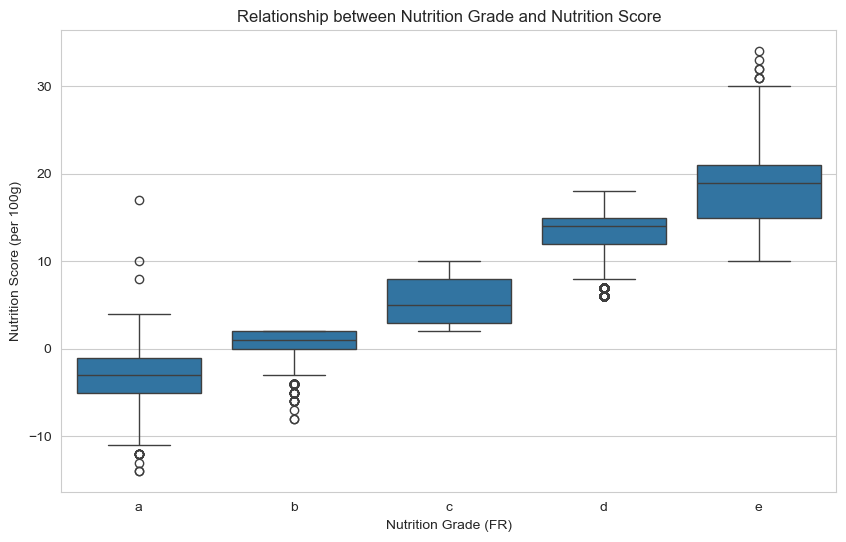

In [96]:
import matplotlib.pyplot as plt
import seaborn as sns

# Ensure there are no missing values in these columns for visualization
data_filtered = final_encode_df_cleaned.dropna(subset=['nutrition_grade_fr', 'nutrition_score_fr_100g'])

plt.figure(figsize=(10, 6))
sns.boxplot(x='nutrition_grade_fr', y='nutrition_score_fr_100g', data=data_filtered, order=['a', 'b', 'c', 'd', 'e'])
plt.title('Relationship between Nutrition Grade and Nutrition Score')
plt.xlabel('Nutrition Grade (FR)')
plt.ylabel('Nutrition Score (per 100g)')
plt.show()

The box plot illustrates the relationship between nutrition_grade_fr and nutrition_score_fr_100g. It's expected to show a progression in nutrition scores across different nutrition grades (from 'a' to 'e'), reflecting the underlying criteria that determine both the grade and the score.

Each nutrition grade category has a distinct range of nutrition scores with minimal overlap, indicating a strong correlation between the two variables. Since the score gives a numerical range that can be more finely analyzed and is likely derived from the same underlying data as the grade, we consider dropping nutrition_grade_fr to reduce redundancy.

In [97]:
# Drop nutrition_grade_fr column
final_encode_df_cleaned = final_encode_df_cleaned.drop('nutrition_grade_fr', axis=1)

### 1.8 Model-Based Imputation on Nutrition Scores for France (Fr) and the United Kingdom (UK)

***This will be the last part of data preprocessing, as it must confirm the completeness of the feature columns before imputing the null values in the target columns.***

Model-based imputation refers to methods that utilize data distribution assumptions to estimate missing values. One such method is **KNN imputation**, which identifies the nearest neighbours to a missing datum from all complete instances in a dataset. It employs the Euclidean distance matrix to locate similar samples and imputes the missing values using the mean value of these nearest neighbours. The replacement values can be computed using the neighbours' uniform or weighted mean specified through the `n_neighbors` hyperparameter. In the case of a definite target feature, the missing datum is filled in with the most frequent value occurring among the neighbours. By employing KNN imputation, we effectively estimate missing nutrition scores for France and the United Kingdom, thereby enhancing the completeness and reliability of our dataset for further analysis.

***Source***
- [ScienceDirect](https://www.sciencedirect.com/science/article/abs/pii/S0164121212001586#:~:text=kNN%20imputation%20is%20designed%20to,or%20attribute)
- [Medium](https://towardsdatascience.com/the-dos-and-donts-of-imputation-d89d72a26a58)

In [98]:
nutritional_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'trans_fat_100g',
    'cholesterol_100g', 'carbohydrates_100g', 'sugars_100g', 'fiber_100g',
    'proteins_100g', 'salt_100g', 'sodium_100g', 'vitamin_a_100g',
    'vitamin_c_100g', 'calcium_100g', 'iron_100g'
]
target_columns = ['nutrition_score_fr_100g', 'nutrition_score_uk_100g']

In [99]:
from sklearn.impute import KNNImputer

# Prepare data including target columns,use float for the imputation calculation
X_full = final_encode_df_cleaned[nutritional_columns + target_columns]

# Initialize the KNN Imputer
imputer = KNNImputer(n_neighbors=5)

# Fit and transform the dataset to fill in missing values
X_imputed = imputer.fit_transform(X_full)

In [100]:
original_index = final_encode_df_cleaned.index

# Convert the imputed data back to DataFrame, reassigning the original index
column_names = nutritional_columns + target_columns

imputed_df = pd.DataFrame(X_imputed, columns=column_names, index=original_index)

# Since the score is originally written in integer, thus, we convert imputed values to integers
imputed_df[target_columns] = imputed_df[target_columns].round().astype(int)

In [101]:
# Replace the nutrition column in
final_encode_df_cleaned.loc[imputed_df.index, ['nutrition_score_fr_100g', 'nutrition_score_uk_100g']] = imputed_df[['nutrition_score_fr_100g', 'nutrition_score_uk_100g']]

In [102]:
final_encode_df_cleaned[target_columns].isnull().sum()

nutrition_score_fr_100g    0
nutrition_score_uk_100g    0
dtype: int64

### Part 2 Exploratory data analysis (EDA)

***Exploratory data analysis (EDA)*** is a statistical method for analyzing data sets to identify their main characteristics. It involves using data visualization methods, such as statistical graphics, to explore, investigate, and learn from a data set. The goal of EDA is to develop an understanding of the data, rather than to confirm statistical hypotheses. It is an iterative process that involves asking questions about the data, visualizing and transforming the data, and using the findings to refine the questions.

In common practice, EDA will be performed before the data cleaning; however, because of the nature of the data, we perform the EDA after the data cleaning.

### 2.1 Trend Over Time

In this section, we analyze the trend over time of various aspects related to product types and nutritional content.

### 2.1.1 Product types over time

We start by examining how the number of products in different categories has evolved throughout the observed period.

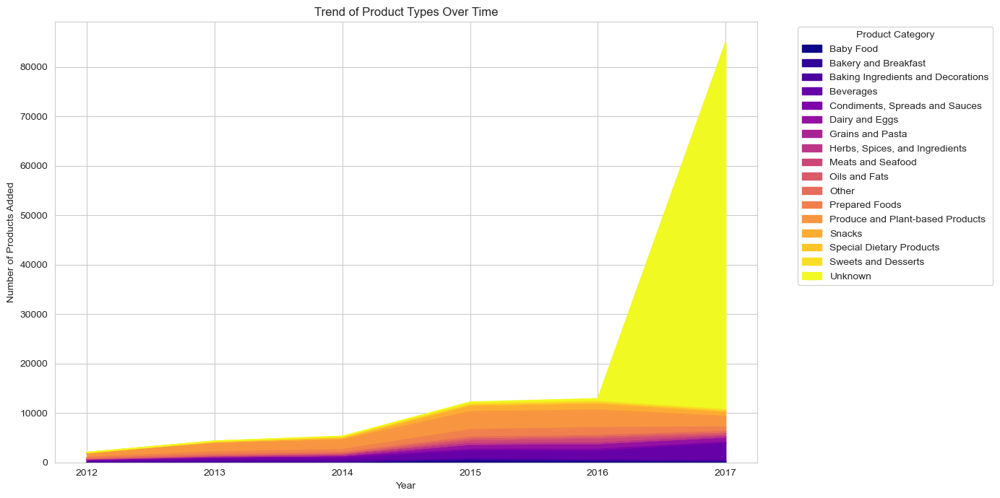

In [103]:
# Extract year from created_datetime for grouping & exclude Unknown category
final_encode_df_cleaned.loc[:,['year']] = final_encode_df_cleaned['created_datetime'].apply(lambda x: x.year)

# Group by year and main category, counting the number of products
product_type_trends = final_encode_df_cleaned.groupby(['year', 'adjusted_category']).size().unstack(fill_value=0)

# Plot the results using the 'inferno' colormap
plt.figure(figsize=(14, 7))
product_type_trends.plot(kind='area', stacked=True, colormap='plasma', ax=plt.gca())
plt.title('Trend of Product Types Over Time')
plt.xlabel('Year')
plt.ylabel('Number of Products Added')
plt.legend(title='Product Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

The chart above visualizes the trend of product types over time. It highlights how different categories have been added to the dataset year-over-year. Notably, the "Unknown" category shows a significant rise in 2016, suggesting a potential influx of new products in that year. To gain a clearer understanding, we will further investigate trends in the other categories by excluding "Unknown."

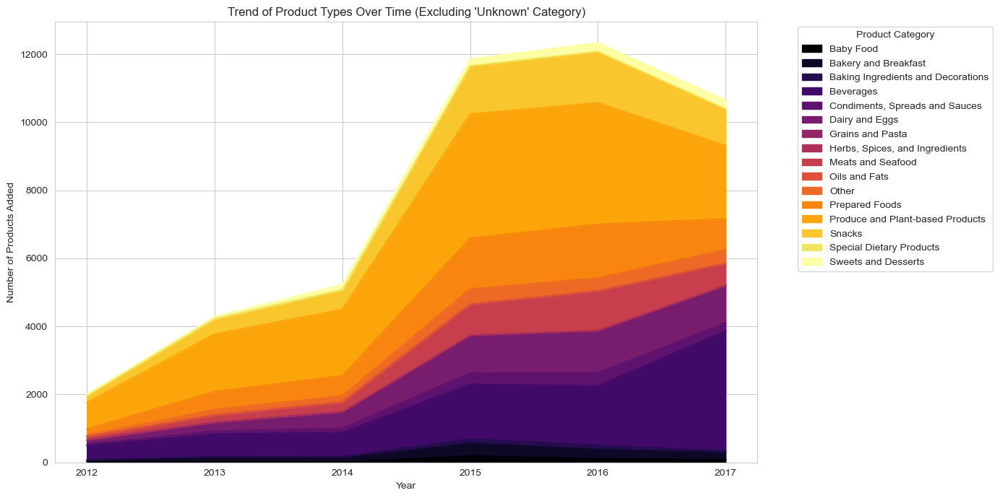

In [104]:
temp_df = final_encode_df_cleaned[final_encode_df_cleaned['adjusted_category'] != 'Unknown']

# Extract year from created_datetime for grouping & exclude Unknown category
temp_df.loc[:,['year']] = temp_df['created_datetime'].apply(lambda x: x.year)

# Group by year and main category, counting the number of products
product_type_trends = temp_df.groupby(['year', 'adjusted_category']).size().unstack(fill_value=0)

# Plot the results using the 'inferno' colormap
plt.figure(figsize=(14, 7))
product_type_trends.plot(kind='area', stacked=True, colormap='inferno', ax=plt.gca())
plt.title("Trend of Product Types Over Time (Excluding 'Unknown' Category)")
plt.xlabel('Year')
plt.ylabel('Number of Products Added')
plt.legend(title='Product Category', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.tight_layout()
plt.show()

 From the chart, it is evident that all categories show additions in both additions in 2014 and 2015 year. However, some categories like sweets and desserts, special dietary products, snacks, produce and Plat-based products, bakery and breakfast, and baby food show a slight dip in additional trends. Overall, the chart suggests a general increase in products offered between 2012 and 2017. However, the rate of growth varied depending on the product category.

### 2.1.2 Nutritional Content Over Time

Next, we'll explore how the nutritional content of products has evolved over time, especially macronutrients and micronutrients.

In [105]:
# Calculate annual averages for selected nutritional contents
nutritional_trends = final_encode_df_cleaned.groupby('year')[['fat_100g', 'carbohydrates_100g', 'proteins_100g']].mean().reset_index()

fig = go.Figure()

# Add traces for each macronutrient with a custom name in the legend
fig.add_trace(go.Scatter(x=nutritional_trends['year'], y=nutritional_trends['fat_100g'],
                         mode='lines', name='Fat'))
fig.add_trace(go.Scatter(x=nutritional_trends['year'], y=nutritional_trends['carbohydrates_100g'],
                         mode='lines', name='Carbohydrates'))
fig.add_trace(go.Scatter(x=nutritional_trends['year'], y=nutritional_trends['proteins_100g'],
                         mode='lines', name='Proteins'))

# Update layout with appropriate titles and size
fig.update_layout(title='Trend of Macronutrient Content Over Time',
                  xaxis_title='Year',
                  yaxis_title='Average per 100g',
                  legend_title='Nutrient',
                  template='plotly_white')

# Display the figure
fig.show()

The chart shows the average amount of fat, carbohydrates, and protein in a 100-gram product serving from 2012 to 2017. The chart shows that content appears to be the most variable among these 3 nutrients. It started high in 2012, then dipped slightly in 2014 before increasing again in 2015 and 2016. The fat and proteins show a similar pattern to carbohydrates but fluctuate less. The overall range of macronutrients appears stable from 2012 to 2016. However, slight increases in carbohydrates and decreases in fat and protein in 2017 indicate some changes in the product's composition.

In [106]:
# Calculate annual averages for selected micronutrients
nutritional_trends = final_encode_df_cleaned.groupby('year')[['vitamin_a_100g', 'vitamin_c_100g', 'calcium_100g', 'iron_100g']].mean().reset_index()

# Create the figure object
fig = go.Figure()

# Add traces for each micronutrient with a custom name in the legend
fig.add_trace(go.Scatter(x=nutritional_trends['year'], y=nutritional_trends['vitamin_a_100g'],
                         mode='lines', name='Vitamin A'))
fig.add_trace(go.Scatter(x=nutritional_trends['year'], y=nutritional_trends['vitamin_c_100g'],
                         mode='lines', name='Vitamin C'))
fig.add_trace(go.Scatter(x=nutritional_trends['year'], y=nutritional_trends['calcium_100g'],
                         mode='lines', name='Calcium'))
fig.add_trace(go.Scatter(x=nutritional_trends['year'], y=nutritional_trends['iron_100g'],
                         mode='lines', name='Iron'))

# Update layout with appropriate titles and size
fig.update_layout(title='Trend of Micronutrient Content Over Time',
                  xaxis_title='Year',
                  yaxis_title='Average per 100g',
                  legend_title='Micronutrient',
                  template='plotly_white',
                  width=1400,
                  height=600)

# Display the figure
fig.show()

The chart depicts the trend of micronutrient content in food items over a five-year period, likely from 2012 to 2017. Overall, similar to macronutrients, the average micronutrient content appears to be consistent throughout the period, except for 2017. In 2017, all nutrients show an upward trend, especially calcium, which increases from less than 0.01g to more than 0.03g.

### 2.2 Correlation Analysis of Numberic Columns

In this section, we conduct a correlation analysis using heatmap to examine the relationships between various nutrients and other numberic columns present in the products under study.

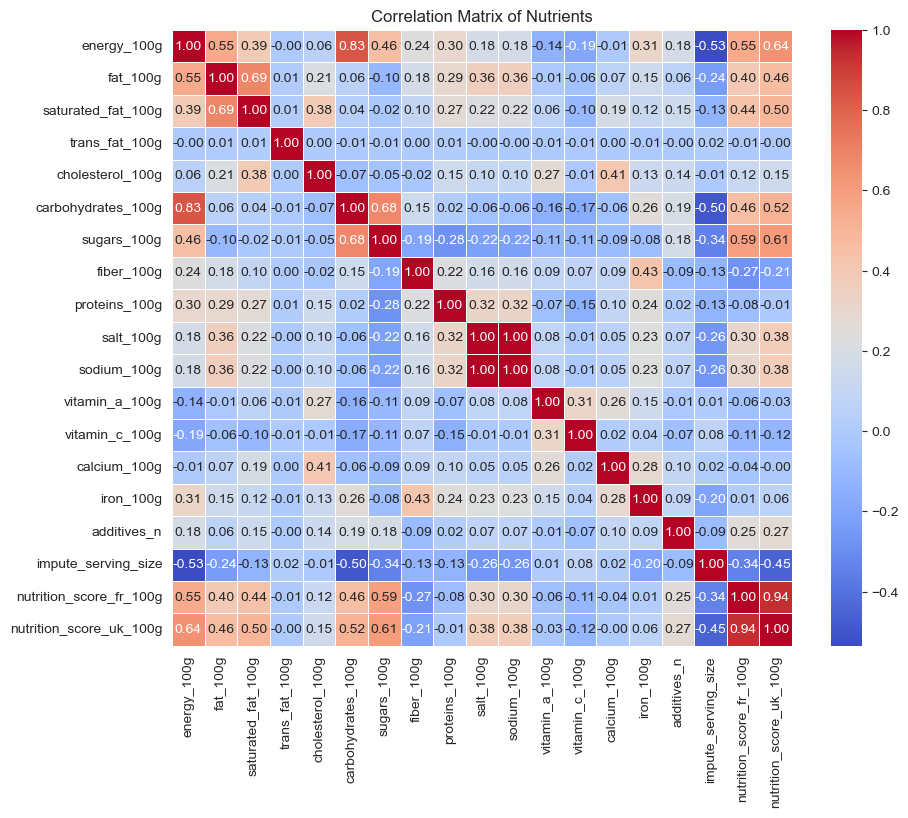

In [107]:
nutrient_columns = ['energy_100g','fat_100g', 'saturated_fat_100g', 'trans_fat_100g', 'cholesterol_100g', 'carbohydrates_100g', 'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g', 'sodium_100g', 'vitamin_a_100g', 'vitamin_c_100g', 'calcium_100g', 'iron_100g']

numberic_columns = nutrient_columns + ['additives_n', 'impute_serving_size', 'nutrition_score_fr_100g', 'nutrition_score_uk_100g']

nutrient_data = final_encode_df_cleaned[numberic_columns]

# Calculating the correlation matrix
correlation_matrix = nutrient_data.corr()

# Plotting the correlation matrix
plt.figure(figsize=(10, 8))
sns.heatmap(correlation_matrix, annot=True, cmap='coolwarm', fmt=".2f", linewidths=.5)
plt.title('Correlation Matrix of Nutrients')
plt.show()

***Key Correlations***

***Nutritional Correlation***

**Energy and Fat:**
There is a strong positive correlation between energy content and fat content, which is expected as fat has a high caloric density. This suggests that foods with higher fat content tend to have higher energy content.

**Energy and Carbohydrates:**
Similarly, there is a strong positive correlation between energy content and carbohydrates. This indicates that foods rich in carbohydrates also contribute significantly to the energy content of the diet. Additionally, sugars, being a key component of carbohydrates, likely contribute to this correlation.

**Fiber and Iron:**
There is a moderate positive correlation between fiber and iron. This might indicate that foods high in fiber also tend to be good sources of iron, potentially pointing towards a diet rich in plant-based foods.

**Fiber and Carbohydrates:**
There is a positive correlation between fiber and carbohydrates. This likely indicates consumption of plant-based or whole grain foods rich in both fiber and carbohydrates.

**Proteins and Fat:**
There is a moderate positive correlation between proteins and fat. This might indicate a prevalence of certain types of foods like meat or dairy products that are generally higher in both nutrients.
<br>

***Other Correlation***

**Nutrition Score and Nutrients**
There is a moderate positive correlation between nutrition scores in both France and the UK with nutrients including energy, fat, saturated fat, carbohydrates, sugars, salt, and sodium. This might indicate a strong relationship between the nutritional composition of food products and their overall healthiness as assessed by nutrition scores.

**Serving Size, Energy, Carbohydrates, and Nutrition Score**
The serving size shows a strong negative correlation with energy, carbohydrates, and nutrition scores. This indicates that the higher the energy, carbohydrates, and nutrition score of a food product, the lower the serving size. This relationship suggests that foods with higher nutritional content tend to have smaller serving sizes, possibly due to higher satiety levels or more concentrated nutrients.

**Additives Number**
The number of additives, represented by "additives_n," shows less correlation with other numeric columns in the dataset. This may suggest that the presence of additives in food products is not strongly associated with their nutritional composition or other measurable attributes.

***Note: Nutrient Pairing***
Some nutrients are inherently linked due to their nature (like sodium and salt; carbohydrates and sugars; fat, saturated fat,trans fat, and cholesterol), while others may co-occur frequently in certain types of foods.

### 2.3 Assessing Nutritional Profiles

This topic would encompass discussions on various aspects of food and nutrition, including the health implications of snacks, the health benefits of high-fiber foods, the impact of additives on nutritional metrics.

### 2.3.1 Are Foods High in Fiber Healthy?

To investigate whether foods high in fiber are healthy, we'll define "high fiber" foods based on a quantile threshold, compare their nutritional profiles with low fiber foods, and utilize the nutrition scores (UK and France) as indicators of healthiness.

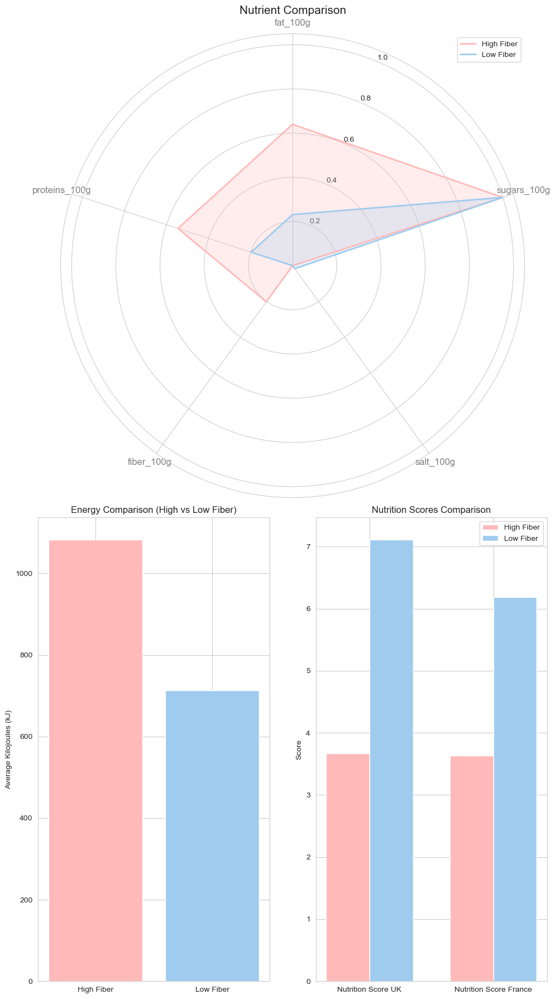

In [108]:
# Determine the threshold for high fiber using the 75th percentile
fiber_threshold = final_encode_df_cleaned['fiber_100g'].quantile(0.75)

# Define high fiber and low fiber datasets
high_fiber_foods = final_encode_df_cleaned[final_encode_df_cleaned['fiber_100g'] >= fiber_threshold]
low_fiber_foods = final_encode_df_cleaned[final_encode_df_cleaned['fiber_100g'] < fiber_threshold]

# Compute mean nutritional values and nutrition scores for high and low fiber foods
comparison_metrics = ['energy_100g', 'fat_100g', 'sugars_100g', 'salt_100g', 'fiber_100g', 'proteins_100g', 'nutrition_score_fr_100g', 'nutrition_score_uk_100g']
high_fiber_nutrients = high_fiber_foods[comparison_metrics].mean()
low_fiber_nutrients = low_fiber_foods[comparison_metrics].mean()

def make_radar_chart(name, data, attributes, ax):
    angles = np.linspace(0, 2 * np.pi, len(attributes), endpoint=False).tolist()
    data = data.tolist()
    data += data[:1]  # Close the loop
    angles += angles[:1]

    ax.set_theta_offset(np.pi / 2)
    ax.set_theta_direction(-1)
    ax.set_xticks(angles[:-1])
    ax.set_xticklabels(attributes, color='grey', size=12)
    ax.fill(angles, data, alpha=0.25, color=color_map[name])
    ax.plot(angles, data, color=color_map[name], linewidth=2, linestyle='solid', label=name)
    ax.legend(loc='best')

# Define colors for the plots
color_map = {
    'High Fiber': '#ffb9b9',  # Soft red
    'Low Fiber': '#9fcbee'   # Soft blue
}

# Filter columns and normalize data
filtered_columns = ['fat_100g', 'sugars_100g', 'salt_100g', 'fiber_100g', 'proteins_100g']
data = pd.DataFrame({
    'High Fiber': high_fiber_nutrients[filtered_columns],
    'Low Fiber': low_fiber_nutrients[filtered_columns]
})
data_normalized = (data - data.min()) / (data.max() - data.min())

# Setting up the figure
fig = plt.figure(figsize=(10, 18))
gs = fig.add_gridspec(2, 1)

# Radar chart - ensure it's a polar plot
ax_radar = fig.add_subplot(gs[0, 0], polar=True)
make_radar_chart('High Fiber', data_normalized['High Fiber'], data_normalized.index, ax_radar)
make_radar_chart('Low Fiber', data_normalized['Low Fiber'], data_normalized.index, ax_radar)
ax_radar.set_title(f'Nutrient Comparison', size=15)

# Adjust the second row to have two columns
gs_lower = gs[1, 0].subgridspec(1, 2)

# Energy Comparison Bar Chart
ax_energy = fig.add_subplot(gs_lower[0, 0])
ax_energy.bar(['High Fiber', 'Low Fiber'], [high_fiber_nutrients['energy_100g'], low_fiber_nutrients['energy_100g']],
              color=[color_map['High Fiber'], color_map['Low Fiber']])
ax_energy.set_title('Energy Comparison (High vs Low Fiber)')
ax_energy.set_ylabel('Average Kilojoules (kJ)')

# Nutrition Scores Comparison Bar Chart
ax_scores = fig.add_subplot(gs_lower[0, 1])
labels = ['Nutrition Score UK', 'Nutrition Score France']
width = 0.35
x = np.arange(len(labels))

ax_scores.bar(x - width/2, [high_fiber_nutrients['nutrition_score_fr_100g'], high_fiber_nutrients['nutrition_score_uk_100g']],
              width, label='High Fiber', color=color_map['High Fiber'])
ax_scores.bar(x + width/2, [low_fiber_nutrients['nutrition_score_fr_100g'], low_fiber_nutrients['nutrition_score_uk_100g']],
              width, label='Low Fiber', color=color_map['Low Fiber'])

ax_scores.set_title('Nutrition Scores Comparison')
ax_scores.set_ylabel('Score')
ax_scores.set_xticks(x)
ax_scores.set_xticklabels(labels)
ax_scores.legend()

plt.tight_layout()
plt.show()


***Interpretation***
This radar chart shows the nutritional comparison between high-fibre and low-fibre products. Upon examination, it's evident that high-fibre foods generally exhibit higher fat content than their low-fibre counterparts. This might seem counterintuitive at first glance, but it's important to note that not all fats are equal; certain fats, like those found in nuts and seeds, benefit heart health.

Moreover, low-fiber foods display slightly elevated salt levels, with both groups showing similar sugar levels. Notably, the higher protein content in high-fibre foods suggests that these products can contribute to meeting daily protein requirements, which is crucial for overall body function.

Regarding energy content, high-fibre foods again demonstrate higher levels, which aligns with the increased fat content observation.

Moving on to the Nutrition Scores Comparison, high-fibre foods consistently exhibit notably lower (better) average scores in France and the UK. This indicates healthier nutritional profiles according to both the French and UK models.

### 2.3.2 Are Snacks Unhealthy Always?

To evaluate the health impact of snacks compared to non-snack food items, we analyzed various nutritional parameters and scores. The investigation focused on three main aspects: energy content, the combination of fat and sugars, and overall nutritional scores (both FR and UK).

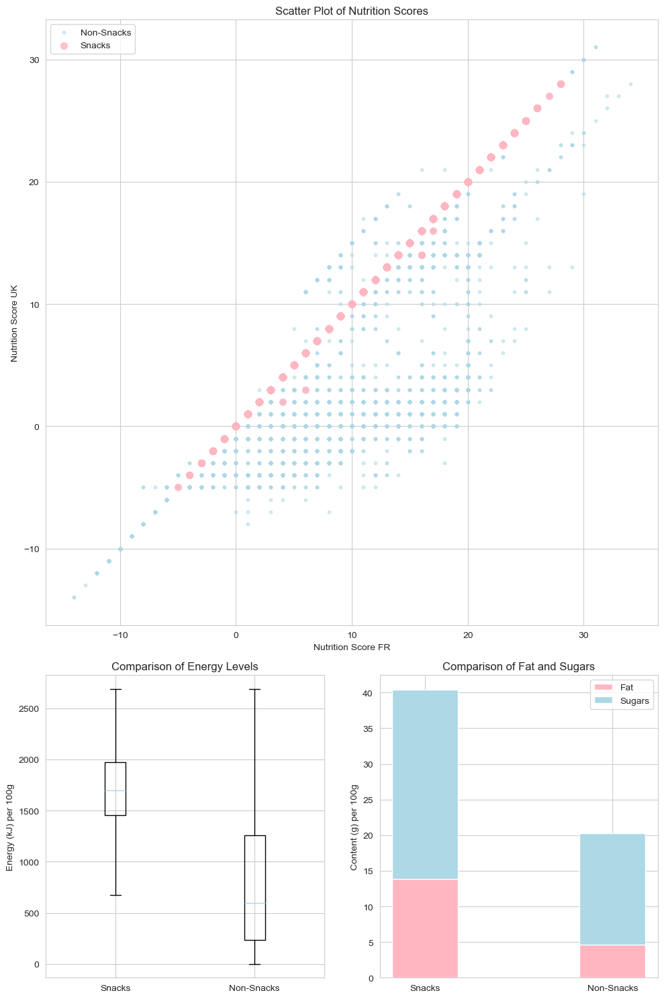

In [109]:
import matplotlib.gridspec as gridspec

snacks = final_encode_df_cleaned[final_encode_df_cleaned['adjusted_category'].str.contains("Snacks", case=False, na=False)]
non_snacks = final_encode_df_cleaned[~final_encode_df_cleaned['adjusted_category'].str.contains("Snacks", case=False, na=False)]

# Define nutrient columns and calculate means
nutrient_columns = ['energy_100g', 'fat_100g', 'sugars_100g', 'nutrition_score_fr_100g', 'nutrition_score_uk_100g']
snack_nutrients = snacks[nutrient_columns].mean()
non_snack_nutrients = non_snacks[nutrient_columns].mean()

# Setup figure and gridspec
fig = plt.figure(figsize=(10, 15))
gs = gridspec.GridSpec(2, 1, height_ratios=[2, 1])  # 2 rows, 1 column

# First subplot for Scatter Plot - occupies more space
ax0 = fig.add_subplot(gs[0])
ax0.scatter(non_snacks['nutrition_score_fr_100g'], non_snacks['nutrition_score_uk_100g'],
            color='lightblue', alpha=0.5, label='Non-Snacks', s=10)  # Light blue for non-snacks
ax0.scatter(snacks['nutrition_score_fr_100g'], snacks['nutrition_score_uk_100g'],
            color='lightpink', alpha=0.8, label='Snacks', s=50)  # Light pink for snacks
ax0.set_xlabel('Nutrition Score FR')
ax0.set_ylabel('Nutrition Score UK')
ax0.set_title('Scatter Plot of Nutrition Scores')
ax0.legend()

gs_sub = gridspec.GridSpecFromSubplotSpec(1, 2, subplot_spec=gs[1])

ax1 = fig.add_subplot(gs_sub[0])
ax1.boxplot(
    [snacks['energy_100g'].dropna(), non_snacks['energy_100g'].dropna()],
    labels=['Snacks', 'Non-Snacks'],
    showfliers=False,
    medianprops=dict(color="lightblue")  # Light blue for median line
)
ax1.set_title('Comparison of Energy Levels')
ax1.set_ylabel('Energy (kJ) per 100g')

# Third subplot for Stacked Bar Chart
ax2 = fig.add_subplot(gs_sub[1])
labels = ['Snacks', 'Non-Snacks']
fat_values = [snack_nutrients['fat_100g'], non_snack_nutrients['fat_100g']]
sugars_values = [snack_nutrients['sugars_100g'], non_snack_nutrients['sugars_100g']]
x = np.arange(len(labels))
width = 0.35
ax2.bar(x, fat_values, width, label='Fat', color='lightpink')  # Light pink for fat
ax2.bar(x, sugars_values, width, bottom=fat_values, label='Sugars', color='lightblue')  # Light blue for sugars
ax2.set_xticks(x)
ax2.set_xticklabels(labels)
ax2.set_ylabel('Content (g) per 100g')
ax2.set_title('Comparison of Fat and Sugars')
ax2.legend()

plt.tight_layout()
plt.show()

***Interpretation***
In the boxplot illustrating Energy Levels Comparison, it's apparent that snacks tend to exhibit a higher median energy level compared to non-snacks, suggesting their higher calorie density. This observation is evident from the positioning of the median line (and the overall box) for snacks, which is notably higher than that for non-snacks.

Furthermore, in the scatter plot depicting Nutritional Scores, it becomes evident that snacks typically receive poorer scores on both the French and UK nutritional scales. The concentration of points towards higher score values for snacks indicates less favorable nutritional profiles. This trend implies that snacks might generally be considered less healthy compared to non-snacks.

Lastly, the stacked bar chart unveils that snacks usually contain elevated levels of both fat and sugars. Although non-snacks also contain these elements, the proportion found in snacks is notably greater, contributing to their higher caloric content and potential negative health impact.

In conclusion, we can infer that snacks are generally less healthy than other food product categories.

### 2.3.3 Impact of Additives on Nutritional Metrics

This section explores how the presence of additives influences various nutritional metrics, shedding light on the potential implications for overall dietary health.

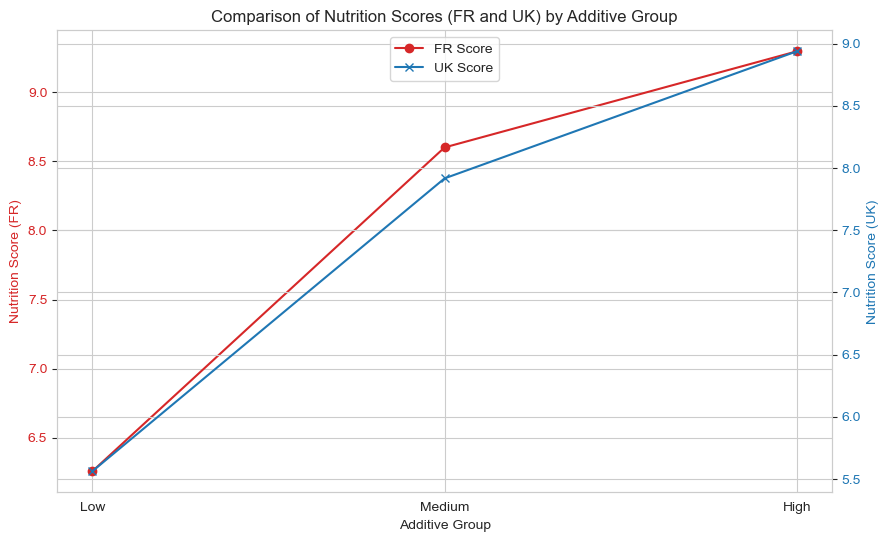

In [110]:
# Categorize additives into low, medium, and high groups
temp_df = final_encode_df_cleaned
bins = [0, 2, 5, df['additives_n'].max()]
labels = ['Low', 'Medium', 'High']
temp_df['additive_group'] = pd.cut(temp_df['additives_n'], bins=bins, labels=labels)

# Create a dataframe to summarize mean nutrition scores for each additive group
mean_scores = temp_df.groupby('additive_group', observed=False)[['nutrition_score_fr_100g', 'nutrition_score_uk_100g']].mean().reset_index()

# Create a dual-axis plot
fig, ax1 = plt.subplots(figsize=(10, 6))

# Nutrition score FR
color = 'tab:red'
ax1.set_xlabel('Additive Group')
ax1.set_ylabel('Nutrition Score (FR)', color=color)
line1 = ax1.plot(mean_scores['additive_group'], mean_scores['nutrition_score_fr_100g'], color=color, marker='o', label='FR Score')
ax1.tick_params(axis='y', labelcolor=color)

# Nutrition score UK using the same x-axis
ax2 = ax1.twinx()  # instantiate a second axes that shares the same x-axis
color = 'tab:blue'
ax2.set_ylabel('Nutrition Score (UK)', color=color)  # we already handled the x-label with ax1
line2 = ax2.plot(mean_scores['additive_group'], mean_scores['nutrition_score_uk_100g'], color=color, marker='x', label='UK Score')
ax2.tick_params(axis='y', labelcolor=color)

# Title and legend
plt.title('Comparison of Nutrition Scores (FR and UK) by Additive Group')
lines = line1 + line2
labels = [l.get_label() for l in lines]
plt.legend(lines, labels, loc='upper center')

plt.show()

***Interpretation***
This dual-axis plot facilitates a comparison between the nutritional scores in France (FR) and the UK across varying levels of additive counts:

**Low Additives:** In this category, both nutrition scores are lower, indicating healthier product options. This aligns with the understanding that minimal additives generally correlate with better nutritional quality.

**Medium Additives:** An upward trend is evident, with both nutrition scores showing an increase. This suggests a decline in nutritional quality as the number of additives rises.

**High Additives:** The peak scores observed for both metrics reinforce the notion that a high number of additives tends to correlate with less healthy food products.

Overall, this analysis highlights the nuanced relationship between additive counts and nutritional scores, emphasizing the importance of considering additive levels when evaluating the healthfulness of food products.

### 2.4 Geographical Distribution of Products and Nutritional Attributes

This section delves into the geographical distribution of food products within the dataset and examines how energy attributes vary across different regions.

In [111]:
import plotly.express as px
import pandas as pd

# Assume final_encode_df_cleaned is your DataFrame
# Calculate the product count and average energy for each country based on one-hot encoded columns
data = {
    'Country': ['Australia', 'Belgium', 'France', 'Germany', 'Italy', 'Other', 'Russia', 'Spain', 'Switzerland', 'United Kingdom', 'United States'],
    'Product_Count': [
        final_encode_df_cleaned['country_australia'].sum(),
        final_encode_df_cleaned['country_belgium'].sum(),
        final_encode_df_cleaned['country_france'].sum(),
        final_encode_df_cleaned['country_germany'].sum(),
        final_encode_df_cleaned['country_italy'].sum(),
        final_encode_df_cleaned['country_other'].sum(),
        final_encode_df_cleaned['country_russia'].sum(),
        final_encode_df_cleaned['country_spain'].sum(),
        final_encode_df_cleaned['country_switzerland'].sum(),
        final_encode_df_cleaned['country_united_kingdom'].sum(),
        final_encode_df_cleaned['country_united_states'].sum()
    ],
    'Average_Energy': [
        final_encode_df_cleaned[final_encode_df_cleaned['country_australia'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_belgium'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_france'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_germany'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_italy'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_other'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_russia'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_spain'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_switzerland'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_united_kingdom'] == 1]['energy_100g'].mean(),
        final_encode_df_cleaned[final_encode_df_cleaned['country_united_states'] == 1]['energy_100g'].mean()
    ]
}

df_map = pd.DataFrame(data)

# Create the Plotly interactive map and adjust the figure size
fig = px.choropleth(df_map, locations="Country", locationmode='country names',
                    color="Average_Energy",
                    hover_name="Country", hover_data=["Product_Count", "Average_Energy"],
                    color_continuous_scale=px.colors.sequential.Plasma,
                    title='Global Distribution of Products and Average Energy Content')

# Adjust the size of the figure: width and height in pixels
fig.update_layout(width=1200, height=800)

fig.show()


***Interpretation***
The map reveals that the majority of food products in the dataset originate from the United States, followed closely by France, indicating that these markets are primary focuses for the Open Food Organization.

Analyzing the average energy content per 100g provides further insights into dietary cultures and food processing trends across different countries. Italy and Germany exhibit the highest average energy content, suggesting a prevalence of high-calorie foods, possibly including processed and convenience foods. Similarly, the United Kingdom and the United States also show relatively high energy values, supporting the notion of diets that incorporate energy-dense food items. Conversely, France and Spain display lower average energy contents, potentially indicating a focus on fresher and less processed food items. Russia and Australia have the lowest average energy contents, which may reflect stringent food regulations or a cultural preference for lower-calorie diets.

### Part 3 Modelling

A machine learning model is a mathematical representation of the output of a training process. It's a computer program that uses previous data or experience to recognize patterns and behaviors. The learning algorithm finds patterns in the training data and outputs a model that captures those patterns and makes predictions on new data.

In this section, as we focus on clustering analysis, we will explore several clustering techniques:

1. **K-Means**
2. **Fuzzy C-Means**
3. **DBSCAN** (Density-Based Spatial Clustering of Applications with Noise)
4. **OPTICS** (Ordering Points To Identify the Clustering Structure)

### 3.1 Preparation Before Modelling

Before modeling, we'll prepare the dataset by dropping unnecessary columns and defining feature sets. Here are the feature sets we'll consider:

Feature Sets:
1. **Feature Set 1:** Basic nutritional information.
2. **Feature Set 2:** All Nutrition Columns + Nutritional Score.
3. **Feature Set 3:** All Nutrition Columns + Encoded Additive Columns.
4. **Feature Set 4:** All Nutrition Columns + Encoded Country Columns.
5. **Feature Set 5:** All Nutrition Columns + Encoded Category Columns.
6. **Feature Set 6:** All Nutrition Columns + Impute Serving Size

**Note:** Due to the limitation of the nature of assignment, we will solely focus on the data with valid category (excluding 'Unknown' category).

In [112]:
# Drop unnecessary columns
data = final_encode_df_cleaned.drop(['product_name', 'brands', 'main_category_en', 'countries_en', 'ingredients_text', 'created_datetime', 'additive_group', 'year', 'serving_size_g', 'additives_tags_cleaned', 'total_components', 'adjusted_category'], axis=1)

In [113]:
data.columns

Index(['additives_n', 'energy_100g', 'fat_100g', 'saturated_fat_100g',
       'trans_fat_100g', 'cholesterol_100g', 'carbohydrates_100g',
       'sugars_100g', 'fiber_100g', 'proteins_100g', 'salt_100g',
       'sodium_100g', 'vitamin_a_100g', 'vitamin_c_100g', 'calcium_100g',
       'iron_100g', 'nutrition_score_fr_100g', 'nutrition_score_uk_100g',
       'category_baby_food', 'category_bakery_and_breakfast',
       'category_baking_ingredients_and_decorations', 'category_beverages',
       'category_condiments_spreads_and_sauces', 'category_dairy_and_eggs',
       'category_grains_and_pasta', 'category_herbs_spices_and_ingredients',
       'category_meats_and_seafood', 'category_oils_and_fats',
       'category_other', 'category_prepared_foods',
       'category_produce_and_plant-based_products', 'category_snacks',
       'category_special_dietary_products', 'category_sweets_and_desserts',
       'category_unknown', 'country_australia', 'country_belgium',
       'country_france', 'co

In [114]:
# Define Feature Sets
nutritional_columns = [
    'energy_100g', 'fat_100g', 'saturated_fat_100g', 'trans_fat_100g',
    'cholesterol_100g', 'carbohydrates_100g', 'sugars_100g', 'fiber_100g',
    'proteins_100g', 'salt_100g', 'sodium_100g', 'vitamin_a_100g',
    'vitamin_c_100g', 'calcium_100g', 'iron_100g'
]

nutritional_score_columns = ['nutrition_score_fr_100g', 'nutrition_score_uk_100g']

additive_columns = [
    'additive_other', 'additive_e101', 'additive_e101i', 'additive_e300', 'additive_e322', 'additive_e322i', 'additive_e330', 'additive_e375', 'additive_e412', 'additive_e415', 'additive_e440'
]

country_columns = [
    'country_australia', 'country_belgium', 'country_france', 'country_germany', 'country_italy', 'country_other', 'country_russia', 'country_spain', 'country_switzerland', 'country_united_kingdom', 'country_united_states'
]

category_columns = [
    'category_baby_food', 'category_bakery_and_breakfast', 'category_baking_ingredients_and_decorations', 'category_beverages', 'category_condiments_spreads_and_sauces', 'category_dairy_and_eggs',
    'category_grains_and_pasta', 'category_herbs_spices_and_ingredients', 'category_meats_and_seafood', 'category_oils_and_fats', 'category_other', 'category_prepared_foods', 'category_produce_and_plant-based_products', 'category_snacks', 'category_special_dietary_products', 'category_sweets_and_desserts'
]

additives_count_column = ['additives_n']

serving_size_column = ['impute_serving_size']

data_unknown = data[data['category_unknown'] == 1]
data_known = data[data['category_unknown'] == 0]

In [115]:
# Define all columns in each feature set considering the above corrections
feature_sets = {
    'Set 1': data_known[nutritional_columns],
    'Set 2': data_known[nutritional_columns + nutritional_score_columns],
    'Set 3': data_known[nutritional_columns + additives_count_column + additive_columns],
    'Set 4': data_known[nutritional_columns + country_columns],
    'Set 5': data_known[nutritional_columns + category_columns],
    'Set 6': data_known[nutritional_columns + serving_size_column]
}

### 3.1.1 Choosing the Scaler

Before applying any scaling technique, it's important to assess the skewness of the data. Skewness can affect the performance of different scalers. We will access the data distribution through visualisation.

**Selecting the Scaler:**
   - **Standard Scaler (Z-score normalization):** If the data is normally distributed or has minimal skewness, we'll consider using the Standard Scaler.
   - **MinMax Scaler:** If the data is bounded and not heavily skewed, we'll consider using the MinMax Scaler, which scales the data to a fixed range (usually between 0 and 1).
   - **Robust Scaler:** If the data contains outliers or is heavily skewed, we'll consider using the Robust Scaler, which is less affected by outliers.

Based on the skewness analysis, we'll choose the scaler that is most appropriate for our dataset to ensure optimal scaling performance.

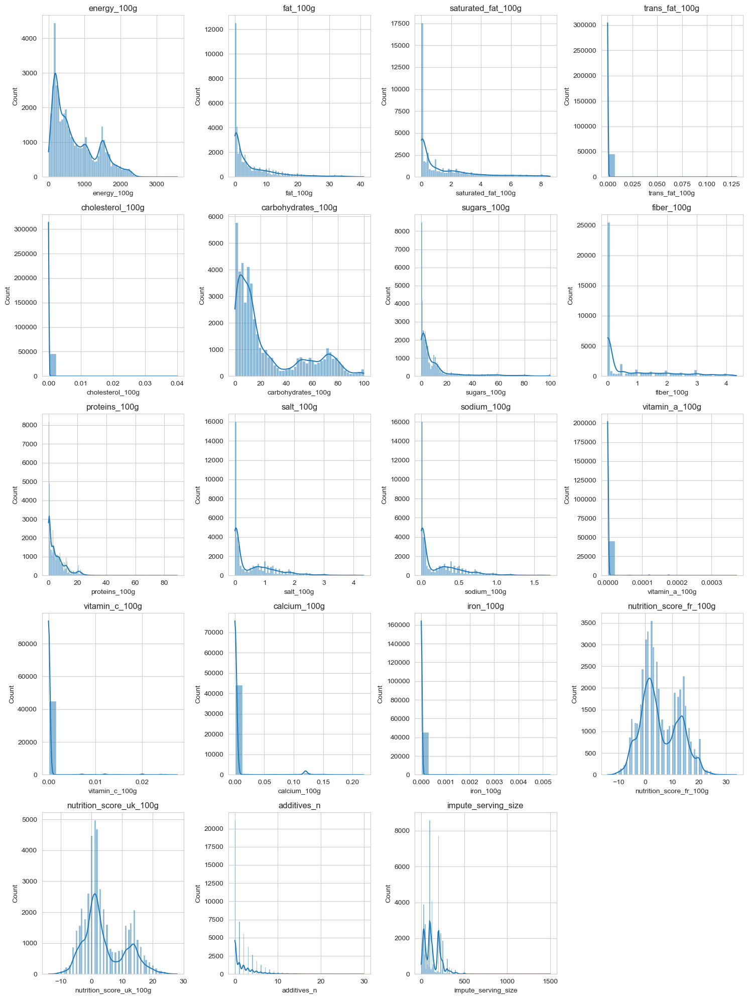

In [116]:
import math

# Define numerical columns to check the skewness of data
numerical_cols = nutritional_columns + nutritional_score_columns + additives_count_column + serving_size_column

num_cols = len(numerical_cols)

num_rows = math.ceil(num_cols / 4)
fig_width = min(num_cols * 4, 15)
fig_height = num_rows * 4

fig, axes = plt.subplots(nrows=num_rows, ncols=4, figsize=(fig_width, fig_height))
axes = axes.flatten()

for i, col in enumerate(numerical_cols):
    sns.histplot(data_known[col], ax=axes[i], kde=True)
    axes[i].set_title(col)

for j in range(i + 1, num_rows * 4):
    axes[j].axis('off')

plt.tight_layout()
plt.show()

Looking at the histogram of the dataset features, we can see many variables show right-skewed distributions and a few show quite extreme outliers, especially in nutritional columns like `fat_100g`, `saturated_fat_100g`, and `carbohydrates_100g`. These characteristics suggest that using `StandardScaler` might not be the best approach due to the influence of outliers and non-normal distributions.

Thus, for the Scaler selection, we will prefer to use `RobustScaler` for Nutritional columns as it uses the median and the interquartile range for scaling, thus not being as influenced by outliers. It can help to mitigate the effect of the different ranges of your features without distorting the distances among the points in dataset as much as the `MinMaxScaler` or `StandardScaler` would.

Then for Nutrition Score columns, we will apply `MinMaxScaler` as they show some skewed but not as heavy as Nutritional columns.

### 3.2 K-Means

K-means is a popular unsupervised machine learning algorithm that groups objects into clusters based on their characteristics. It's also known as a centroid-based or distance-based algorithm. The algorithm's goal is to minimize the sum of squared distances between each data point and its closest centroid. A point is considered to be in a particular cluster if it is closer to that cluster's centroid than any other centroid.

#### Hyperparameters

1. **n_clusters**: Specifies the number of clusters to form. This hyperparameter is crucial, as it directly affects the resulting clustering.
2. **init**: Specifies the method for initializing centroids. Options include 'k-means++', which selects initial centroids in a smart way to speed up convergence, and 'random', which randomly selects data points as initial centroids.
3. **max_iter**: Maximum number of iterations the algorithm will run. It's essential for controlling the convergence of the algorithm.
4. **tol**: Tolerance to declare convergence. If the difference between the previous centroids and the new centroids is less than this value, the algorithm stops.
5. **algorithm**: Specifies the algorithm to use. Options include 'auto', 'full', 'elkan'. 'auto' selects the most appropriate algorithm based on the dataset.
6. **random_state**: Controls the random seed to reproduce the results.

#### Evaluation Metrics

1. **Inertia**: It measures the compactness of the clusters. It's the sum of squared distances of samples to their closest cluster center. Lower inertia indicates better clustering.
2. **Silhouette Score**: It measures how similar an object is to its cluster compared to other clusters. It ranges from -1 to 1, where a high value indicates that the object is well-matched to its own cluster and poorly matched to neighboring clusters.
3. **Davies–Bouldin Index**: It evaluates the clustering quality based on cluster compactness and separation. The index is calculated as the average similarity measure of each cluster with its most similar cluster, where similarity is the ratio of within-cluster distances to between-cluster distances. Lower DB index indicates better clustering, with smaller values representing better separation and higher intra-cluster similarity.
4. **Calinski-Harabasz Index**: Also known as the Variance Ratio Criterion, it measures the ratio of between-cluster dispersion to within-cluster dispersion. Higher CH index values indicate better-defined clusters.

****Reference****
[AnalyticVidhya](https://www.analyticsvidhya.com/blog/2019/08/comprehensive-guide-k-means-clustering/#:~:text=K%2Dmeans%20is%20a%20centroid,Here's%20how%20it%20works)
[TowardsDataScience](https://towardsdatascience.com/understanding-k-means-clustering-in-machine-learning-6a6e67336aa1)

In [117]:
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import MinMaxScaler, RobustScaler

class CustomPreprocessor:
    def __init__(self, nutritional_score_columns, nutritional_columns):
        self.nutritional_score_columns = nutritional_score_columns
        self.nutritional_columns = nutritional_columns
        self.scalers = {}
        self.column_transformers = None
        self.original_columns = []

    def create_preprocessor(self, data_frame):
        transformers = []
        self.columns = {}

        # Fit and define the columns for MinMaxScaler
        minmax_columns = [col for col in self.nutritional_score_columns if col in data_frame.columns]
        if minmax_columns:
            minmax_scaler = MinMaxScaler()
            minmax_scaler.fit(data_frame[minmax_columns])
            transformers.append(('minmax', minmax_scaler, minmax_columns))
            self.scalers['minmax'] = minmax_scaler
            self.columns['minmax'] = minmax_columns

        # Fit and define the columns for RobustScaler
        robust_columns = [col for col in self.nutritional_columns if col in data_frame.columns]

        # Conditional inclusion of additional columns
        if 'additives_n' in data_frame.columns:
            robust_columns.append('additives_n')
        if 'impute_serving_size' in data_frame.columns:
            robust_columns.append('impute_serving_size')

        if robust_columns:
            robust_scaler = RobustScaler()
            robust_scaler.fit(data_frame[robust_columns])
            transformers.append(('robust', robust_scaler, robust_columns))
            self.scalers['robust'] = robust_scaler
            self.columns['robust'] = robust_columns

        # Create the ColumnTransformer
        self.column_transformers = ColumnTransformer(
            transformers=transformers,
            remainder='passthrough'
        )
        return self.column_transformers

    def fit_transform(self, data_frame):
        # Store original column names for inverse transformation
        self.original_columns = data_frame.columns.tolist()
        preprocessor = self.create_preprocessor(data_frame)
        return preprocessor.fit_transform(data_frame)

    def inverse_transform(self, data_processed):
        # Create DataFrame using original columns assumed from their indices
        inverse_df = pd.DataFrame(data_processed, columns=self.original_columns)

        # Apply inverse transformation for each scaler using the specific original columns
        for key, scaler in self.scalers.items():
            columns = self.columns[key]  # these should match subsets of self.original_columns
            if columns:  # Check if the columns are actually part of the DataFrame
                inverse_df[columns] = scaler.inverse_transform(inverse_df.loc[:, columns])

        return inverse_df

    def get_feature_names_out(self):
        # Generates column names from the ColumnTransformer
        return self.column_transformers.get_feature_names_out()

### 3.2.1 Modeling and Visualization

In this section, we will conduct modeling and compare the performance across different feature sets. Our approach involves finding the optimal number of clusters (K) for each model and comparing the resulting number of clusters and cluster inertia. We will then visualize the clusters using the best model, primarily employing PCA methods. If the results are unsatisfactory, we will proceed to cluster validation using the Silhouette Score to assess whether the data is suitable for the clustering algorithm. Additionally, we will perform hyperparameter tuning to further enhance the model's performance.

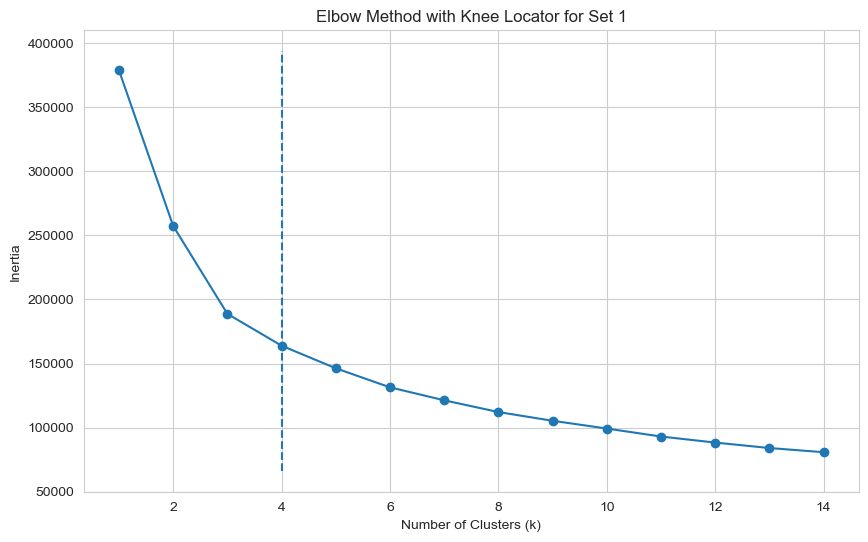

Optimal k for Set 1 found: 4


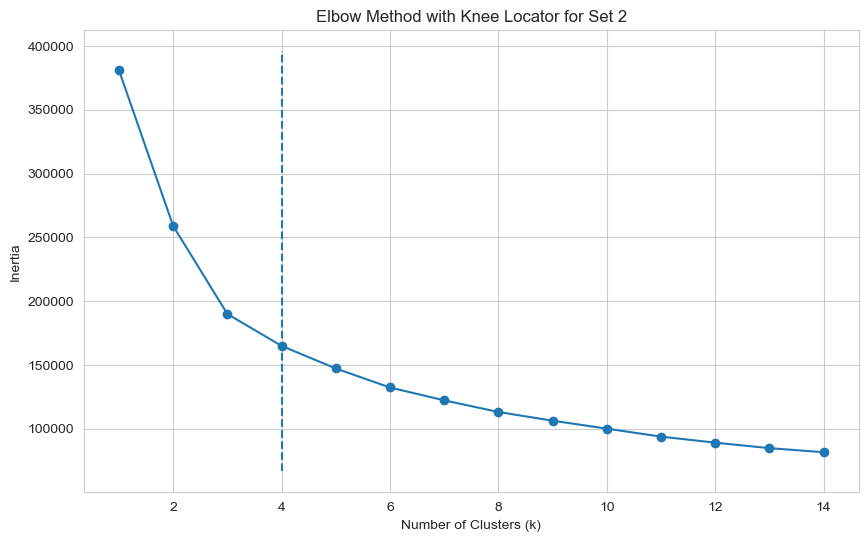

Optimal k for Set 2 found: 4


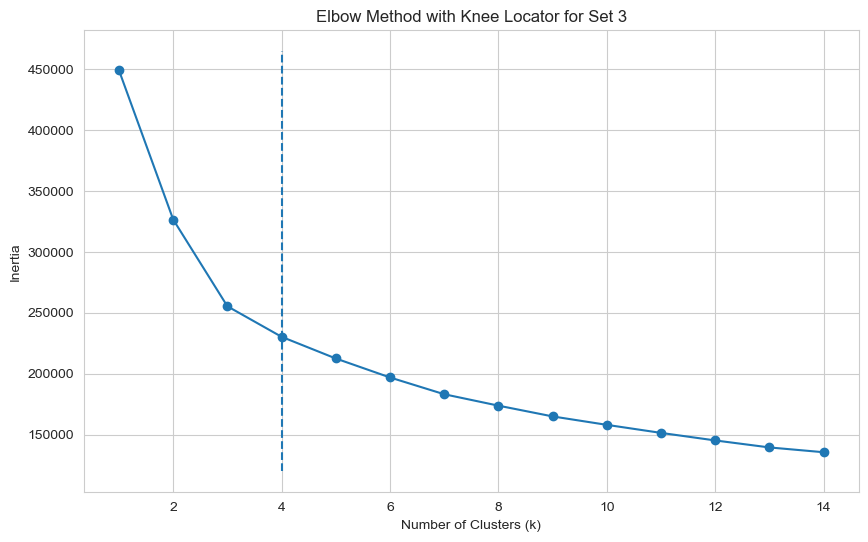

Optimal k for Set 3 found: 4


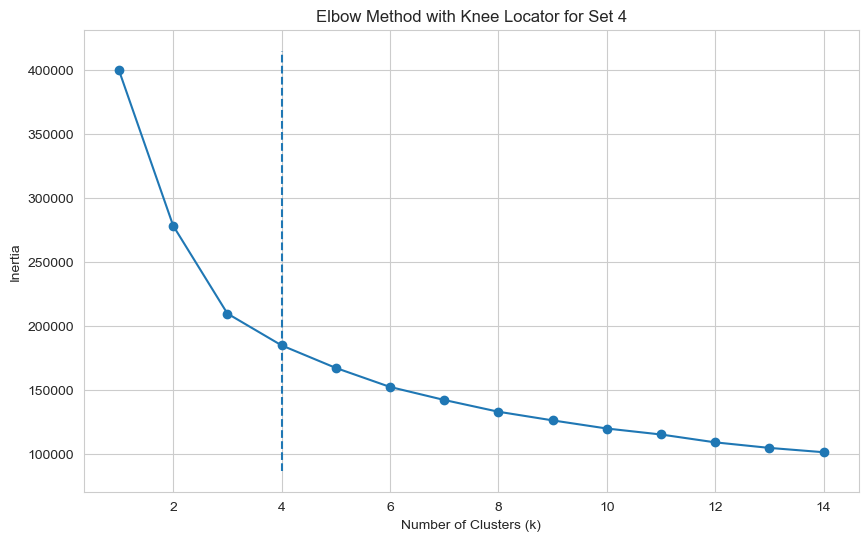

Optimal k for Set 4 found: 4


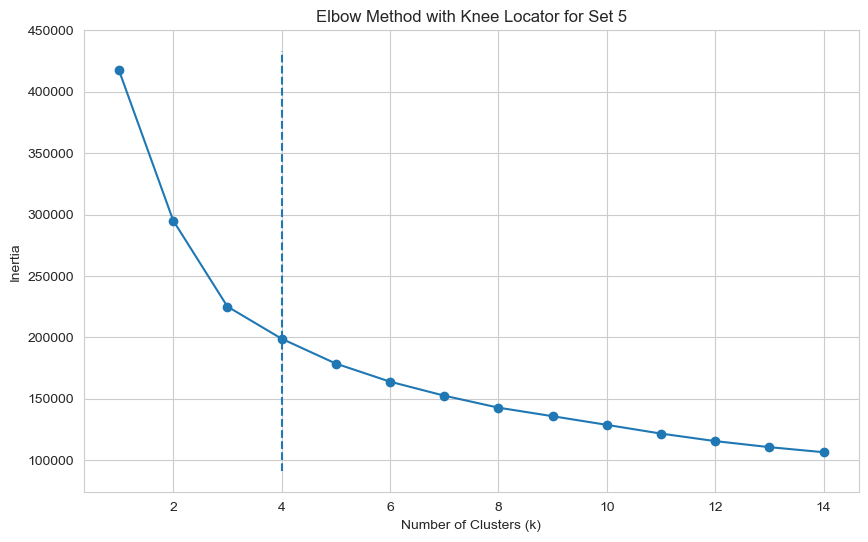

Optimal k for Set 5 found: 4


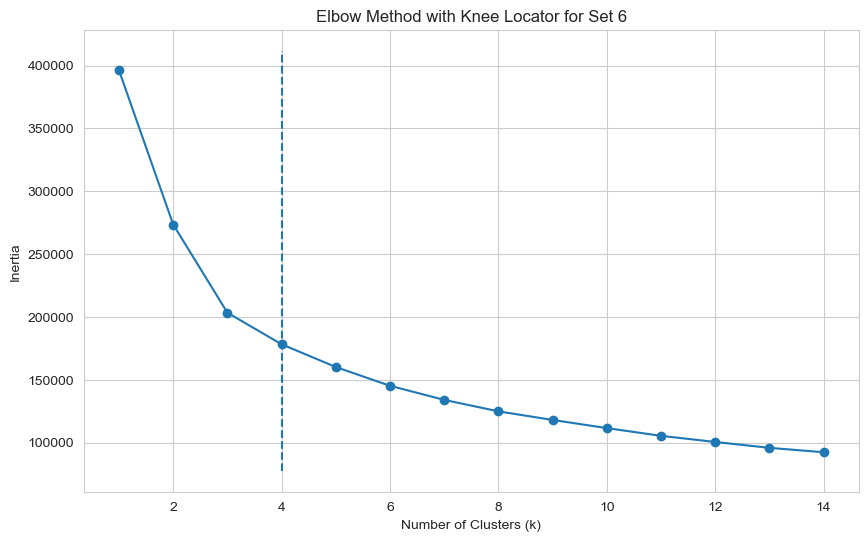

Optimal k for Set 6 found: 4


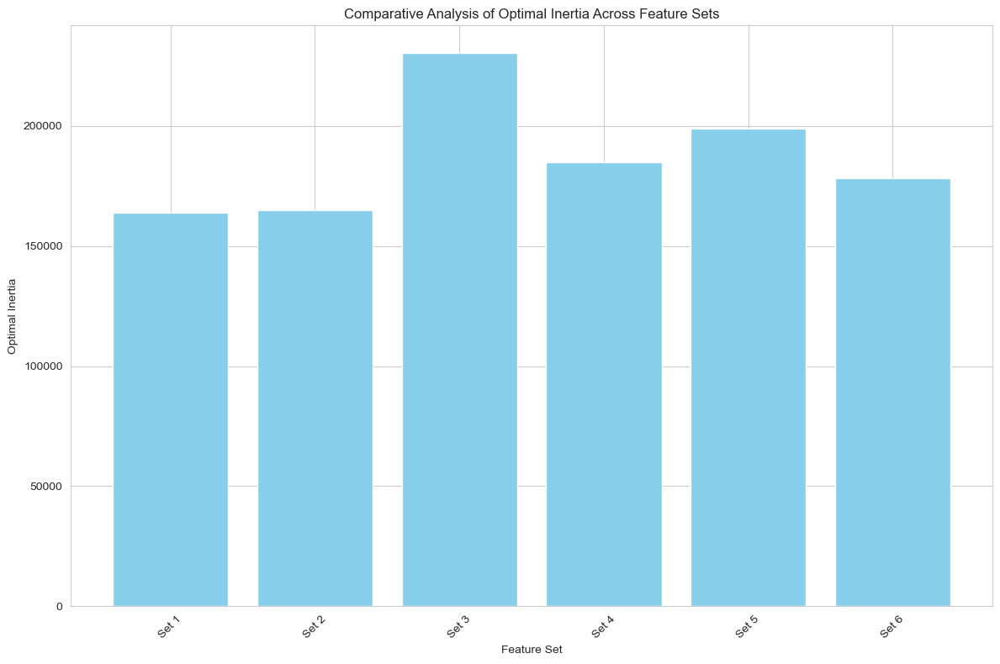

In [118]:
from sklearn.cluster import KMeans
from kneed import KneeLocator

# Dictionaries to store results for comparative analysis
set_inertia = {}
set_optimal_k = {}
optimal_inertias = {}

# Process and cluster each feature set
for name, dataset in feature_sets.items():
    preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
    data_processed = preprocessor.fit_transform(dataset)

    inertia = []
    k_values = range(1, 15)
    for k in k_values:
        kmeans = KMeans(n_clusters=k, random_state=42, n_init=10)
        kmeans.fit(data_processed)
        inertia.append(kmeans.inertia_)

    knee = KneeLocator(k_values, inertia, curve='convex', direction='decreasing')
    set_optimal_k[name] = knee.knee
    set_inertia[name] = inertia
    optimal_inertias[name] = inertia[knee.knee - 1]  # Adjust index for 0-based

    # Plotting inertia results for each feature set
    plt.figure(figsize=(10, 6))
    plt.plot(k_values, inertia, marker='o')
    plt.vlines(knee.knee, plt.ylim()[0], plt.ylim()[1], linestyles='dashed')
    plt.xlabel('Number of Clusters (k)')
    plt.ylabel('Inertia')
    plt.title(f'Elbow Method with Knee Locator for {name}')
    plt.show()
    print(f"Optimal k for {name} found:", knee.knee)

# Plot comparative inertia at optimal k for each feature set
plt.figure(figsize=(12, 8))
plt.bar(optimal_inertias.keys(), optimal_inertias.values(), color='skyblue')
plt.xlabel('Feature Set')
plt.ylabel('Optimal Inertia')
plt.title('Comparative Analysis of Optimal Inertia Across Feature Sets')
plt.xticks(rotation=45)
plt.tight_layout()
plt.show()

In [119]:
optimal_inertias

{'Set 1': 163922.1087220189,
 'Set 2': 165012.20304688872,
 'Set 3': 230345.9435759995,
 'Set 4': 184971.9345303352,
 'Set 5': 198976.68721253492,
 'Set 6': 178412.5667135039}

***Observation***

Upon observation, all models exhibit a similar optimal cluster count (4), yet they yield different inertia scores. Sets 2 through 6 consistently display higher inertia, suggesting a more dispersed dataset. In contrast, Feature **Set 1** demonstrates superior clustering performance in terms of compactness.

In [120]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

def visualize_with_pca_and_export(data, labels, title, csv_filename):
    # Perform PCA
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(data)
    pca_df = pd.DataFrame(data=pca_result, columns=['PCA1', 'PCA2'])
    pca_df['Cluster'] = labels

    # Plot the results
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(pca_df['PCA1'], pca_df['PCA2'], c=pca_df['Cluster'], cmap='viridis', alpha=0.7, edgecolors='k')
    plt.colorbar(scatter)
    plt.title(title)
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.grid(True)
    plt.show()

    # Export to CSV
    pca_df.to_csv(csv_filename, index=False)
    print(f"Data exported to {csv_filename}")

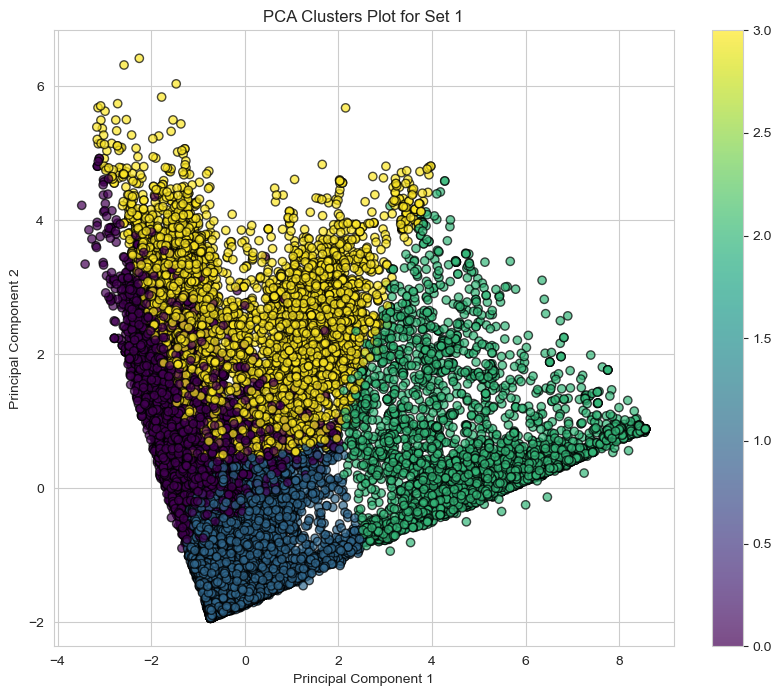

Data exported to pca_kmeans_set1_pretune.csv


In [121]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
kmeans = KMeans(n_clusters=set_optimal_k['Set 1'], random_state=42)
labels = kmeans.fit_predict(data_processed)
visualize_with_pca_and_export(data_processed, labels, 'PCA Clusters Plot for Set 1', 'pca_kmeans_set1_pretune.csv')

From the clusters visualisation of PCA, we can found that:

- **Dense Line:** A dense vertical accumulation of points around lower values of Principal Component 1 and 2 suggests a concentration of data points with similar values for this component, likely capturing significant variance within the dataset.
- **Spread Out Clusters:** Cluster 1 (blue), located at the bottom left and extending up to the center, alongside the transition from purple (Cluster 0) to yellow (Cluster 3), might represent products with distinct nutritional profiles. The separate green cluster on the right could indicate a unique category of products with key characteristics that starkly differ from the others.
- **Overlapping:** The color gradient represents different clusters assigned by K-Means. The visual overlap in this two-dimensional reduction may suggest that the clustering isn't well-defined in the reduced space and could be more distinguishable in higher dimensions or with alternative dimensionality reduction techniques like t-SNE.

To get a clearer picture or potentially improve the interpretation of clusters, we consider to:
- Use t-SNE and UMAP to visualise the data

In [122]:
from sklearn.manifold import TSNE

def visualize_with_tsne_and_export(data, labels, title, csv_filename):
    # Fit t-SNE to the data
    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(data)

    # Create a DataFrame for the t-SNE results and add cluster labels
    tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])
    tsne_df['Cluster'] = labels

    # Plot the results
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=tsne_df['Cluster'], cmap='viridis', edgecolor='k', alpha=0.7)
    plt.colorbar(scatter)
    plt.title(title)
    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.grid(True)
    plt.show()

    # Export to CSV
    tsne_df.to_csv(csv_filename, index=False)
    print(f"Data exported to {csv_filename}")

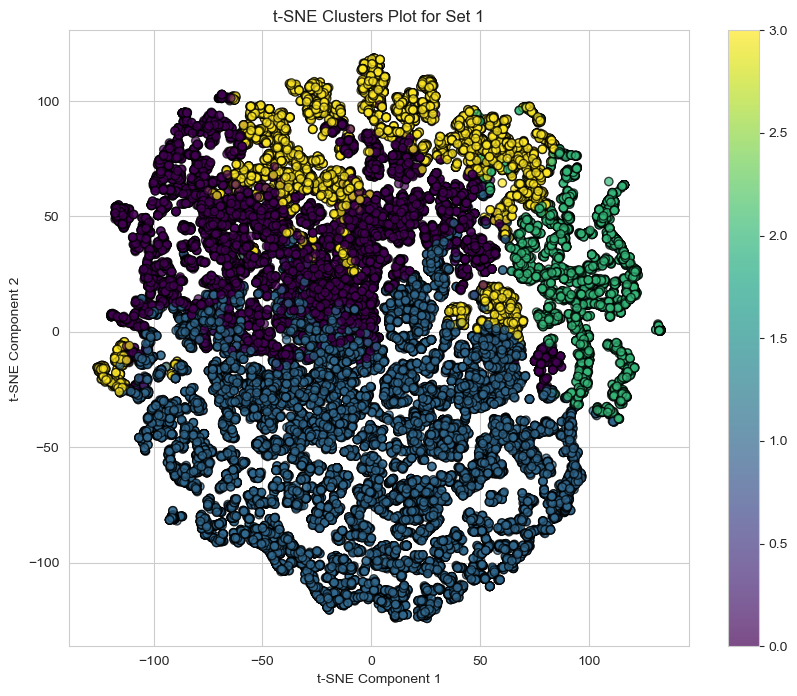

Data exported to tsne_kmeans_set1_pretune.csv


In [123]:
visualize_with_tsne_and_export(data_processed, labels, 't-SNE Clusters Plot for Set 1', 'tsne_kmeans_set1_pretune.csv')

From the t-SNE visualisation, we can found that data structure is clearer than the PCA. It is because t-SNE algorithm is particularly good at preserving local neighborhoods and can reveal clusters that aren't apparent in PCA.

***Interpretation***

**Density and Separation:** All clusters are dispersed with some overlap between them, suggesting weak group cohesion and variability within those groups or less clear distinctions in their defining characteristics. The overlaps, particularly between purple and yellow, and green meets yellow, indicate some product categories may inherently share overlapping features. This is typical for food products where categories may not be strictly exclusive in terms of nutritional content.

**Outliers:** A few points (or small groups) are isolated from the main clusters, especially in cluster 3 (yellow). These could be outliers with unique properties not shared by other data points.

In [124]:
# Access the centroids of each cluster
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])

kmeans = KMeans(n_clusters=4, random_state=42)
kmeans.fit(data_processed)
centroids = kmeans.cluster_centers_

centroids_original = preprocessor.inverse_transform(centroids)
centroids_original

,energy_100g,fat_100g,saturated_fat_100g,trans_fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g
0,841.034627,6.039021,1.529547,0.000277,0.000093,24.169161,2.997554,1.238250,11.472820,1.249664,0.492004,2.261353e-06,0.000129,0.001827,0.000061
1,354.198854,1.603456,0.554083,0.000077,0.000048,14.958828,6.478272,0.540715,2.307829,0.174432,0.068674,2.137840e-06,0.000760,0.009672,0.000013
2,1359.117279,2.675139,0.944237,0.000188,0.000017,72.201996,62.438907,0.611059,2.034412,0.160385,0.063133,1.336835e-07,0.000022,0.000586,0.000018
3,1468.668405,19.644055,4.895570,0.000225,0.000125,34.975077,11.716318,1.000242,8.062204,1.064935,0.419286,8.135268e-07,0.000052,0.001321,0.000043


***Cluster Centroids Overview***

**Cluster 0 - Moderately Balanced Foods**
- **Energy**: Moderate (841 kJ)
- **Fat**: Moderately low (6.04 g), with lower saturated fats (1.53 g)
- **Sugars**: Low (3 g)
- **Proteins**: Higher (11.47 g)
- **Fiber**: Moderate (1.24 g)
- **Salt**: High (1.25 g)
- Represents foods with a balanced macronutrient profile but higher in salt.

**Cluster 1 - Light and Low-Fat Foods**
- **Energy**: Low (354 kJ)
- **Fat**: Very low (1.6 g), with very low saturated fats (0.55 g)
- **Sugars**: Moderate (6.48 g)
- **Proteins**: Low (2.31 g)
- **Fiber**: Low (0.54 g)
- **Salt**: Very low (0.17 g)
- Characterized by low-fat, low-energy items with moderate sweetness.

**Cluster 2 - High Energy and High Sugar Foods**
- **Energy**: High (1359 kJ)
- **Fat**: Low (2.68 g), with low saturated fats (0.94 g)
- **Sugars**: Very high (62.44 g)
- **Proteins**: Low (2.03 g)
- **Fiber**: Low (0.61 g)
- **Salt**: Very low (0.16 g)
- Comprises very sweet, high-energy foods with minimal fat and protein.

**Cluster 3 - High Fat and Protein-Rich Foods**
- **Energy**: Very high (1469 kJ)
- **Fat**: High (19.64 g), with moderate saturated fats (4.90 g)
- **Sugars**: Moderate (11.72 g)
- **Proteins**: High (8.06 g)
- **Fiber**: Moderate (1 g)
- **Salt**: Moderate (1.06 g)
- Includes foods rich in fats and proteins, suitable for energy-dense diets.

### 3.2.2 Cluster Evaluation and Hyperparameter Tuning

In this section, we will evaluate our clustering model using key metrics Silhouette score, Davies-Bouldin index, and Calinski-Harabasz index. The Silhouette score measures how well data points fit within their clusters, while the Davies-Bouldin index and Calinski-Harabasz index assess cluster separation and compactness, respectively. Then, we will perform hyperparameter tuning on the model in order to enhance the performance of the model.

In [125]:
from sklearn.metrics import silhouette_score, davies_bouldin_score, calinski_harabasz_score

data_processed = preprocessor.fit_transform(feature_sets['Set 1'])

# Setting up KMeans clustering with parameters from set_optimal_k
kmeans = KMeans(n_clusters=set_optimal_k['Set 1'], random_state=42, n_init=10)
labels = kmeans.fit_predict(data_processed)

# Calculating clustering performance metrics
silhouette_avg = silhouette_score(data_processed, labels)
db_index = davies_bouldin_score(data_processed, labels)
ch_index = calinski_harabasz_score(data_processed, labels)

# Printing the metrics for quick reference
print(f"Silhouette Score for Set 1: {silhouette_avg}")
print(f"Davies-Bouldin Index for Set 1: {db_index}")
print(f"Calinski-Harabasz Index for Set 1: {ch_index}")

# Storing the results in a nested dictionary for organized access
cluster_performance = {
    "K-means": {
        "Pre-tuning": {
            'Feature Set': "Set 1",
            "Number of Clusters": set_optimal_k['Set 1'],
            "Silhouette Score": silhouette_avg,
            "Davies-Bouldin Index": db_index,
            "Calinski-Harabasz Index": ch_index
        }
    }
}

Silhouette Score for Set 1: 0.33649337193435713
Davies-Bouldin Index for Set 1: 1.370564510920517
Calinski-Harabasz Index for Set 1: 20239.057475932907


***Clustering Evaluation Metrics Interpretation***

**Silhouette Score: 0.336**
- **Interpretation:** Moderate separation between clusters. This score suggests that while clusters are not perfectly distinct, they are reasonably well-defined. This could mean that some clusters might have overlapping characteristics or that the boundaries between some clusters are not very sharp. This metric is aligned with the visualization results from the PCA plot and t-SNE plot.

**Davies-Bouldin Index: 1.370**
- **Interpretation:** Moderate clustering quality. Lower values are better (closer to 0), indicating more compact and well-separated clusters. A score of 1.370 suggests that clusters are neither tightly compact nor highly distinct.

**Calinski-Harabasz Index: 20239.057**
- **Interpretation:** This index measures the ratio of the sum of between-clusters dispersion and within-cluster dispersion for all clusters. A higher value typically indicates that the clustering is more appropriate, with well-separated clusters. In our case, even though the result shows higher values which indicate better-defined clusters, this metric can be affected by the size of the dataset. Thus, in this case, the value of 20239 may be considered low.

***Summary***
The clustering metrics provide a mixed view of the cluster definitions in the dataset. While the Calinski-Harabasz Index suggests good separation, the Silhouette Score and Davies-Bouldin Index recommend caution, indicating the need for further analysis or adjustments to the clustering approach. The metrics align with visual analyses from PCA and t-SNE, supporting the moderate separation observed.


In [126]:
# Range of hyperparameters
n_clusters_range = [4]  # Use the optimal k number get from previous section
n_init_range = [10, 15, 20, 25]
max_iter_range = [300, 400, 500]
tol_range = [1e-4, 1e-3, 1e-2]

best_inertia = float('inf')
best_params = None

# Iterate over all combinations of parameters
for n_clusters in n_clusters_range:
    for n_init in n_init_range:
        for max_iter in max_iter_range:
            for tol in tol_range:
                kmeans = KMeans(n_clusters=n_clusters, n_init=n_init, max_iter=max_iter, tol=tol, random_state=42)
                kmeans.fit(data_processed)
                inertia = kmeans.inertia_

                # Update the best parameters if the current inertia is lower
                if inertia < best_inertia:
                    best_inertia = inertia
                    best_params = {
                        'n_clusters': n_clusters,
                        'n_init': n_init,
                        'max_iter': max_iter,
                        'tol': tol
                    }

if best_params:
    print("Best Parameters:", best_params)
    print("Best Inertia:", best_inertia)
else:
    print("Failed to find suitable clustering parameters.")

Best Parameters: {'n_clusters': 4, 'n_init': 25, 'max_iter': 300, 'tol': 0.0001}
Best Inertia: 163921.9338501457


Given the reported inertia scores, it seems that increasing `n_init` from 10 to 25 and `max_iter` from its default of 300 to 400 did not significantly improve the results, despite the efforts. The default `tol` of 1e-4 remained unchanged. Practically speaking, such minor adjustments may not be statistically significant or impactful. The similarity in inertia scores suggests that the clustering results are stable and not particularly sensitive to changes in centroid initialization and maximum iteration.

We will evaluate the model with other metrics and visualise the cluster with PCA and t-SNE.

In [127]:
# Preprocessor setup and data transformation
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])

# Setting up KMeans clustering with optimized parameters
optimized_kmeans = KMeans(n_clusters=4, n_init=25, max_iter=400, random_state=42)
optimized_labels = optimized_kmeans.fit_predict(data_processed)

# Calculating clustering performance metrics for optimized parameters
silhouette_avg_opt = silhouette_score(data_processed, optimized_labels)
db_index_opt = davies_bouldin_score(data_processed, optimized_labels)
ch_index_opt = calinski_harabasz_score(data_processed, optimized_labels)

# Printing the metrics for quick reference after tuning
print(f"Optimized Silhouette Score for Set 1: {silhouette_avg_opt}")
print(f"Optimized Davies-Bouldin Index for Set 1: {db_index_opt}")
print(f"Optimized Calinski-Harabasz Index for Set 1: {ch_index_opt}")

# Updating the cluster_performance dictionary to include post-tuning results
cluster_performance["K-means"]["Post-tuning"] = {
    'Feature Set': "Set 1",
    "Number of Clusters": 4,
    "Silhouette Score": silhouette_avg_opt,
    "Davies-Bouldin Index": db_index_opt,
    "Calinski-Harabasz Index": ch_index_opt
}

Optimized Silhouette Score for Set 1: 0.3364950374447988
Optimized Davies-Bouldin Index for Set 1: 1.3705310912933761
Optimized Calinski-Harabasz Index for Set 1: 20239.07430413003


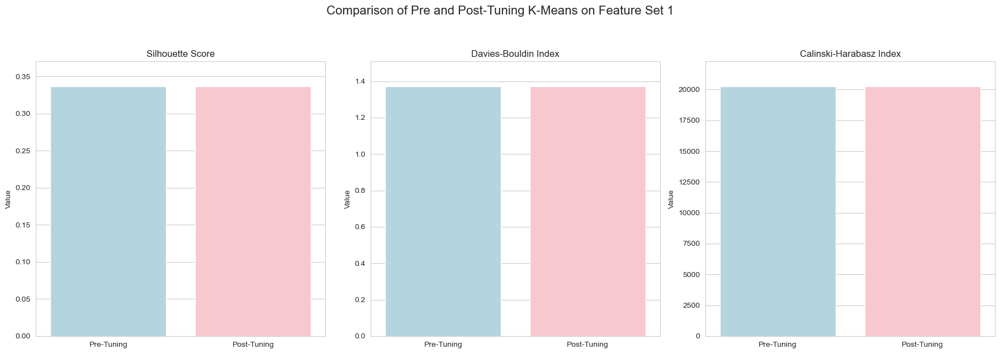

In [128]:
import matplotlib.pyplot as plt
import seaborn as sns
import pandas as pd

# Data preparation
metrics = ['Silhouette Score', 'Davies-Bouldin Index', 'Calinski-Harabasz Index']
pre_tuning_values = [
    cluster_performance['K-means']['Pre-tuning']['Silhouette Score'],
    cluster_performance['K-means']['Pre-tuning']['Davies-Bouldin Index'],
    cluster_performance['K-means']['Pre-tuning']['Calinski-Harabasz Index']
]
post_tuning_values = [
    cluster_performance['K-means']['Post-tuning']['Silhouette Score'],
    cluster_performance['K-means']['Post-tuning']['Davies-Bouldin Index'],
    cluster_performance['K-means']['Post-tuning']['Calinski-Harabasz Index']
]

# Create a DataFrame
df = pd.DataFrame({
    'Metric': metrics * 2,
    'Value': pre_tuning_values + post_tuning_values,
    'Condition': ['Pre-Tuning']*3 + ['Post-Tuning']*3
})

# Define the color palette
palette = {'Pre-Tuning': 'lightblue', 'Post-Tuning': 'pink'}

# Plotting
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))
for i, metric in enumerate(metrics):
    sns.barplot(x='Condition', y='Value', hue='Condition', data=df[df['Metric'] == metric], ax=axes[i], palette=palette, legend=False)
    axes[i].set_title(metric)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('Value')
    # Adjust each y-axis based on its own data
    axes[i].set_ylim(0, df[df['Metric'] == metric]['Value'].max() * 1.1)

# Overall title for all subplots
fig.suptitle('Comparison of Pre and Post-Tuning K-Means on Feature Set 1', fontsize=16, y=1.05)

# Improve subplot spacing
plt.tight_layout()

# Display the plot
plt.show()


From the result of metrics, we can conclude that, for our data, further tuning of `n_init` and `max_iter` in K-means might not be beneficial. The tuning resulted in almost no measurable improvement in clustering quality. This could mean that the default or previously used parameters were already near optimal, or that these hyperparameters are not sensitive enough for this particular dataset. The clustering algorithm is stable with respect to the initial conditions provided by n_init and max_iter.

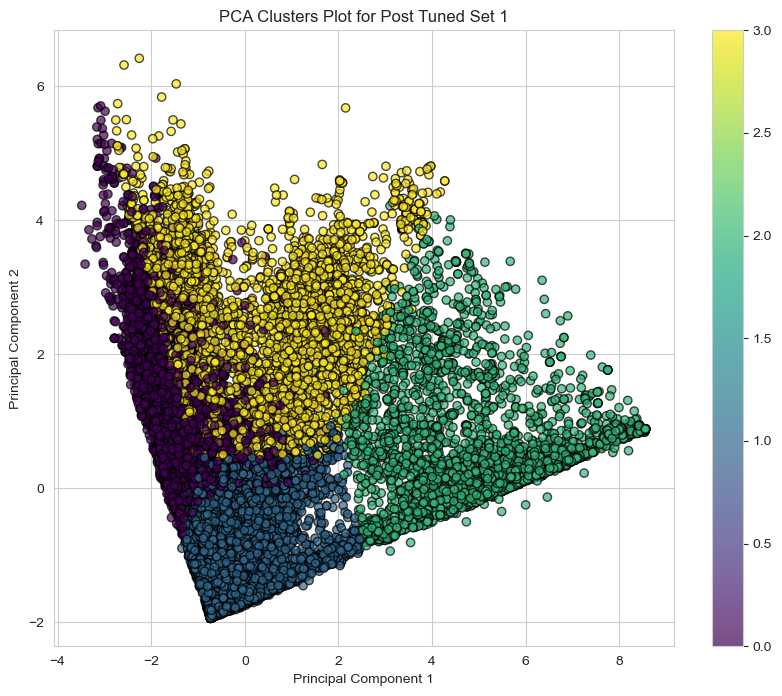

Data exported to pca_kmeans_set1_posttune.csv


In [129]:
visualize_with_pca_and_export(data_processed, optimized_labels,'PCA Clusters Plot for Post Tuned Set 1', 'pca_kmeans_set1_posttune.csv')

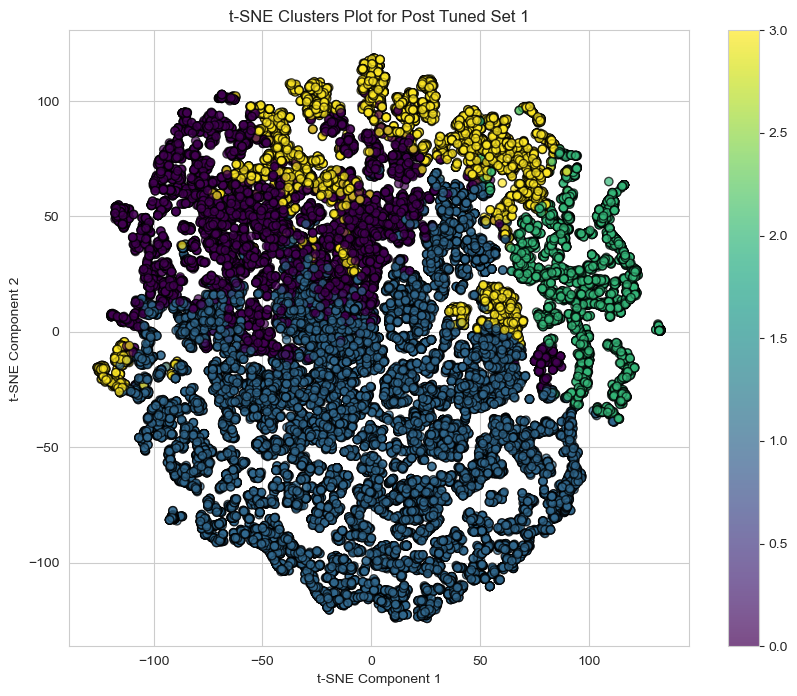

Data exported to tsne_kmeans_set1_posttune.csv


In [130]:
visualize_with_tsne_and_export(data_processed, optimized_labels, 't-SNE Clusters Plot for Post Tuned Set 1', 'tsne_kmeans_set1_posttune.csv')

From the visualisation, the post tuned clustering result almost similar with the pre tuned-cluster. This suggests that the statement that algorithm converged to a stable solution with the algorithm settings on number of cluster = 4.

In [131]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
kmeans = KMeans(n_clusters=4, n_init=25, max_iter=400, tol=0.0001, random_state=42)
kmeans.fit(data_processed)
centroids = kmeans.cluster_centers_

centroids_original = preprocessor.inverse_transform(centroids)
centroids_original

,energy_100g,fat_100g,saturated_fat_100g,trans_fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g
0,795.985334,7.237497,1.923577,0.000250,0.000115,18.341973,2.934636,0.920134,12.108194,1.531244,0.602865,2.723365e-06,0.000149,0.002069,0.000059
1,429.553777,1.829954,0.581677,0.000104,0.000047,18.026961,6.059227,0.728892,3.080566,0.199779,0.078653,1.932472e-06,0.000680,0.008686,0.000018
2,1348.064293,2.303756,0.868588,0.000192,0.000018,72.445011,62.850178,0.585697,1.955011,0.156646,0.061660,1.367521e-07,0.000023,0.000582,0.000018
3,1517.970394,19.929563,4.859222,0.000241,0.000115,37.715724,13.218261,1.068423,7.631804,0.947849,0.373189,7.872026e-07,0.000052,0.001346,0.000045


***Comparison Centroids Before and After Tuning:***
<br>

| Nutrient       | Pre-tuned (Cluster 0) | Post-tuned (Cluster 0) | Difference |
|----------------|------------------------|-------------------------|------------|
| Energy (kJ)    | Moderate (841)         | Slightly lower (796)    | -45        |
| Fat (g)        | Moderately low (6.04)  | Slightly higher (7.24)  | +1.20      |
| Saturated Fat (g) | Lower (1.53)        | Slightly higher (1.92)  | +0.39      |
| Sugars (g)     | Low (3)                | Slightly higher (2.93)  | -0.07      |
| Proteins (g)   | Higher (11.47)         | Slightly lower (12.11)  | +0.64      |
| Fiber (g)      | Moderate (1.24)        | Slightly lower (0.92)    | -0.32      |
| Salt (g)       | High (1.25)            | Lower (1.53)             | +0.28      |

| Nutrient       | Pre-tuned (Cluster 1) | Post-tuned (Cluster 1) | Difference |
|----------------|------------------------|-------------------------|------------|
| Energy (kJ)    | Low (354)              | Slightly higher (430)   | +76        |
| Fat (g)        | Very low (1.6)         | Slightly higher (1.83)  | +0.23      |
| Saturated Fat (g) | Very low (0.55)     | Slightly higher (0.58)  | +0.03      |
| Sugars (g)     | Moderate (6.48)       | Slightly higher (6.06)  | -0.42      |
| Proteins (g)   | Low (2.31)             | Slightly higher (3.08)  | +0.77      |
| Fiber (g)      | Low (0.54)             | Slightly higher (0.73)   | +0.19      |
| Salt (g)       | Very low (0.17)        | Slightly higher (0.20)   | +0.03      |

| Nutrient       | Pre-tuned (Cluster 2) | Post-tuned (Cluster 2) | Difference |
|----------------|------------------------|-------------------------|------------|
| Energy (kJ)    | High (1359)            | Slightly lower (1348)   | -11        |
| Fat (g)        | Low (2.68)             | Slightly lower (2.30)   | -0.38      |
| Saturated Fat (g) | Low (0.94)         | Lower (0.87)             | -0.07      |
| Sugars (g)     | Very high (62.44)      | Slightly lower (62.85)  | +0.41      |
| Proteins (g)   | Low (2.03)             | Slightly lower (1.96)   | -0.07      |
| Fiber (g)      | Low (0.61)             | Similar (0.59)           | -0.02      |
| Salt (g)       | Very low (0.16)        | Similar (0.16)           | 0          |

| Nutrient       | Pre-tuned (Cluster 3) | Post-tuned (Cluster 3) | Difference |
|----------------|------------------------|-------------------------|------------|
| Energy (kJ)    | Very high (1469)       | Slightly higher (1518)  | +49        |
| Fat (g)        | High (19.64)           | Slightly lower (19.93)  | -0.29      |
| Saturated Fat (g) | Moderate (4.90)     | Moderate (4.86)          | -0.04      |
| Sugars (g)     | Moderate (11.72)      | Slightly lower (13.22)  | +1.50      |
| Proteins (g)   | High (8.06)            | Slightly lower (7.63)   | -0.43      |
| Fiber (g)      | Moderate (1)           | Similar (1.07)           | +0.07      |
| Salt (g)       | Moderate (1.06)       | Slightly lower (0.95)   | -0.11      |

***Summary***
The changes in centroids between the pre-tuned and post-tuned models are generally minimal. In most cases, the differences in nutrient values are slight, indicating that the adjustments to hyperparameters did not lead to substantial shifts in the centroids of the clusters. Or in other words, the model reached the convergence.

### 3.3 Fuzzy C-Means

Fuzzy C-Means (FCM) is a clustering algorithm that extends the traditional K-Means algorithm to allow for soft cluster assignments. Unlike K-Means, where each data point belongs to only one cluster, FCM assigns membership values to each data point for every cluster, indicating the degree of belongingness. This allows FCM to handle situations where data points may belong to multiple clusters simultaneously.

#### Hyperparameters

1. **Number of Clusters (K)**: Like K-Means, FCM requires specifying the number of clusters a priori. The optimal number of clusters can be determined using techniques such as the elbow method, silhouette score, or domain knowledge.

2. **Fuzziness Coefficient (m)**: The fuzziness coefficient controls the degree of fuzziness in the cluster assignments. It determines how much each data point can belong to multiple clusters. A higher value of m results in softer cluster assignments, while a lower value leads to more deterministic assignments.

3. **Maximum Number of Iterations**: FCM iteratively updates cluster centroids and membership values until convergence. The maximum number of iterations specifies the maximum number of times this process is repeated before terminating.

4. **Termination Criterion**: FCM terminates when either the maximum number of iterations is reached or when the change in cluster centroids falls below a certain threshold.


#### Evaluation Metrics
1. **Fuzzy Partition Coefficient (FPC)**: This metric measures the fuzziness of the clustering result. It indicates the degree to which data points are allowed to belong to multiple clusters simultaneously. A higher FPC value suggests a greater degree of fuzziness in the cluster assignments.
2. **Silhouette Score**: The Silhouette Score measures the compactness and separation of clusters. It ranges from -1 to 1, with higher values indicating better clustering structures.
3. **Davies-Bouldin Index**: The Davies-Bouldin Index assesses cluster quality by measuring the average similarity between each cluster's center and its closest neighboring cluster, providing insights into both cluster compactness and separation. Lower values indicate better clustering.
4. **Calinski-Harabasz Index**: The Calinski-Harabasz Index measures the ratio of between-cluster dispersion to within-cluster dispersion for all clusters. Higher values indicate better-defined clusters, reflecting both compactness and separation.

### 3.3.1 Modeling and Visualization

Similar with K-Means clustering, we will find the optimal number of clusters (K) for each model and comparing the resulting number of clusters and Fuzzy Partition Coefficient (FCP). The FPC represents the degree of fuzziness in the cluster assignments, indicating how much each data point can belong to multiple clusters simultaneously. A higher FPC value suggests a greater degree of fuzziness, meaning that data points have more evenly distributed membership values across multiple clusters.

We will then visualize the clusters using the best model, primarily employing PCA and t-SNE methods.

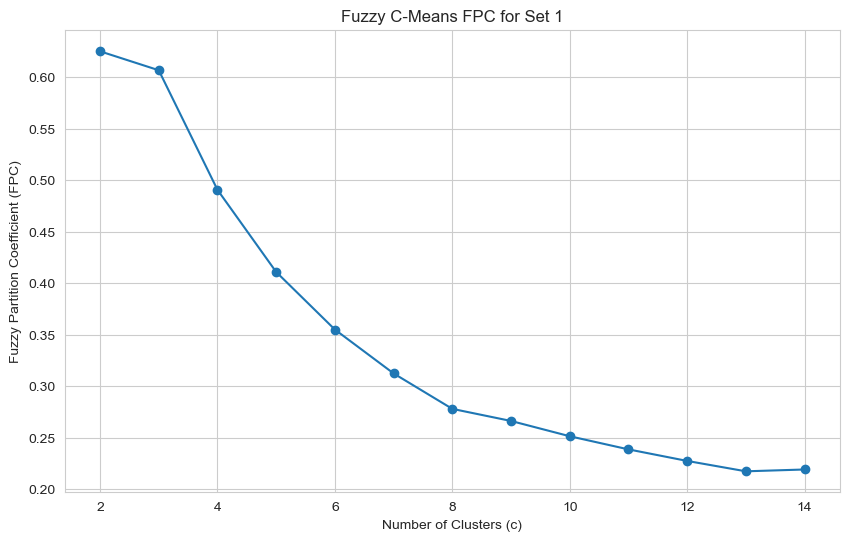

Optimal c for Set 1 found at: 2, FPC: 0.6253470255188158


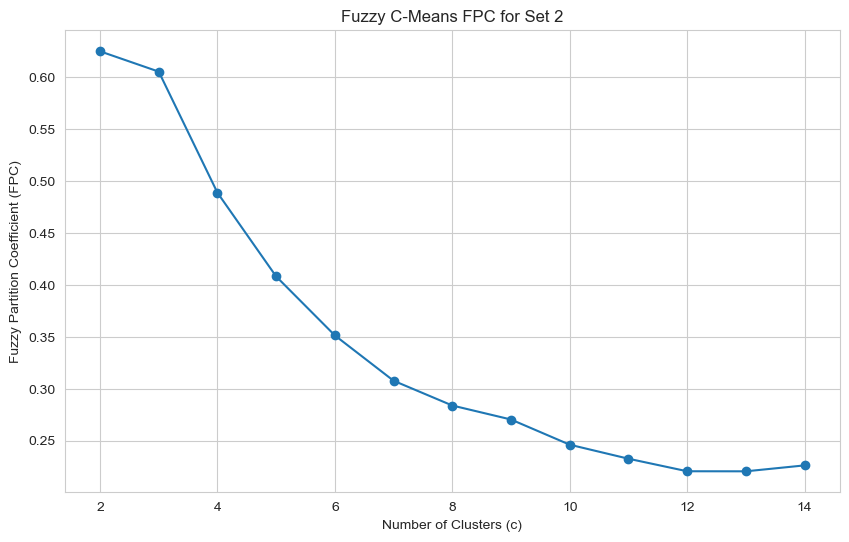

Optimal c for Set 2 found at: 2, FPC: 0.6247551815643823


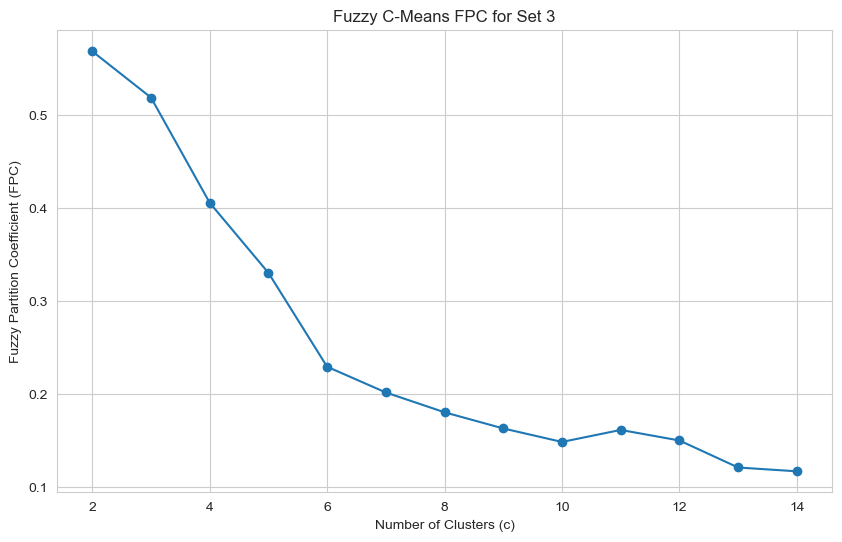

Optimal c for Set 3 found at: 2, FPC: 0.5685130559285193


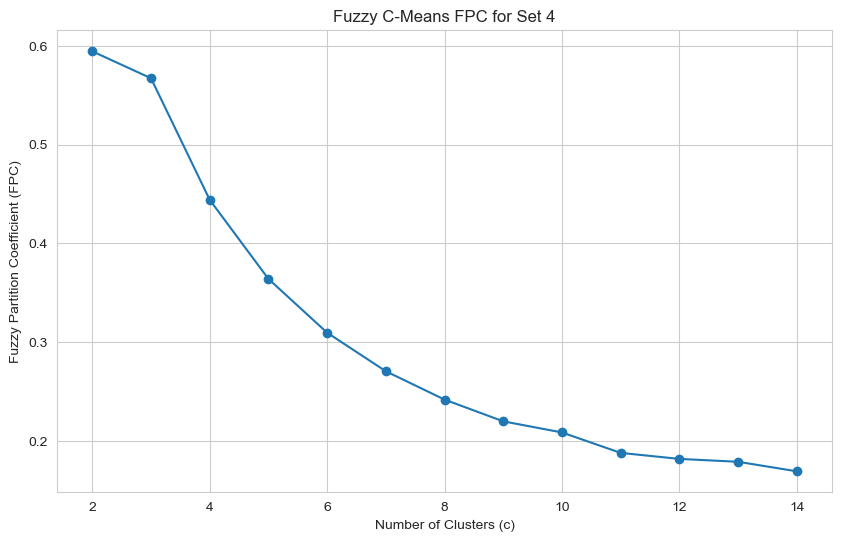

Optimal c for Set 4 found at: 2, FPC: 0.5946207836191818


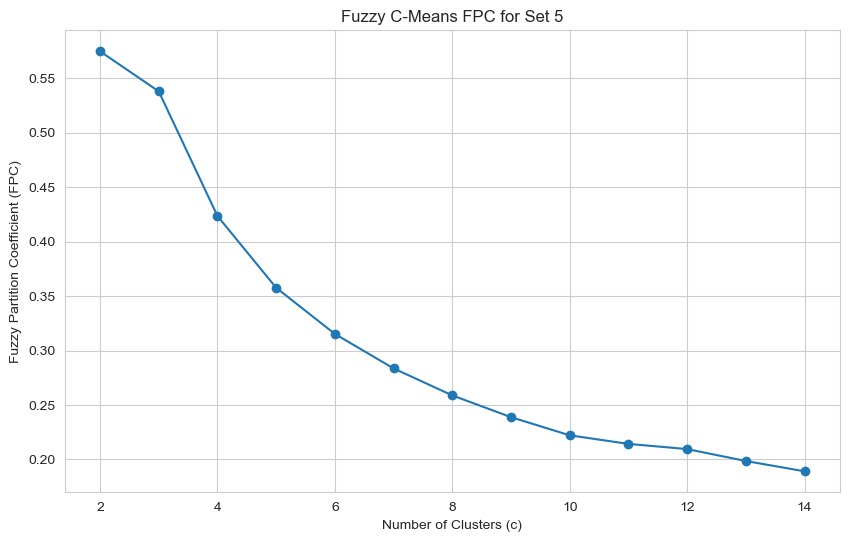

Optimal c for Set 5 found at: 2, FPC: 0.574895644350949


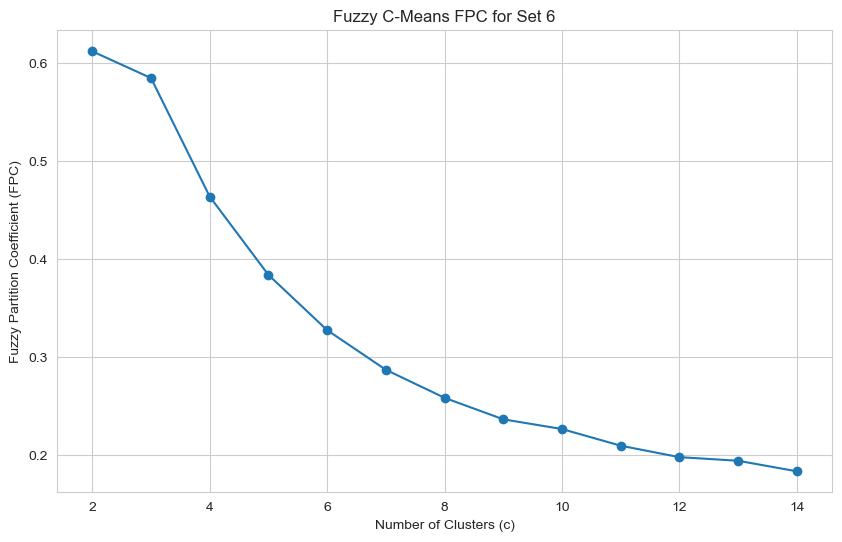

Optimal c for Set 6 found at: 2, FPC: 0.6122831141137318


In [132]:
import skfuzzy as fuzz

# Dictionaries to store results for comparative analysis
set_centers = {}
set_fpc = {}  # Fuzzy partition coefficient

for name, dataset in feature_sets.items():
    preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
    data_processed = preprocessor.fit_transform(dataset)

    fpcs = []
    range_of_clusters = range(2, 15)  # Typically start from 2 clusters for FCM

    for n_clusters in range_of_clusters:
        cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
            data_processed.T, c=n_clusters, m=2, error=0.005, maxiter=1000, init=None, seed=42
        )
        set_centers[name] = cntr
        fpcs.append(fpc)

    # Identify the number of clusters that have the highest Fuzzy partition coefficient
    optimal_n_clusters = np.argmax(fpcs) + 2  # +2 because range starts at 2
    set_fpc[name] = fpcs

    # Plotting FPC results for each feature set
    plt.figure(figsize=(10, 6))
    plt.plot(range_of_clusters, fpcs, marker='o')
    plt.xlabel('Number of Clusters (c)')
    plt.ylabel('Fuzzy Partition Coefficient (FPC)')
    plt.title(f'Fuzzy C-Means FPC for {name}')
    plt.show()
    print(f"Optimal c for {name} found at: {optimal_n_clusters}, FPC: {fpcs[optimal_n_clusters - 2]}")

In [133]:
for set_, values in set_fpc.items():
    print(f"{set_}: {values[0]}")

Set 1: 0.6253470255188158
Set 2: 0.6247551815643823
Set 3: 0.5685130559285193
Set 4: 0.5946207836191818
Set 5: 0.574895644350949
Set 6: 0.6122831141137318


***Observation***

All datasets were determined to have the optimal number of clusters as 2, and the Fuzzy Partition Coefficients (FPC) observed for each feature set suggest that while there is some distinct separation between the two clusters in each feature set, the separation isn't highly defined. These values indicate that the data points within each cluster share some similarities but are not extremely tightly grouped.

The values of Fuzzy Partition Coefficients (FPC) range between 0 and 1, with higher values indicating clearer, better-separated clusters. In the comparison of FPC,with 'Set 1' showing the highest value (0.6253), indicating the clearest separation among the clusters for that set. 'Set 3' has the lowest FPC (0.5685), indicating less clear separation. Thus, in this case, we will the best model will be Set 1 with cluster number 2 and we visualize the model to better understand and validate the clustering results.

When visualizing clusters from Fuzzy C-Means (FCM) using methods like PCA, a key difference from methods like K-Means is that FCM provides a membership matrix rather than a hard clustering label for each data point. This matrix represents the degree of membership each data point has to each cluster, which complicates direct visualization with a single label per point.

To effectively visualise the results from FCM, we can:

1. **Visualize Membership Degrees:** Plot the PCA reduced data and color the points based on their degree of membership to a particular cluster. This visualization can use gradients to represent membership strengths and might involve plotting each cluster separately or using a color blend.
2. **Use the Maximum Membership Label:** Convert the fuzzy membership matrix into hard labels by assigning each data point to the cluster for which it has the highest membership. This approach simplifies the visualization but loses some nuance of the fuzzy memberships.


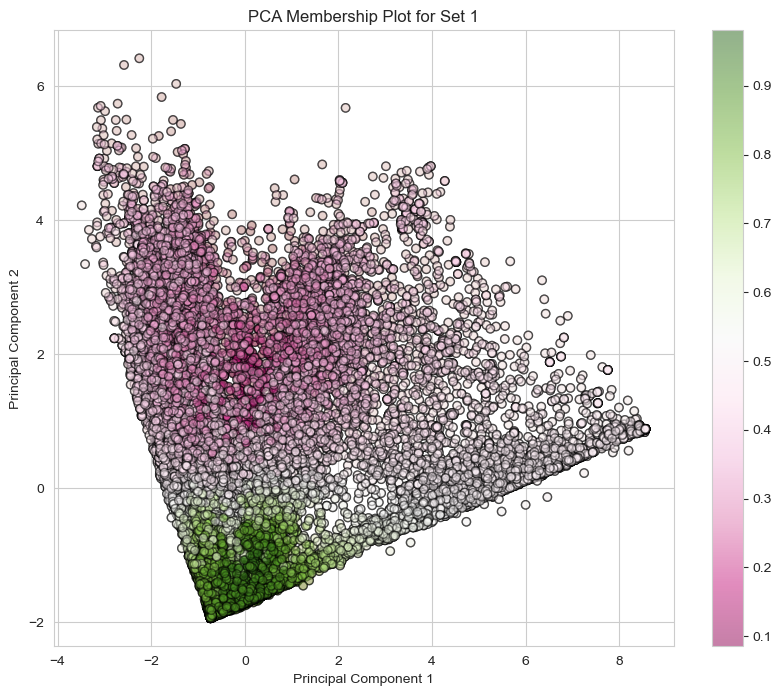

In [134]:
def visualize_with_pca_memberships(data, memberships, title='Cluster Visualization'):
    pca = PCA(n_components=2)
    reduced_data = pca.fit_transform(data)
    plt.figure(figsize=(10, 8))

    for i in range(memberships.shape[0]):
        plt.scatter(reduced_data[:, 0], reduced_data[:, 1], c=memberships[i, :], cmap='PiYG', alpha=0.5, edgecolors='k')

    plt.title(title)
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.grid(True)
    plt.colorbar()
    plt.show()

preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    data_processed.T, c=2, m=2, error=0.005, maxiter=1000, init=None, seed=42
)
labels = np.argmax(u, axis=0)

visualize_with_pca_memberships(data_processed, u, title='PCA Membership Plot for Set 1')

***PCA Membership Plot for Set 1***

This plot utilizes a gradient from green (indicating low membership) through white to pink (representing high membership). At the top and bottom of the plot, there are clearly defined green and pink clusters, indicating two distinct clusters. The deeper colors suggest that these points are strongly associated with their respective clusters.

Notably, the middle section of the plot shows some very light green and pink data points. This indicates areas where cluster membership is more mixed, with points having a significant but not exclusive association with another cluster. It suggests a gradient where affiliation shifts from one cluster to another. This is a key feature of fuzzy clustering, as it provides a degree of membership rather than strict partitioning into distinct groups, which may overlook the subtleties of the data.

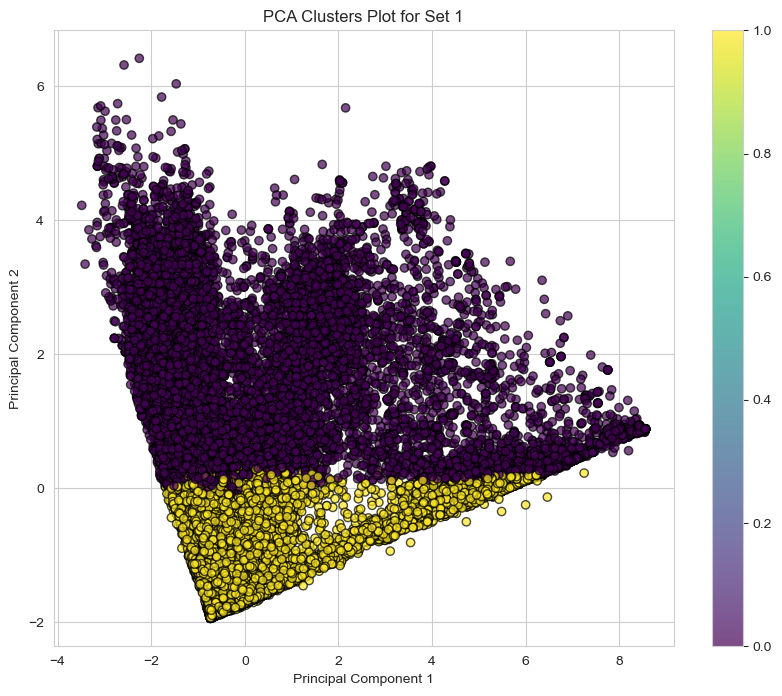

Data exported to pca_fuzzycmeans_set1_pretune.csv


In [135]:
visualize_with_pca_and_export(data_processed, labels, 'PCA Clusters Plot for Set 1', 'pca_fuzzycmeans_set1_pretune.csv')

***PCA Clusters Plot for Set 1***

This visualization uses color to indicate the membership strength of each data point to one of the clusters. The color scale ranges from yellow (low membership) to dark purple (high membership).

**Seperation:** From the visualiation, we can observe that the purple cluster ofrms a distinct group at the top left, while the yellow cluster fans out from the bottom left to the top right. The separation line between these clusters appears relatively sharp. However, there is some overlap, particularly around the center where purple and yellow mix.

**Spread:** The yellow cluster is compact, suggesting tighter cohesion among its members. In contrast, the purple cluster is more spread out, indicating a wider variety of data points grouped together.

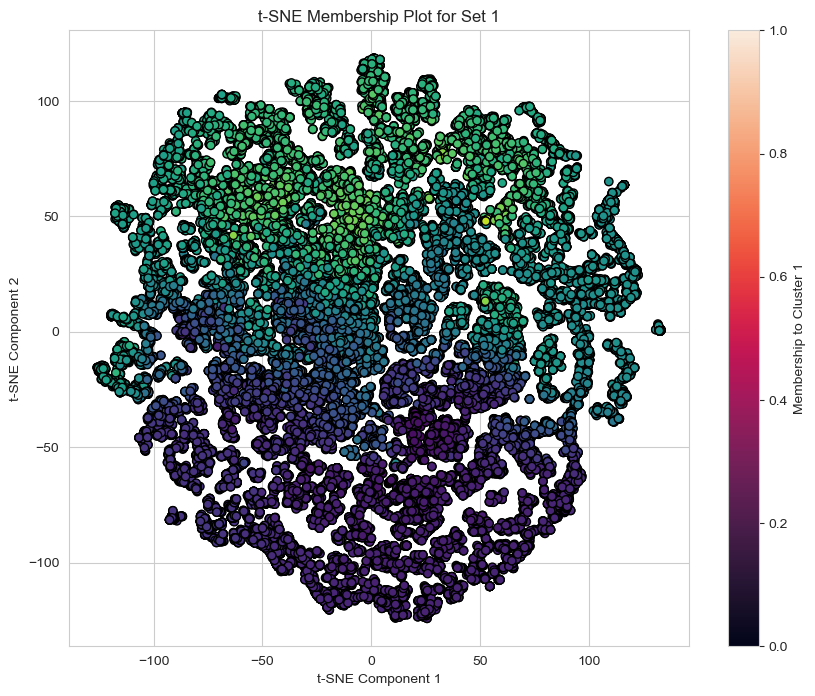

In [136]:
def visualize_with_tsne_memberships(data, memberships, title='t-SNE Membership Plot'):
    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(data)

    plt.figure(figsize=(10, 8))
    colors = plt.cm.viridis(memberships[0, :])

    scatter = plt.scatter(tsne_results[:, 0], tsne_results[:, 1], color=colors, edgecolor='k')
    plt.colorbar(scatter, label='Membership to Cluster 1')
    plt.title(title)
    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.grid(True)
    plt.show()

visualize_with_tsne_memberships(data_processed, u, title='t-SNE Membership Plot for Set 1')

***t-SNE Membership Plot for Set 1***

The plot uses a color gradient to indicate each point's membership degree to a particular cluster. The gradient ranges from purple (low membership) to bright green (high membership).

The points in bright green indicate a strong affiliation to Cluster 1. These points are highly characteristic of the cluster, suggesting that they share common features or behaviors that are strongly representative of this cluster's defining qualities. In contrast, the purple points indicate a weaker affiliation to Cluster 1. These points might belong more strongly to another cluster.

Points with colors between green and purple (showing various shades of teal) suggest moderate membership levels. These are likely transitional areas between clusters where data points share attributes with multiple clusters. The overlap and intermingling of colors (especially in regions where green fades into purple) highlight the fuzzy nature of the clustering, where data points do not strictly belong to one cluster but may instead exhibit characteristics of multiple clusters.

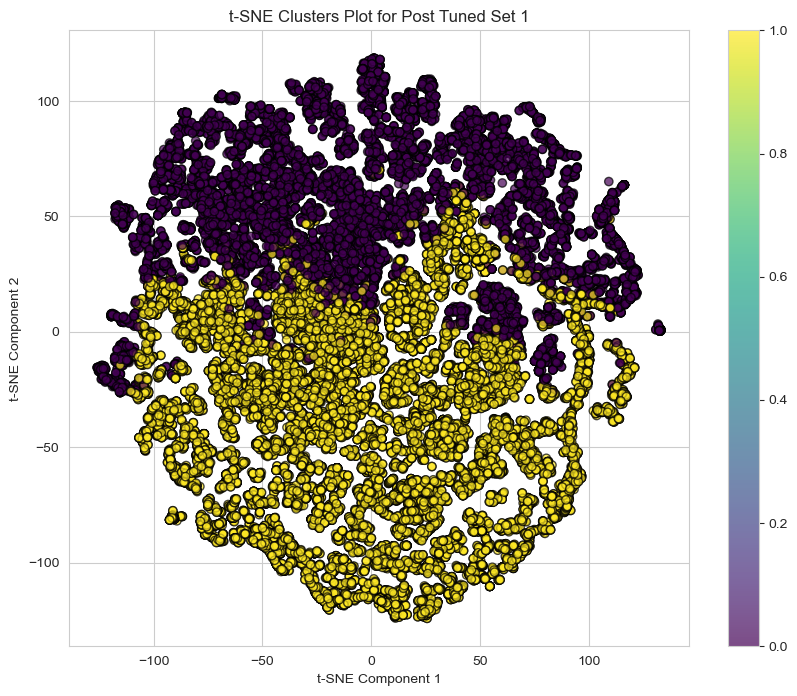

Data exported to tsne_fuzzycmeans_set1_pretune.csv


In [137]:
visualize_with_tsne_and_export(data=data_processed, labels=labels, title='t-SNE Clusters Plot for Post Tuned Set 1', csv_filename='tsne_fuzzycmeans_set1_pretune.csv')

***t-SNE Cluster Plot for Set 1***

The t-SNE visualization you provided shows the results of converting fuzzy memberships into hard labels, where each point is assigned to the cluster for which it has the highest membership.

**Cluster Distribution:** Purple cluster represent have the highest membership in one cluster, while yellow cluster represents points that primarily belong to the other cluster. Both of the clusters sreads widely across the plot, suggesting high varation within the members of the cluster.

**Separation:** There is a visible separation between the two clusters, although there are areas where the clusters come close or slightly overlap. This suggests that while the clusters are generally distinct, there are transitional data points that share characteristics of both clusters.

**Density and Outliers:** Both clusters have outliers, with the purple cluster showing some sparse outliers far from the main group.

In [138]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    data_processed.T, c=2, m=2, error=0.005, maxiter=1000, init=None, seed=42
)
labels = np.argmax(u, axis=0)

centroids_original = preprocessor.inverse_transform(cntr)
centroids_original

,energy_100g,fat_100g,saturated_fat_100g,trans_fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g
0,1104.649332,10.050311,2.633584,0.000224,0.000099,33.946709,13.126395,1.040385,8.654934,1.006179,0.396144,0.000001,0.000098,0.001914,0.000046
1,460.322542,2.590620,0.759175,0.000110,0.000052,17.909865,9.286029,0.594164,3.335400,0.310369,0.122193,0.000002,0.000713,0.008867,0.000020


***Cluster Centroids Overview***

**Cluster 0 - High Energy Dense Foods**
- **Energy**: Very high (1104.65 kJ)
- **Fat**: Moderate (10.05 g), with a moderate amount of saturated fats (2.63 g)
- **Sugars**: Moderate (13.13 g)
- **Proteins**: Moderate (8.65 g)
- **Fiber**: Moderate (1.04 g)
- **Salt**: Moderate (1.01 g)
- **Sodium**: Moderate (0.40 g)
- **Vitamins and Minerals**: Trace amounts, with minimal vitamin A and vitamin C
- **Characteristics**: Represents foods that are energy-dense, typically including processed snacks, fast foods, or desserts with a significant carbohydrate and fat content but also a reasonable amount of protein.

**Cluster 1 - Lighter, Sugar-Conscious Foods**
- **Energy**: Moderate (460.32 kJ)
- **Fat**: Low (2.59 g), with low saturated fats (0.76 g)
- **Sugars**: Moderate (9.29 g)
- **Proteins**: Low (3.34 g)
- **Fiber**: Low (0.59 g)
- **Salt**: Low (0.31 g)
- **Sodium**: Low (0.12 g)
- **Vitamins and Minerals**: Slightly better in vitamin C and calcium, indicating a potentially more nutritious profile
- **Characteristics**: Includes foods that are lower in fat and overall energy, suitable for lighter meals or snacks. These might include items like yogurts, cereals, and other similar foods that are designed to be part of a health-conscious diet.

### 3.3.2 Cluster Evaluation and Hyperparameter Tuning

In this section, we will compute the Silhouette Score, Calinski-Harabasz Index and Davies-Bouldin Index for the clustering to assess how well each cluster perform. Then, we will perform hyperparameter tuning on the model in order to enhance the performance of the model.


In [139]:
# Calculating clustering performance metrics
silhouette_avg = silhouette_score(data_processed, labels)
db_index = davies_bouldin_score(data_processed, labels)
ch_index = calinski_harabasz_score(data_processed, labels)

# Printing the metrics for quick reference
print(f"Silhouette Score for FCM Set 1: {silhouette_avg}")
print(f"Davies-Bouldin Index for FCM Set 1: {db_index}")
print(f"Calinski-Harabasz Index for FCM Set 1: {ch_index}")

# Storing the results
fuzzy_c_means_metrics = {
    'Feature Set': "Set 1",
    "Number of Clusters": 2,
    "Silhouette Score": silhouette_avg,
    "Davies-Bouldin Index": db_index,
    "Calinski-Harabasz Index": ch_index
}

cluster_performance.update({"Fuzzy C-Means": {"Pre-tuning": fuzzy_c_means_metrics}})

Silhouette Score for FCM Set 1: 0.2831004744474834
Davies-Bouldin Index for FCM Set 1: 1.8477357874539897
Calinski-Harabasz Index for FCM Set 1: 10415.200401706179


***Clustering Evaluation Metrics Interpretation***

**Silhouette Score: 0.283**
- **Interpretation:** The score indicates moderate overlap between clusters. While there is some definition between clusters, boundaries are not sharply defined, suggesting potential overlap or shared characteristics among clusters. This score is indicative of a clustering structure where members could somewhat belong to more than one cluster.

**Davies-Bouldin Index: 1.848**
- **Interpretation:** Reflects moderate clustering quality. As this index values lower scores (closer to 0), a score of 1.848 suggests that clusters are not particularly compact nor distinctly separated, implying some degree of mixture or similarity between the clusters.

**Calinski-Harabasz Index: 10,415.200**
- **Interpretation:** This index, suggesting clusters are well-separated relative to their internal dispersion, presents a high value, typically indicative of well-defined clusters. However, considering the contrasting lower scores from other metrics, it's possibly reflecting the influence of dataset size or variance more than the distinctiveness of clusters.

***Summary***
While the Calinski-Harabasz Index suggests a satisfactory level of cluster separation, the Silhouette Score and Davies-Bouldin Index highlight areas for potential improvement, particularly in enhancing cluster compactness and definition.


In the context of tuning Fuzzy C-Means (FCM) clustering, several parameters can be adjusted to potentially improve the clustering results. Since we have already decided the number of clusters (`c`) in the previous section, we will fix it at 2. Here are the other parameters within the FCM algorithm that can be explored by tuning:

1. **Fuzziness Coefficient (`m`):**
   - Description: This parameter, also known as the fuzzification coefficient, controls the level of cluster fuzziness. It determines how soft the cluster boundaries are. The exponent values must be greater than 1, with smaller values indicating a lower degree of fuzzy overlap. It is generally suggested to explore values within the range of [1.5, 2.5].
   - Impact:
     - Lower values (closer to 1) make the algorithm behave more like hard clustering (e.g., K-Means).
     - Higher values increase the fuzziness, making the clusters softer and potentially more overlapping.

2. **Error Tolerance (`error`):**
   - Description: This is the stopping criterion for the optimization. The algorithm stops iterating when the improvement in overall cluster membership between two consecutive iterations is less than or equal to this value.
   - Typical Range: Small values such as 0.001 to 0.01.
   - Impact:
     - Smaller values will lead to more precise solutions but might increase computation time as the algorithm will make more iterations before stopping.

3. **Maximum Iterations (`maxiter`):**
   - Description: The maximum number of iterations allowed for the algorithm.
   - Typical Range: 100 to 2000, depending on the complexity and size of your data.
   - Impact:
     - Increasing the maximum number of iterations can allow the algorithm to converge to a better solution, especially for difficult clustering tasks or larger datasets.

In [140]:
# Grid of parameters to test
fuzziness_values = np.linspace(1.5, 2.5, 5)
error_values = [0.001, 0.005, 0.01]
maxiter_values = [100, 200, 500, 1000, 1500, 2000]

best_fpc = 0
best_params = {}

for m in fuzziness_values:
    for error in error_values:
        for maxiter in maxiter_values:
            cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
                data_processed.T, c=2, m=m, error=error, maxiter=maxiter, init=None, seed=42
            )
            if fpc > best_fpc:
                best_fpc = fpc
                best_params = {'m': m, 'error': error, 'maxiter': maxiter}

print("Best FPC:", best_fpc)
print("Best parameters:", best_params)

Best FPC: 0.7541295923963439
Best parameters: {'m': 1.5, 'error': 0.001, 'maxiter': 100}


The results from tuning the Fuzzy C-Means (FCM) parameters have led to a substantial improvement in the Fuzzy Partition Coefficient (FPC), increasing from 0.6253 to 0.7541. This increase indicates a more defined separation between clusters, largely due to the adjustment of the fuzziness coefficient (`m`) from 2 to 1.5, which effectively reduced the overlap of cluster memberships by making the clusters "harder".

Additionally, lowering the error tolerance to 0.001 allowed the algorithm to achieve a more precise convergence, despite the reduction in maximum iterations from 1000 to 100. This suggests that the algorithm was able to reach an optimal solution more efficiently, resulting in clusters that are not only more distinct but also potentially more meaningful for subsequent analysis. These parameter adjustments should reflect positively in further evaluations using silhouette scores and other cluster validation metrics.

In [141]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    data_processed.T, c=2, m=1.5, error=0.001, maxiter=100, init=None, seed=42
)
labels = np.argmax(u, axis=0)

# Calculating clustering performance metrics
silhouette_avg = silhouette_score(data_processed, labels)
db_index = davies_bouldin_score(data_processed, labels)
ch_index = calinski_harabasz_score(data_processed, labels)

# Printing the metrics for quick reference
print(f"Silhouette Score for Tuned FCM Set 1: {silhouette_avg}")
print(f"Davies-Bouldin Index for Tuned FCM Set 1: {db_index}")
print(f"Calinski-Harabasz Index for Tuned FCM Set 1: {ch_index}")

# Storing the results
fuzzy_c_means_metrics = {
    'Feature Set': "Set 1",
    "Number of Clusters": 2,
    "Silhouette Score": silhouette_avg,
    "Davies-Bouldin Index": db_index,
    "Calinski-Harabasz Index": ch_index
}

cluster_performance["Fuzzy C-Means"].update({"Post-tuning": fuzzy_c_means_metrics})

Silhouette Score for Tuned FCM Set 1: 0.29096718401456995
Davies-Bouldin Index for Tuned FCM Set 1: 1.8240517561952696
Calinski-Harabasz Index for Tuned FCM Set 1: 10579.484318546654


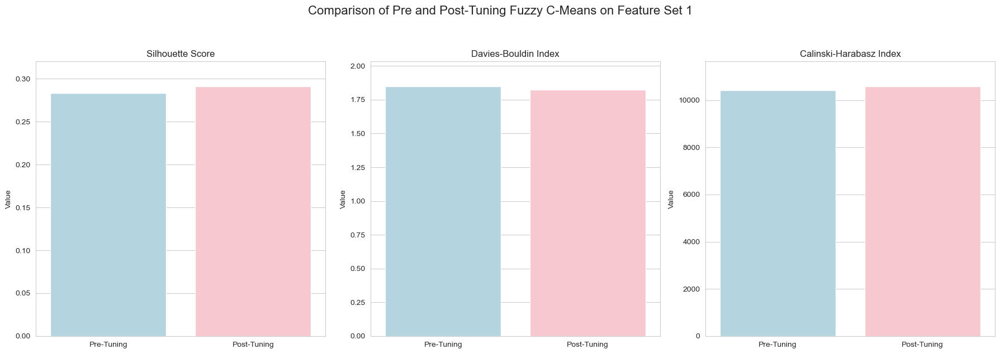

In [142]:
# Data preparation for Fuzzy C-Means
metrics = ['Silhouette Score', 'Davies-Bouldin Index', 'Calinski-Harabasz Index']
pre_tuning_values = [
    cluster_performance['Fuzzy C-Means']['Pre-tuning']['Silhouette Score'],
    cluster_performance['Fuzzy C-Means']['Pre-tuning']['Davies-Bouldin Index'],
    cluster_performance['Fuzzy C-Means']['Pre-tuning']['Calinski-Harabasz Index']
]
post_tuning_values = [
    cluster_performance['Fuzzy C-Means']['Post-tuning']['Silhouette Score'],
    cluster_performance['Fuzzy C-Means']['Post-tuning']['Davies-Bouldin Index'],
    cluster_performance['Fuzzy C-Means']['Post-tuning']['Calinski-Harabasz Index']
]

# Create a DataFrame
df = pd.DataFrame({
    'Metric': metrics * 2,
    'Value': pre_tuning_values + post_tuning_values,
    'Condition': ['Pre-Tuning']*3 + ['Post-Tuning']*3
})

# Define the color palette
palette = {'Pre-Tuning': 'lightblue', 'Post-Tuning': 'pink'}

# Plotting
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))
for i, metric in enumerate(metrics):
    sns.barplot(x='Condition', y='Value', hue='Condition', data=df[df['Metric'] == metric], ax=axes[i], palette=palette, legend=False)
    axes[i].set_title(metric)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('Value')
    # Adjust each y-axis based on its own data
    axes[i].set_ylim(0, max(pre_tuning_values[i], post_tuning_values[i]) * 1.1)

# Overall title for all subplots
fig.suptitle('Comparison of Pre and Post-Tuning Fuzzy C-Means on Feature Set 1', fontsize=16, y=1.05)

# Improve subplot spacing
plt.tight_layout()

# Display the plot
plt.show()

***Interpretation of the Results***

**Silhouette Score:**

*Increase:* From 0.283 to 0.291. This slight improvement indicates that the post-tuning clusters have marginally better separation and coherence. The score remains moderate, suggesting some overlap but generally acceptable cluster structure.

**Davies-Bouldin Index:**

*Decrease:* From 1.848 to 1.824. This indicates an improvement in the compactness and separation of the clusters. Lower values mean that the clusters are less similar to each other, which is beneficial.

**Calinski-Harabasz Index:**

*Increase:* From 10,415 to 10,579. This increase signifies that the clusters are more distinct from each other and more densely packed internally after tuning. The higher value suggests a better-defined clustering structure.

***Summary***

The changes in metrics suggest that the tuning of the Fuzzy C-Means algorithm was somewhat effective, leading to slight improvements in all evaluated aspects. Clusters are slightly more distinct and better separated after tuning, although the changes are modest.

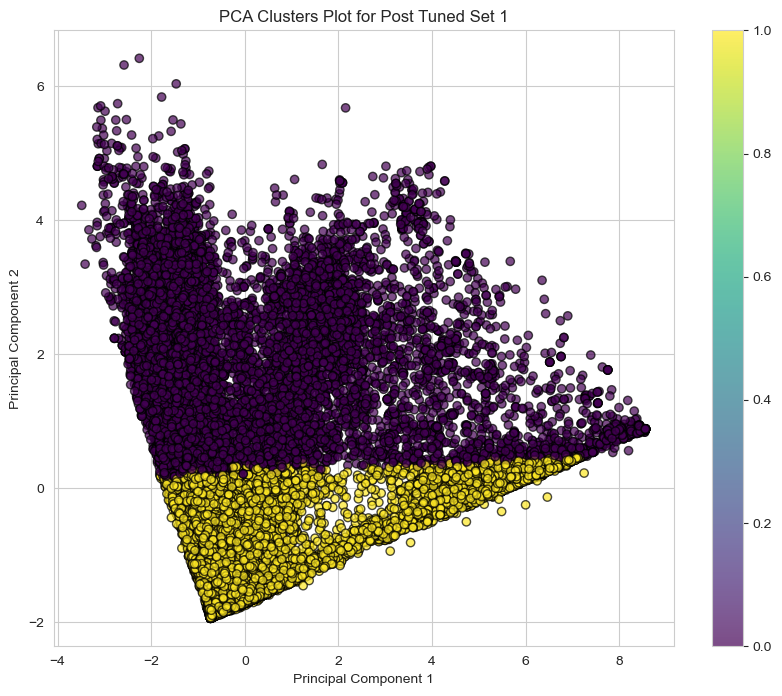

Data exported to pca_fuzzycmeans_set1_posttune.csv


In [143]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    data_processed.T, c=2, m=1.5, error=0.001, maxiter=100, init=None, seed=42
)
optimized_labels = np.argmax(u, axis=0)
visualize_with_pca_and_export(data_processed, optimized_labels,'PCA Clusters Plot for Post Tuned Set 1', 'pca_fuzzycmeans_set1_posttune.csv')

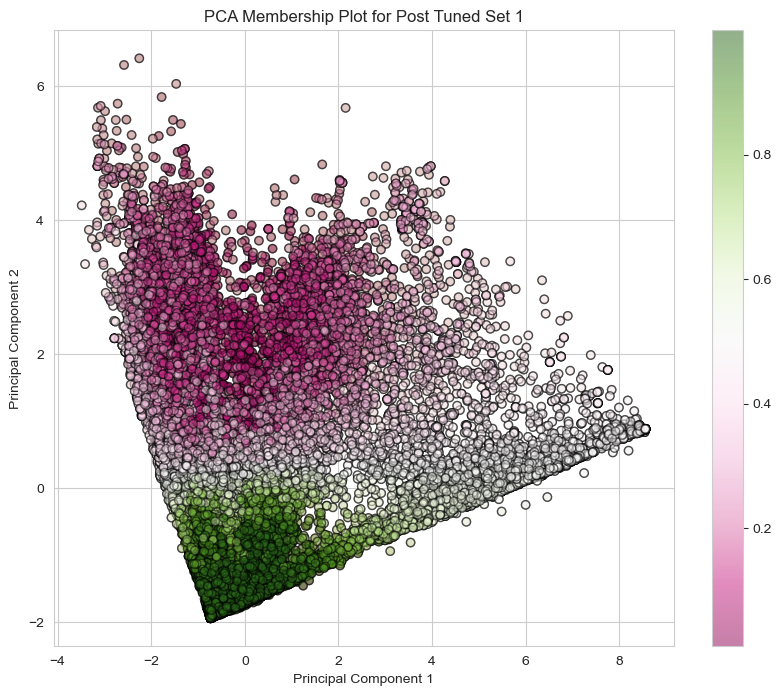

In [144]:
visualize_with_pca_memberships(data_processed, u, title='PCA Membership Plot for Post Tuned Set 1')

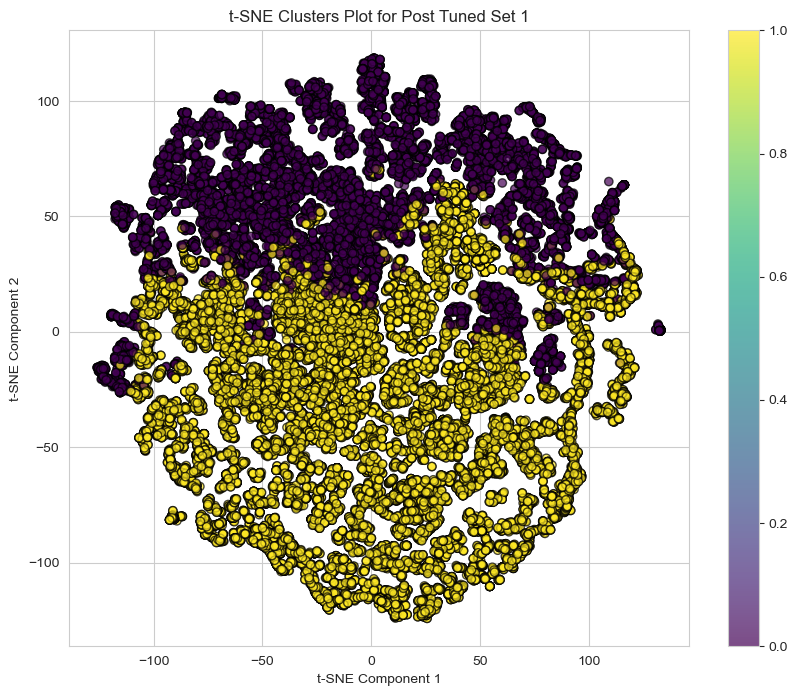

Data exported to tsne_fuzzycmeans_set1_posttune.csv


In [145]:
visualize_with_tsne_and_export(data=data_processed, labels=optimized_labels, title='t-SNE Clusters Plot for Post Tuned Set 1', csv_filename='tsne_fuzzycmeans_set1_posttune.csv')

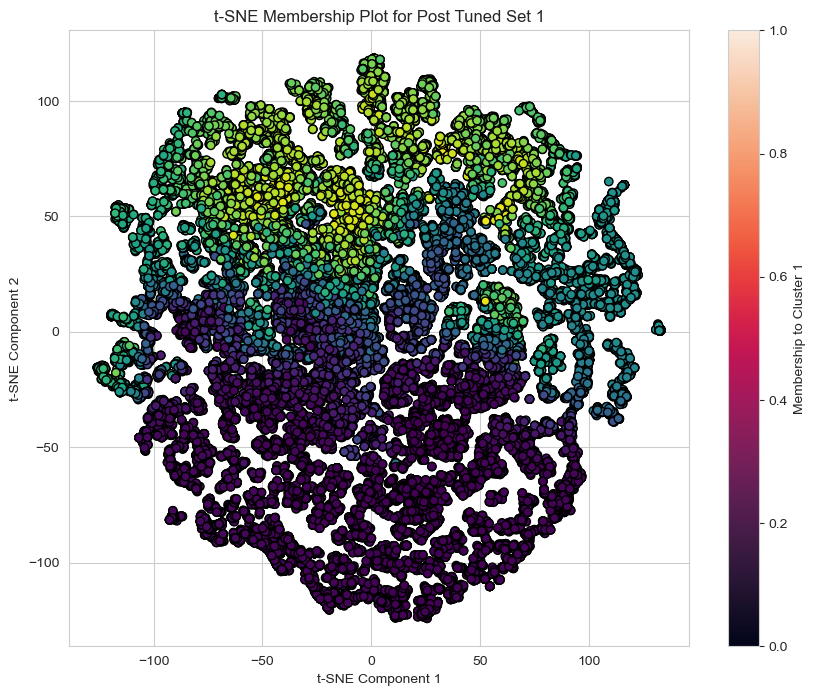

In [146]:
visualize_with_tsne_memberships(data_processed, u, title='t-SNE Membership Plot for Post Tuned Set 1')

***Observations from Visualization Results***

Initially challenging to discern distinct improvements in cluster shapes or the compactness and spread of data points based solely on the cluster visualization. However, we found some different in membership degree plot

*PCA Visualization:*
- **Intensity of Colors:** Colors representing membership levels (pink and green for higher and lower memberships) have deepened, suggesting slightly more compact clusters post-tuning.

*t-SNE Visualization:*
- **Color Shift:** Some data points transitioned from green to a yellowish-green hue, possibly reflecting improved separation between clusters, albeit subtly.

Visual changes may not be overtly dramatic, but underlying cluster memberships are evolving.

In [147]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    data_processed.T, c=2, m=1.5, error=0.001, maxiter=100, init=None, seed=42
)
centroids_original = preprocessor.inverse_transform(cntr)
centroids_original

,energy_100g,fat_100g,saturated_fat_100g,trans_fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g
0,1171.069589,11.453325,2.987693,0.000221,0.000107,34.189583,13.461072,1.021992,9.220482,1.107082,0.435872,0.000001,0.000076,0.001621,0.000047
1,464.859288,2.277332,0.675062,0.000120,0.000049,18.865040,9.207267,0.647408,3.353802,0.299234,0.117809,0.000002,0.000659,0.008241,0.000020


***Comparison of Centroids Before and After Tuning***
<br>

| Nutrient          | Before Tuning (Cluster 0) | After Tuning (Cluster 0) | Difference |
|-------------------|---------------------------|--------------------------|------------|
| Energy (kJ)       | High (1104.65)            | Higher (1171.07)         | +66.42     |
| Fat (g)           | Moderate (10.05)          | Slightly higher (11.45)  | +1.40      |
| Saturated Fat (g) | Moderate (2.63)           | Slightly higher (2.99)   | +0.36      |
| Trans Fat (g)     | Low (0.000224)            | Similar (0.000221)       | -0.000003  |
| Cholesterol (g)   | Low (0.000099)            | Similar (0.000107)       | +0.000008  |
| Carbohydrates (g) | Moderate (33.95)          | Similar (34.19)          | +0.24      |
| Sugars (g)        | High (13.13)              | Similar (13.46)          | +0.33      |
| Fiber (g)         | Moderate (1.04)           | Slightly lower (1.02)    | -0.02      |
| Proteins (g)      | High (8.65)               | Slightly higher (9.22)   | +0.57      |
| Salt (g)          | Moderate (1.01)           | Slightly higher (1.11)   | +0.10      |
| Sodium (g)        | Low (0.396)               | Similar (0.435)          | +0.039     |
| Vitamin A (g)     | Very low (0.000001)       | Similar (0.000001)       | 0          |
| Vitamin C (g)     | Very low (0.000098)       | Lower (0.000076)         | -0.000022  |
| Calcium (g)       | Very low (0.001914)       | Lower (0.001621)         | -0.000293  |
| Iron (g)          | Very low (0.000046)       | Similar (0.000047)       | +0.000001  |

| Nutrient          | Before Tuning (Cluster 1) | After Tuning (Cluster 1) | Difference |
|-------------------|---------------------------|--------------------------|------------|
| Energy (kJ)       | Moderate (460.32)         | Similar (464.86)         | +4.54      |
| Fat (g)           | Low (2.59)                | Slightly lower (2.28)    | -0.31      |
| Saturated Fat (g) | Low (0.76)                | Lower (0.68)              | -0.08      |
| Trans Fat (g)     | Low (0.000110)            | Similar (0.000120)       | +0.000010  |
| Cholesterol (g)   | Low (0.000052)            | Similar (0.000049)       | -0.000003  |
| Carbohydrates (g) | Moderate (17.91)          | Similar (18.87)          | +0.96      |
| Sugars (g)        | Moderate (9.29)           | Similar (9.21)           | -0.08      |
| Fiber (g)         | Low (0.59)                | Similar (0.65)           | +0.06      |
| Proteins (g)      | Low (3.34)                | Similar (3.35)           | +0.01      |
| Salt (g)          | Low (0.310)               | Similar (0.299)          | -0.011     |
| Sodium (g)        | Low (0.122)               | Similar (0.118)          | -0.004     |
| Vitamin A (g)     | Very low (0.000002)       | Similar (0.000002)       | 0          |
| Vitamin C (g)     | Very low (0.000713)       | Lower (0.000659)         | -0.000054  |
| Calcium (g)       | Very low (0.008867)       | Lower (0.008241)         | -0.000626  |
| Iron (g)          | Very low (0.000020)       | Similar (0.000020)       | 0          |


Overall, the changes in centroids before and after tuning are generally minor, suggesting that the tuning of the Fuzzy C-means algorithm had a limited impact on the nutritional compositions of the clusters.

### 3.4 DBSCAN (Density-Based Spatial Clustering of Applications with Noise)

DBSCAN is a density-based clustering algorithm that divides the dataset into clusters based on the density of data points in the feature space. Unlike traditional centroid-based methods like K-Means, DBSCAN does not require specifying the number of clusters a priori and can identify arbitrarily shaped clusters.

#### Hyperparameters

1. **Epsilon (ε):** The epsilon parameter defines the radius within which neighboring points are considered part of the same cluster. Points within this radius are considered core points, and points outside this radius are considered outliers or noise.

2. **Minimum Samples (MinPts):** The minimum samples parameter specifies the minimum number of points required to form a dense region or core point. Points with fewer than MinPts neighbors are considered outliers.

3. **Distance Metric:** DBSCAN supports various distance metrics, such as Euclidean distance, Manhattan distance, or cosine similarity, which define the measure of similarity between data points.

#### Evaluation Metrics

1. **Silhouette Score:** The Silhouette Score measures the compactness and separation of clusters. It ranges from -1 to 1, with higher values indicating better clustering structures.
2. **Davies-Bouldin Index:** The Davies-Bouldin Index evaluates the clustering quality by considering both the within-cluster and between-cluster distances. Lower values indicate better clustering.
3. **Calinski-Harabasz Index:** The Calinski-Harabasz Index computes the ratio of between-cluster dispersion to within-cluster dispersion. Higher values indicate better clustering structures.

### 3.4.1 Modelling and Visualization

In contrast to the previous approaches such as K-Means and Fuzzy C-Means, we do not need to manually set the number of clusters for DBSCAN. The DBSCAN algorithm assigns data points to suitable clusters automatically. Therefore, to compare the performance of each feature set with DBSCAN, we will initially perform modeling using the default settings of DBSCAN, where epsilon (eps) value is 0.5 and the minimum number of samples (min_samples) is 5.

Our primary criteria for model selection will be based on the model that generates the least number of clusters while achieving the highest silhouette score. Once we obtain a suitable model, we will visualize the clusters and analyze the characteristics of each cluster by assessing the data centroids.

In [148]:
from sklearn.metrics import silhouette_score
from sklearn.cluster import DBSCAN

feature_set_results = {}

for name, dataset in feature_sets.items():
    preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
    data_processed = preprocessor.fit_transform(dataset)

    db = DBSCAN().fit(data_processed)  # DBSCAN with eps=0.5, min_samples=5 by default
    labels = db.labels_
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)  # excluding noise points

    # Calculate and store silhouette score if clustering is valid (more than one cluster, less noise)
    if n_clusters > 1 and np.count_nonzero(labels == -1) < len(data_processed) - 1:
        score = silhouette_score(data_processed, labels)
        feature_set_results[name] = {'silhouette_score': score, 'n_clusters': n_clusters}
    else:
        feature_set_results[name] = {'silhouette_score': None, 'n_clusters': n_clusters}  # Indicate inadequate clustering or too many noise points

# Filter or rank feature sets based on number of clusters and silhouette score
max_clusters = 10  # Maximum acceptable number of clusters
valid_feature_sets = {k: v for k, v in feature_set_results.items() if v['n_clusters'] <= max_clusters and v['silhouette_score'] is not None}

# Find the best feature set based on the highest silhouette score within the valid sets
if valid_feature_sets:
    best_feature_set = max(valid_feature_sets, key=lambda k: valid_feature_sets[k]['silhouette_score'])
    best_result = valid_feature_sets[best_feature_set]
    print(f"Best Feature Set: {best_feature_set}, Silhouette Score: {best_result['silhouette_score']}, Number of Clusters: {best_result['n_clusters']}")
else:
    print("No valid feature set found with the current DBSCAN settings.")

No valid feature set found with the current DBSCAN settings.


In [149]:
feature_set_results

{'Set 1': {'silhouette_score': -0.45660734579948986, 'n_clusters': 168},
 'Set 2': {'silhouette_score': -0.4395626400616469, 'n_clusters': 165},
 'Set 3': {'silhouette_score': -0.3330158796481817, 'n_clusters': 398},
 'Set 4': {'silhouette_score': -0.41355643927293223, 'n_clusters': 297},
 'Set 5': {'silhouette_score': -0.1275741870561739, 'n_clusters': 265},
 'Set 6': {'silhouette_score': -0.47330503916101374, 'n_clusters': 188}}

From the clustering results, all the feature sets have yielded a high number of clusters and negative silhouette scores, which indicate poor clustering quality. Negative silhouette scores generally suggest that the clusters have overlapping data points, meaning the points are closer to neighboring clusters than to their own cluster. Additionally, the large number of clusters in each set can be a sign that the eps parameter in DBSCAN may be too small, causing the algorithm to consider too many clusters or that the feature space is too noisy or complex.

***Steps to Improve the Clustering Results:***
1. **Adjust the eps Parameter:** Increasing the eps value can help reduce the number of clusters by allowing more points to be included in a single cluster. This might also improve the silhouette scores by reducing the overlap between clusters.

2. **Increase min_samples:** This will make the formation of clusters more stringent, potentially reducing the number of noise points and clusters. It could lead to more significant, denser clusters, improving the silhouette scores.

In [150]:
adjusted_eps = 0.8
adjusted_min_samples = 10

# Process and evaluate each feature set
for name, dataset in feature_sets.items():
    preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
    data_processed = preprocessor.fit_transform(dataset)

    # Running DBSCAN with further adjusted parameters
    db = DBSCAN(eps=adjusted_eps, min_samples=adjusted_min_samples).fit(data_processed)
    labels = db.labels_
    n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

    # Calculate and evaluate the silhouette score
    if n_clusters > 1 and np.count_nonzero(labels == -1) < len(data_processed) - 1:
        score = silhouette_score(data_processed, labels)
        print(f"{name}: Silhouette Score: {score}, Number of Clusters: {n_clusters}")

Set 1: Silhouette Score: 0.19930041144318503, Number of Clusters: 10
Set 2: Silhouette Score: 0.1978442820401913, Number of Clusters: 10
Set 3: Silhouette Score: -0.2980168452011039, Number of Clusters: 140
Set 4: Silhouette Score: -0.38083012698525454, Number of Clusters: 69
Set 5: Silhouette Score: -0.05821721396739073, Number of Clusters: 56
Set 6: Silhouette Score: 0.1340761544135078, Number of Clusters: 11


In this case, we increased epsilon from the default value of 0.5 to 0.8 and the minimum sample size from the default of 5 to 10. This adjustment aimed to obtain a feature set capable of generating 10 clusters successfully.

- **Analysis Findings:**
  - Set 1 exhibited a silhouette score of 0.1993, forming 10 clusters.
  - Set 2 closely followed with a silhouette score of 0.1978, also forming 10 clusters.
  - Set 6 presented a positive silhouette score of 0.1341, forming 11 clusters.

These three sets demonstrated positive silhouette scores, indicating reasonably distinct and cohesive clusters. Particularly noteworthy were Sets 1 and 2, boasting the highest silhouette scores while adhering to the specified maximum cluster limit of 10.

- **Model Selection:**
  - Given the best silhouette score of Set 1, we selected it as the model for assessment.
  - By employing epsilon of 0.8 and a minimum sample size of 10, Set 1 aligns with the desired criteria and demonstrates optimal clustering performance.

In [151]:
def visualize_with_pca_and_export(data, labels, title, csv_filename, exclude_outliers=False):
    # Perform PCA
    pca = PCA(n_components=2)
    pca_result = pca.fit_transform(data)
    pca_df = pd.DataFrame(data=pca_result, columns=['PCA1', 'PCA2'])
    pca_df['Cluster'] = labels

    # Include all points
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(pca_df['PCA1'], pca_df['PCA2'], c=pca_df['Cluster'], cmap='viridis', alpha=0.7, edgecolors='k')
    plt.colorbar(scatter)
    plt.title(title)
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.grid(True)
    plt.show()

    if exclude_outliers:
        # Exclude outliers from the plot
        plt.figure(figsize=(10, 8))
        filtered_data = pca_df[pca_df['Cluster'] != -1]  # Exclude outliers
        scatter_filtered = plt.scatter(filtered_data['PCA1'], filtered_data['PCA2'], c=filtered_data['Cluster'], cmap='viridis', alpha=0.7, edgecolors='k')
        plt.colorbar(scatter_filtered)
        plt.title(title + " (Excluding Outliers)")
        plt.xlabel('Principal Component 1')
        plt.ylabel('Principal Component 2')
        plt.grid(True)
        plt.show()

    pca_df.to_csv(csv_filename, index=False)
    print(f"Data exported to {csv_filename}")

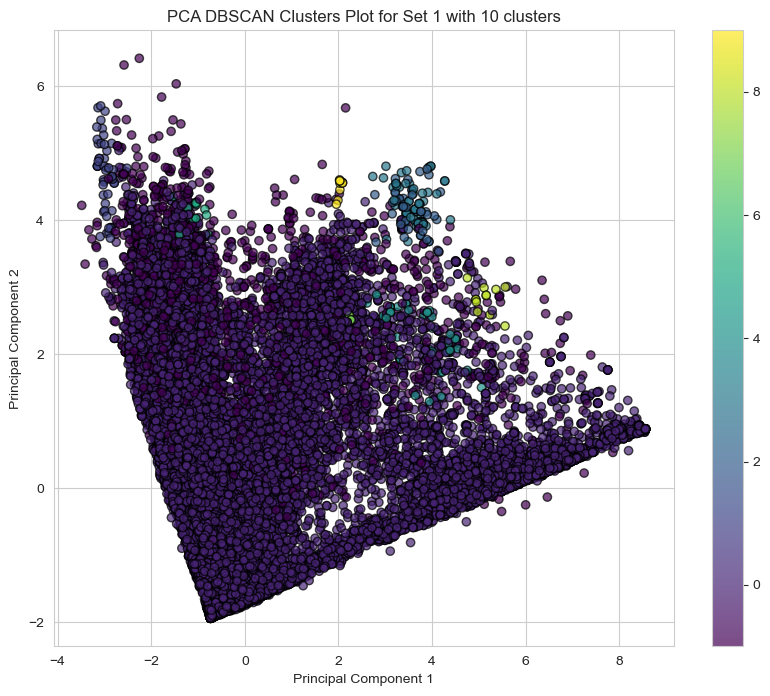

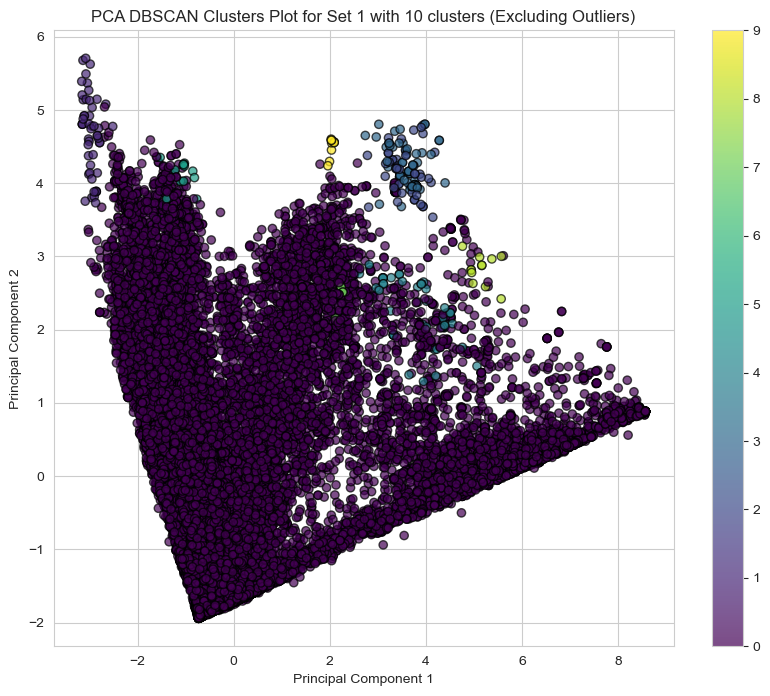

Data exported to pca_dbscan_set1_pretune.csv


In [152]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
db = DBSCAN(eps=0.8, min_samples=10)
labels = db.fit_predict(data_processed)
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

visualize_with_pca_and_export(data_processed, labels, f'PCA DBSCAN Clusters Plot for Set 1 with {n_clusters} clusters', 'pca_dbscan_set1_pretune.csv', exclude_outliers=True)

In [153]:
def visualize_with_tsne_and_export(data, labels, title, csv_filename,  exclude_outliers=False):
    # Fit t-SNE to the data
    tsne = TSNE(n_components=2, random_state=42)
    tsne_results = tsne.fit_transform(data)

    # Create a DataFrame for the t-SNE results and add cluster labels
    tsne_df = pd.DataFrame(tsne_results, columns=['TSNE1', 'TSNE2'])
    tsne_df['Cluster'] = labels

    # Plot the results
    plt.figure(figsize=(10, 8))
    scatter = plt.scatter(tsne_df['TSNE1'], tsne_df['TSNE2'], c=tsne_df['Cluster'], cmap='viridis', edgecolor='k', alpha=0.7)
    plt.colorbar(scatter)
    plt.title(title)
    plt.xlabel('t-SNE Component 1')
    plt.ylabel('t-SNE Component 2')
    plt.grid(True)
    plt.show()

    if exclude_outliers:
        # Exclude outliers from the plot
        plt.figure(figsize=(10, 8))
        filtered_data = tsne_df[tsne_df['Cluster'] != -1]  # Exclude outliers
        scatter_filtered = plt.scatter(filtered_data['TSNE1'], filtered_data['TSNE2'], c=filtered_data['Cluster'], cmap='viridis', alpha=0.7, edgecolors='k')
        plt.colorbar(scatter_filtered)
        plt.title(title + " (Excluding Outliers)")
        plt.xlabel('t-SNE Component 1')
        plt.ylabel('t-SNE Component 2')
        plt.grid(True)
        plt.show()

    # Export to CSV
    tsne_df.to_csv(csv_filename, index=False)
    print(f"Data exported to {csv_filename}")

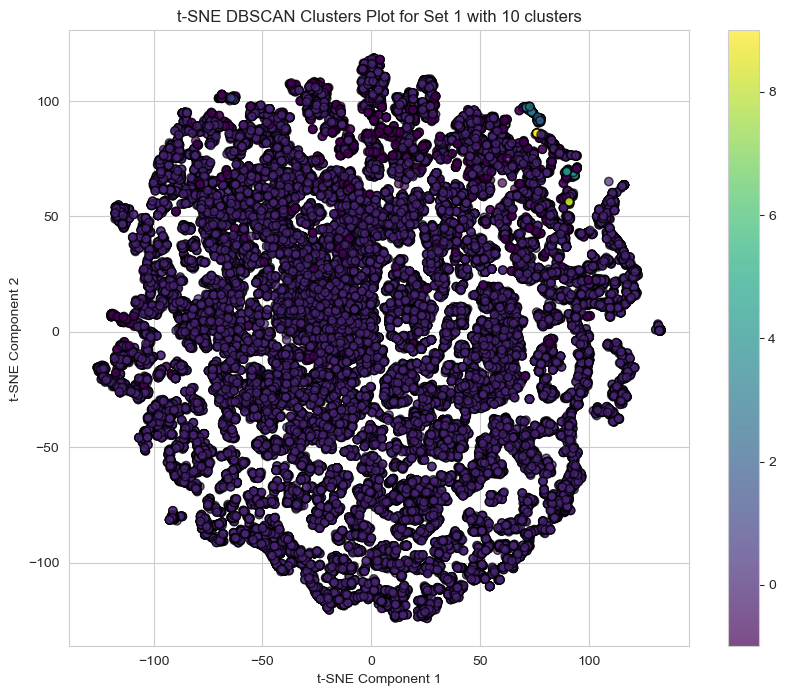

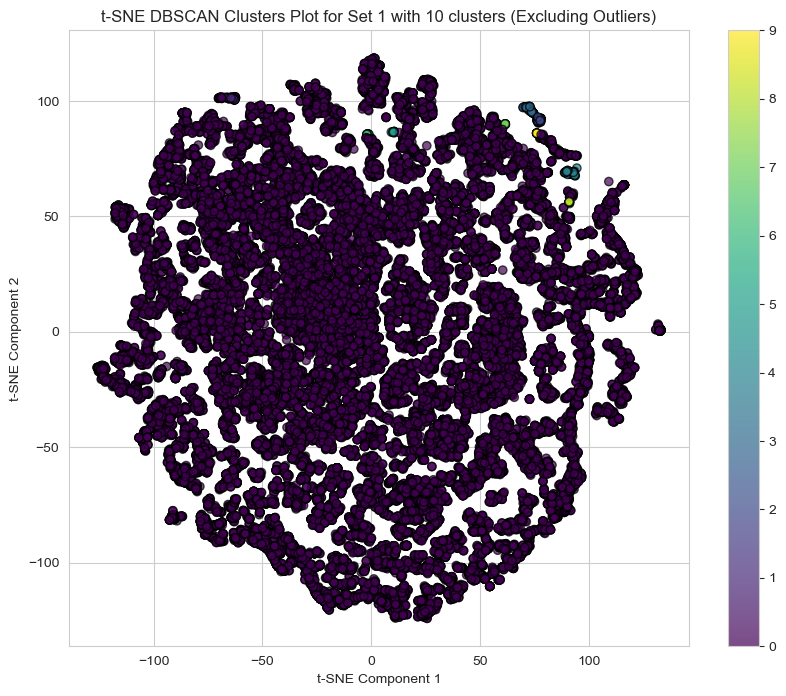

Data exported to tsne_dbscan_set1_pretune.csv


In [154]:
visualize_with_tsne_and_export(data_processed, labels, f't-SNE DBSCAN Clusters Plot for Set 1 with {n_clusters} clusters', "tsne_dbscan_set1_pretune.csv", exclude_outliers=True)

From the result of PCA and t-SNE plot of DBSCAN clustering for Set 1, we can observe:

**Cluster Distribution and Seperation:**
- The bulk of the data points are clusterd tightly in a large central mass, which indicates a high density area where most data points are similar with respect to the first two principal components.
- Several small clusters are visible around the periphery of this central mass. These clusters are relatively well-separated from each other and from the main group. Only some of them are overlapped.

**Outlier and Noise:**
- There are various points disappeared in the second plot, which is PCA plot but excluding the outliers. These could represent outliers or noise in the dataset. Given the nature of DBSCAN, which classifies some points as noise (not belonging to any cluster), these are likely points that the algorithm could not group into any of the main or peripheral clusters.

In clustering algorithms, accessing the centroids is straightforward for methods like k-means or fuzzy c-means, where the concept of a "centroid" or "center" of a cluster is well-defined and integral to the method.

However, for DBSCAN, the concept of a centroid is not as straightforward because DBSCAN does not inherently compute centroids. DBSCAN classifies as core points, border points, and noise, based on density. It does not compute a central point like centroid-based clustering algorithms do.

Thus,we will approximate the centroids by calculating the means of the point in each cluster identified by DBSCAN.

In [155]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
db = DBSCAN(eps=0.8, min_samples=10)
labels = db.fit_predict(data_processed)
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

unique_labels = set(labels)
centroids = []

# Filter out noise (-1 label) if present.
clusters = [label for label in unique_labels if label != -1]

for cluster in clusters:
    # Indices of points in this cluster.
    indices = np.where(labels == cluster)[0]
    # Calculate mean of points in this cluster.
    cluster_mean = np.mean(data_processed[indices], axis=0)
    centroids.append(cluster_mean)

centroids_original = preprocessor.inverse_transform(np.array(centroids))
centroids_original

,energy_100g,fat_100g,saturated_fat_100g,trans_fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g
0,709.008653,5.130417,1.404985,0.000158,0.000066,24.852092,10.980249,0.775598,5.387992,0.567073,0.223261,0.000002,0.000431,0.005571,0.000028
1,1080.192000,16.127800,6.056000,0.000000,0.000000,1.090000,0.678000,0.142000,27.526800,4.087920,1.609417,0.000000,0.000000,0.000000,0.000000
2,2288.685106,33.489362,7.000000,0.002128,0.000000,55.138298,52.210638,0.014894,5.402128,0.134079,0.052787,0.000000,0.000000,0.001489,0.000036
3,2298.000000,33.523935,6.584375,0.000000,0.000016,55.374268,53.364063,3.131157,5.243614,0.133670,0.052628,0.000000,0.000000,0.000000,0.000000
4,1909.903846,18.971731,1.794615,0.000000,0.000000,61.861923,52.701154,3.112692,8.100000,0.094680,0.037278,0.000000,0.000000,0.000000,0.000000
5,1922.500000,18.121429,7.996429,0.000000,0.000000,65.114286,7.150000,2.778571,8.500000,2.435700,0.958923,0.000011,0.000000,0.000000,0.000257
6,1369.900000,2.902000,0.444000,0.000000,0.000000,64.127000,2.311000,0.000000,9.170000,3.918000,1.542520,0.000000,0.000000,0.000000,0.000000
7,1926.142857,24.857143,2.342857,0.000000,0.000000,48.785714,37.242857,3.728571,8.728571,0.056029,0.022058,0.000000,0.000000,0.000000,0.000000
8,1790.916667,12.350000,7.328333,0.000000,0.000000,74.958333,66.783333,2.712500,2.412500,0.061858,0.024353,0.000000,0.000000,0.004108,0.000386
9,2427.400000,37.561968,7.480000,0.000000,0.000000,57.186415,36.190000,0.929656,3.119082,0.537162,0.211529,0.000000,0.000000,0.000000,0.000000


***Cluster Analysis***

***Cluster 0:***
- **Characteristics:** Moderately high in energy, moderate fat, and reasonable carbohydrate content.
- **Key Components:** Balanced nutrients with relatively moderate sugar and fiber levels.
- **Likely Foods:** Could include balanced snacks or meals, such as certain prepared foods or bakery products.

***Cluster 1:***
- **Characteristics:** High in protein and energy, very low in carbohydrates and sugars.
- **Key Components:** High protein content suggests lean meats or high-protein plant-based alternatives.
- **Likely Foods:** Meat cuts, high-protein vegan substitutes.

***Cluster 2 & 3:***
- **Characteristics:** Extremely high in carbohydrates and sugars, very high energy.
- **Key Components:** Very high sugar content points to sweetened products.
- **Likely Foods:** Sweet desserts, confectionery items, or sugary beverages.

***Cluster 4:***
- **Characteristics:** High in energy and carbohydrates, especially sugars.
- **Key Components:** High fiber content and substantial protein levels.
- **Likely Foods:** Energy bars, cereals, or high-carb snacks.

***Cluster 5:***
- **Characteristics:** High in carbohydrates with reasonable amounts of fat and protein.
- **Key Components:** Moderate sugars and high salt content.
- **Likely Foods:** Savory snacks or meals with added sugars and salt, possibly frozen meals or sauces.

***Cluster 6:***
- **Characteristics:** Moderate energy, very high in carbohydrates, and low in sugars.
- **Key Components:** High in protein, very high in salt.
- **Likely Foods:** Savory snacks, certain breads, or processed foods.

***Cluster 7:***
- **Characteristics:** Moderately high in energy, fat, and carbohydrates.
- **Key Components:** Considerable amount of sugars and high fiber.
- **Likely Foods:** Desserts or snack foods that combine sweetness with a bit of health-conscious positioning (like fiber).

***Cluster 8:***
- **Characteristics:** High in carbohydrates and very high in sugars.
- **Key Components:** Moderate protein and fiber, low in fat.
- **Likely Foods:** Highly sweetened foods, possibly including cakes, cookies, or sweet pastries.

***Cluster 9:***
- **Characteristics:** Very high in energy, fats, and carbohydrates.
- **Key Components:** High in saturated fats, moderate in sugars.
- **Likely Foods:** Fatty and sugary foods, such as certain types of fast food or indulgent desserts.

### 3.4.2 Cluster Evaluation and Hyperparameter Tuning

In this section, we will compute the Silhouette Score, Calinski-Harabasz Index and Davies-Bouldin Index for the clustering to assess how well each cluster perform. Then, we will perform hyperparameter tuning on the model in order to enhance the performance of the model.


In [156]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])

# DBSCAN Clustering
db = DBSCAN(eps=0.8, min_samples=10)
labels = db.fit_predict(data_processed)

# Calculating clustering performance metrics
silhouette_avg = silhouette_score(data_processed, labels)
db_index = davies_bouldin_score(data_processed, labels)
ch_index = calinski_harabasz_score(data_processed, labels)

# Printing the metrics for quick reference
print(f"Silhouette Score for DBSCAN Set 1: {silhouette_avg}")
print(f"Davies-Bouldin Index for DBSCAN Set 1: {db_index}")
print(f"Calinski-Harabasz Index for DBSCAN Set 1: {ch_index}")

# Storing the results
dbscan_metrics = {
    'Feature Set': "Set 1",
    "Number of Clusters": len(set(labels)) - (1 if -1 in labels else 0),
    "Silhouette Score": silhouette_avg,
    "Davies-Bouldin Index": db_index,
    "Calinski-Harabasz Index": ch_index
}

cluster_performance.update({"DBSCAN": {"Pre-tuning": dbscan_metrics}})

Silhouette Score for DBSCAN Set 1: 0.19930041144318503
Davies-Bouldin Index for DBSCAN Set 1: 1.272731819313402
Calinski-Harabasz Index for DBSCAN Set 1: 238.75826931423092


***Clustering Evaluation Metrics Interpretation***

**Silhouette Score 0.1993**
- **Interpretation:** A score of 0.1993 suggests that clusters are not very distinct, where clusters overlap somewhat. This is evident as in the visualition of cluster, many clusters  are densely packed together with some intermingling.

**Davies-Bouldin Index 1.2727:**
- **Interpretation:** An index of 1.2727 is moderately low, suggesting that clusters are reasonably well-separated and compact, but there could still be some overlap or closeness between some clusters.

**Calinski-Harabasz Index 238.7583:**
- **Interpretation:** A score of 238.7583, while not extremely high, does indicate some degree of clustering quality with reasonable between-cluster variance and within-cluster density. However, this may affceted by the size of the dataset.

***Summary***
The clustering outcome shows a mix of well-separated small clusters and a large, dense grouping. The performance metrics suggest that while the clustering isn't perfect, it's reasonably effective, particularly in separating a few smaller clusters from the main group.

To further refine the DBSCAN parameters for Feature Set 1, we need to focus on improving the cluster separation and compactness while ensuring that fewer data points are classified as noise. The parameters to adjust in DBSCAN are:

1. **eps (epsilon):** The maximum distance between two samples for one to be considered as in the neighborhood of the other. Adjusting this can affect how dense the clusters are and how much of the data is considered noise.
2. **min_samples:** The number of samples in a neighborhood for a point to be considered as a core point. This includes the point itself.

In tuning process, we will implement a grid search to systematically vary `eps` and `min_samples` within a range. In the comparison of feature set, we use `eps` = 0.8 and `min_samples` = 10 to get a cluster number 10 from Set 1 and Set 2. Thus, for tuning, we will test range around this, for `eps`, we use from 0.6 to 0.95 in increments of 0.05 and for `min_samples`, we test range from 10 to 20. The silhouette score will be the metric to identify the beset combination of parameters.

In [157]:
eps_values = np.arange(0.6, 0.95, 0.05)
min_samples_values = range(10, 21)

best_eps = 0.6
best_min_samples = 10
best_silhouette = -1
best_cluster_count = float('inf')

for eps in eps_values:
    for min_samples in min_samples_values:
        db = DBSCAN(eps=eps, min_samples=min_samples)
        labels = db.fit_predict(data_processed)
        n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

        # Limit the maximum cluster to 10
        if n_clusters > 1 and n_clusters <= 10:
            score = silhouette_score(data_processed, labels)
            print(f'EPS: {eps}, min_samples: {min_samples}, Silhouette: {score}, Clusters: {n_clusters}')
            if score > best_silhouette and n_clusters < best_cluster_count:
                best_silhouette = score
                best_eps = eps
                best_min_samples = min_samples
                best_cluster_count = n_clusters

print(f'Best EPS: {best_eps}, Best min_samples: {best_min_samples}, Best Silhouette Score: {best_silhouette}, Number of Clusters: {best_cluster_count}')

EPS: 0.7500000000000001, min_samples: 17, Silhouette: 0.16339092412678322, Clusters: 10
EPS: 0.8000000000000002, min_samples: 10, Silhouette: 0.19930041144318503, Clusters: 10
EPS: 0.8000000000000002, min_samples: 11, Silhouette: 0.2022028344932526, Clusters: 8
EPS: 0.8000000000000002, min_samples: 12, Silhouette: 0.19943946359185194, Clusters: 8
EPS: 0.8000000000000002, min_samples: 13, Silhouette: 0.20624858098055504, Clusters: 8
EPS: 0.8000000000000002, min_samples: 14, Silhouette: 0.15170322274948725, Clusters: 8
EPS: 0.8000000000000002, min_samples: 19, Silhouette: 0.22821913967211274, Clusters: 7
EPS: 0.8000000000000002, min_samples: 20, Silhouette: 0.19291118617623107, Clusters: 8
EPS: 0.8500000000000002, min_samples: 10, Silhouette: 0.2128715190619305, Clusters: 8
EPS: 0.8500000000000002, min_samples: 11, Silhouette: 0.215291677399263, Clusters: 7
EPS: 0.8500000000000002, min_samples: 12, Silhouette: 0.2335196013868256, Clusters: 5
EPS: 0.8500000000000002, min_samples: 13, Silh

Based on the results of parameter tuning, the highest Silhouette Score occurred at an `eps` of 0.900 and `min_samples` of 14, producing a score of 0.2769 with only 4 clusters. The Silhouette score increase from 0.199 to 0.2769, suggests improve in the cohension and separtion of the clusters. A score of 0.2769 implies that while there is some overlap, the clusters are more distinct than in any previous configuration.

Since our goal was to not exceed 10 clusters, and with this configuration, we have significantly fewer clusters, 4. This suggests a higher-level grouping, where the model has effectively consolidated the data points into four main groups. Generally, a higher silhouette score with fewer clusters might indicate that these clusters are capturing significant structures within the data. While the silhouette score is not exceptionally high, it is the highest achieved in the tuning process.

In [158]:
# DBSCAN Clustering with tuned parameters
db = DBSCAN(eps=0.9, min_samples=14)
labels_dbscan = db.fit_predict(data_processed)

# Ensure there are at least two clusters and less than n-1 noise points to calculate silhouette
silhouette_avg_dbscan = silhouette_score(data_processed, labels_dbscan)
db_index_dbscan = davies_bouldin_score(data_processed, labels_dbscan)
ch_index_dbscan = calinski_harabasz_score(data_processed, labels_dbscan)

print(f"Silhouette Score for DBSCAN Set 1: {silhouette_avg_dbscan}")
print(f"Davies-Bouldin Index for DBSCAN Set 1: {db_index_dbscan}")
print(f"Calinski-Harabasz Index for DBSCAN Set 1: {ch_index_dbscan}")


dbscan_metrics = {
        'Feature Set': "Set 1",
        "Number of Clusters": len(set(labels_dbscan)) - (1 if -1 in labels_dbscan else 0),
        "Silhouette Score": silhouette_avg_dbscan,
        "Davies-Bouldin Index": db_index_dbscan,
        "Calinski-Harabasz Index": ch_index_dbscan
}

cluster_performance["DBSCAN"].update({"Post-tuning": dbscan_metrics})

Silhouette Score for DBSCAN Set 1: 0.2769178737541194
Davies-Bouldin Index for DBSCAN Set 1: 1.6111721170716575
Calinski-Harabasz Index for DBSCAN Set 1: 453.5385141369882


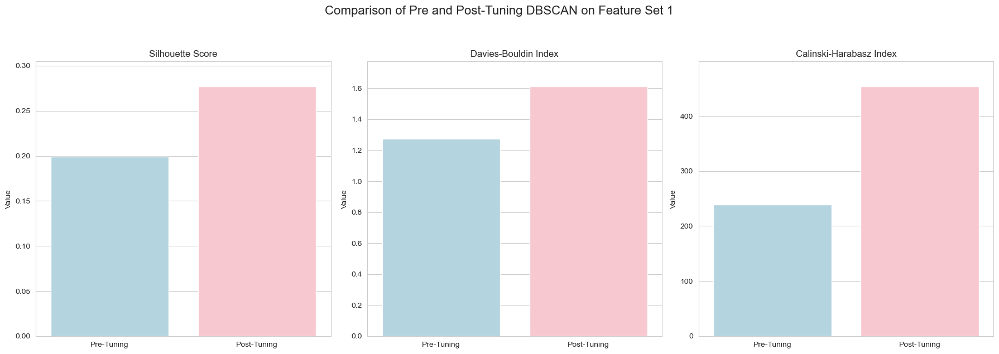

In [159]:
# Data preparation for DBSCAN
metrics = ['Silhouette Score', 'Davies-Bouldin Index', 'Calinski-Harabasz Index']
pre_tuning_values = [
    cluster_performance['DBSCAN']['Pre-tuning']['Silhouette Score'],
    cluster_performance['DBSCAN']['Pre-tuning']['Davies-Bouldin Index'],
    cluster_performance['DBSCAN']['Pre-tuning']['Calinski-Harabasz Index']
]
post_tuning_values = [
    cluster_performance['DBSCAN']['Post-tuning']['Silhouette Score'],
    cluster_performance['DBSCAN']['Post-tuning']['Davies-Bouldin Index'],
    cluster_performance['DBSCAN']['Post-tuning']['Calinski-Harabasz Index']
]

# Create a DataFrame
df = pd.DataFrame({
    'Metric': metrics * 2,
    'Value': pre_tuning_values + post_tuning_values,
    'Condition': ['Pre-Tuning']*3 + ['Post-Tuning']*3
})

# Define the color palette
palette = {'Pre-Tuning': 'lightblue', 'Post-Tuning': 'pink'}

# Plotting
fig, axes = plt.subplots(nrows=1, ncols=3, figsize=(18, 6))
for i, metric in enumerate(metrics):
    sns.barplot(x='Condition', y='Value', hue='Condition', data=df[df['Metric'] == metric], ax=axes[i], palette=palette, legend=False)
    axes[i].set_title(metric)
    axes[i].set_xlabel('')
    axes[i].set_ylabel('Value')
    # Adjust each y-axis based on its own data
    axes[i].set_ylim(0, max(pre_tuning_values[i], post_tuning_values[i]) * 1.1)

# Overall title for all subplots
fig.suptitle('Comparison of Pre and Post-Tuning DBSCAN on Feature Set 1', fontsize=16, y=1.05)

# Improve subplot spacing
plt.tight_layout()

# Display the plot
plt.show()

***Interpretation of the Results***

**Number of Clsuters:**

*Decrease:* From 10 to 4. This decrease indicates a significant consolidation of data points into larger, perhaps more meaningful groups. This suggests that the tuning has possibly removed some less significant clusters or has better defined the boundaries between clusters.

**Silhouette Score:**

*Increase:* From 0.1993 to 0.2769. This improvement indicates that the post-tuning clusters have marginally better separation and coherence. The score remains moderate, suggesting some overlap but generally acceptable cluster structure.

**Davies-Bouldin Index:**

*Decrease:* From 1.2727 to 1.6112. This indicates an a poorer clustering as it measures the average similarity between clusters with lower values being preferable. However, this might reflect the trade-off between cluster separation and compactness, especially given the reduced number of clusters.

**Calinski-Harabasz Index:**

*Increase:* From 238.758 to 453.539.  This index is a measure of cluster validity and evaluates clusters based on their dispersion. A higher value generally indicates that clusters are denser and more separated, which aligns with the reduction in the number of clusters and the increase in the silhouette score.

***Summary***

Overall, the post-tuning results suggest that DBSCAN, after adjustments, has been able to find a more coherent internal structure within the dataset, creating fewer but more distinct and potentially meaningful clusters. The increase in some indices suggests better clustering performance despite a rise in the Davies-Bouldin index.

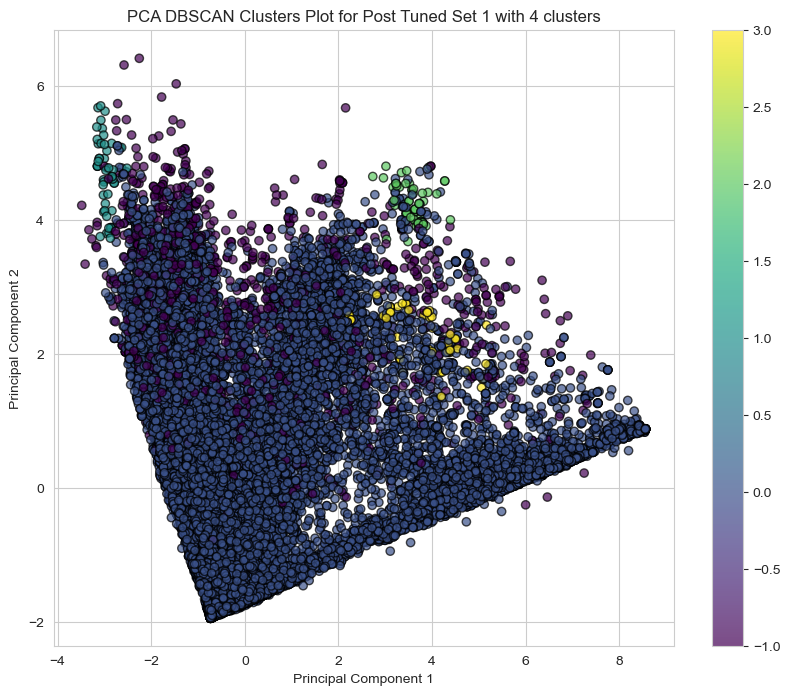

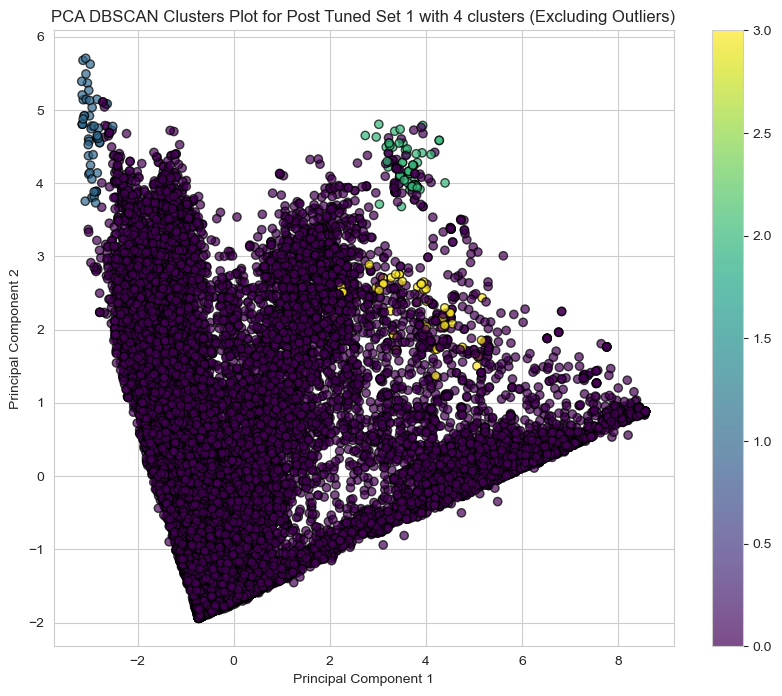

Data exported to pca_dbscan_set1_posttune.csv


In [160]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
db = DBSCAN(eps=0.9, min_samples=14)
labels = db.fit_predict(data_processed)
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

visualize_with_pca_and_export(data_processed, labels, f'PCA DBSCAN Clusters Plot for Post Tuned Set 1 with {n_clusters} clusters', 'pca_dbscan_set1_posttune.csv', exclude_outliers=True)

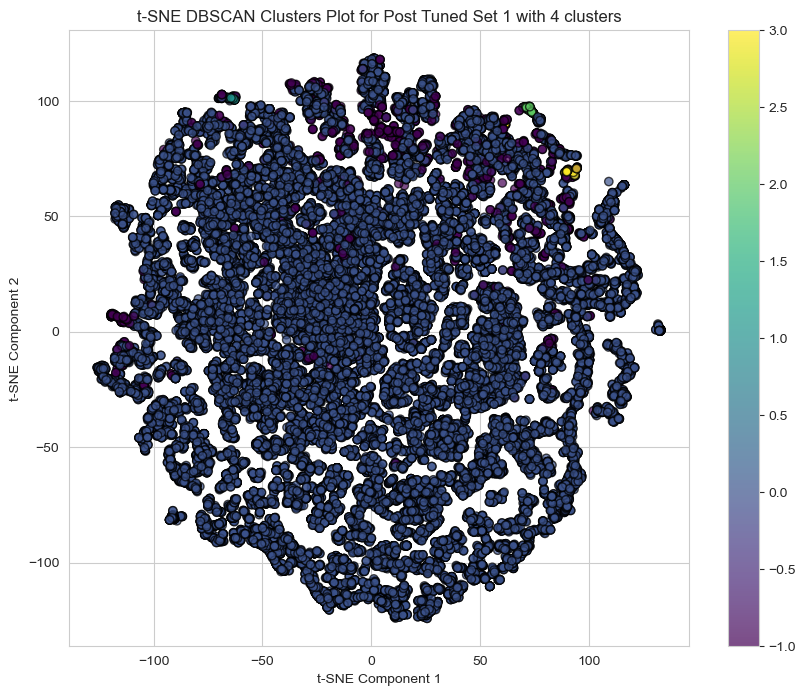

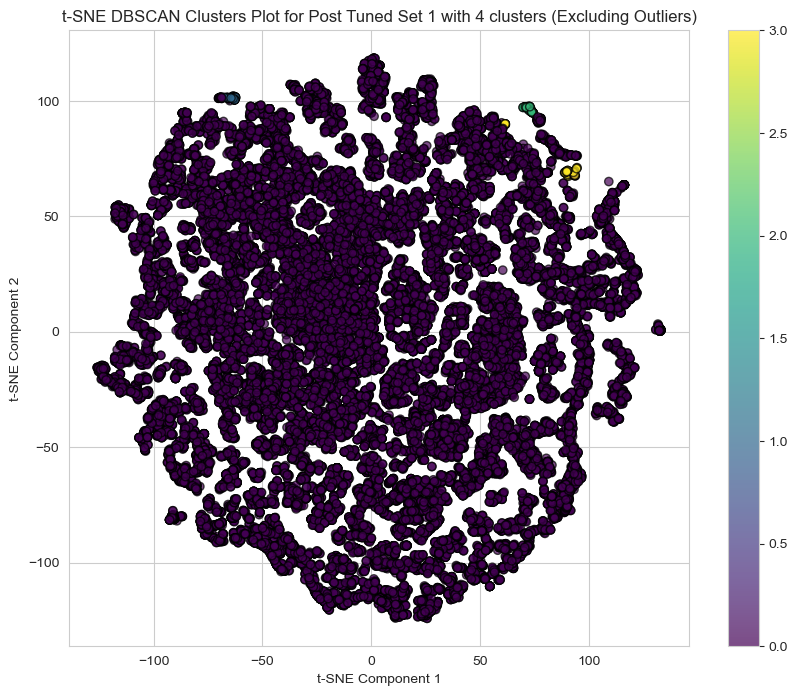

Data exported to tsne_dbscan_set1_posttune.csv


In [161]:
visualize_with_tsne_and_export(data_processed, labels, f't-SNE DBSCAN Clusters Plot for Post Tuned Set 1 with {n_clusters} clusters', "tsne_dbscan_set1_posttune.csv", exclude_outliers=True)

***Observations from Visualization Results***

**Cluster Distribution**
From the visualization of the PCA and t-SNE plots, all the data are assigned to four main clusters, distinguished by different colors. These clusters are relatively distinct, although some overlap is visible. Similar to the pre-tuning result, there is a main cluster where most of the data points were assigned. In the t-SNE plot, we can observe that cluster 1 and 2 (blue and green) are very compact, while only cluster 3 (yellow) shows some spread.

**Outlier Identification**
In both the PCA and t-SNE plots, the first chart includes outliers, while the second chart excludes them, focusing only on the clustered data. The significant presence of outliers in the first plot suggests that there are many data points in the dataset that do not fit well into the dense regions defined by the `eps` and `min_samples` settings. This could mean that the data has a fair amount of variance or noise, or that there are distinct subgroups that do not conform to the larger cluster patterns.

In [162]:
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(feature_sets['Set 1'])
db = DBSCAN(eps=0.9, min_samples=14)
labels = db.fit_predict(data_processed)
n_clusters = len(set(labels)) - (1 if -1 in labels else 0)

unique_labels = set(labels)
centroids = []

# Filter out noise (-1 label) if present.
clusters = [label for label in unique_labels if label != -1]

for cluster in clusters:
    # Indices of points in this cluster.
    indices = np.where(labels == cluster)[0]
    # Calculate mean of points in this cluster.
    cluster_mean = np.mean(data_processed[indices], axis=0)
    centroids.append(cluster_mean)

centroids_original = preprocessor.inverse_transform(np.array(centroids))
centroids_original

,energy_100g,fat_100g,saturated_fat_100g,trans_fat_100g,cholesterol_100g,carbohydrates_100g,sugars_100g,fiber_100g,proteins_100g,salt_100g,sodium_100g,vitamin_a_100g,vitamin_c_100g,calcium_100g,iron_100g
0,717.196045,5.250290,1.429503,0.000165,0.000067,25.047654,11.079074,0.781431,5.410575,0.571745,0.225100,0.000002,0.000427,0.005555,0.000029
1,1089.126923,16.278654,6.105769,0.000000,0.000000,1.246154,0.703846,0.134615,27.566154,4.054346,1.596199,0.000000,0.000000,0.000000,0.000000
2,2293.741935,33.379546,6.519355,0.000000,0.000016,55.289567,53.246774,3.190226,5.361150,0.134730,0.053045,0.000000,0.000000,0.000000,0.000000
3,1908.451613,19.412903,1.909677,0.000000,0.000000,60.635484,51.808065,3.209677,8.246774,0.088096,0.034686,0.000000,0.000000,0.000000,0.000000


***Comparison of Centroids Before and After Tuning***
<br>

| Cluster | Before Tuning                             | Cluster | After Tuning                                    |
|---------|------------------------------------------|---------|-------------------------------------------------|
| 0       | Energy: Low<br>Fat: Low                 | 0       | Energy: Low<br>Fat: Low                         |
| 1       | Energy: Medium<br>Fat: Moderate<br>Protein: High | 1       | Energy: Slightly increased<br>Fat: Slightly increased<br>Protein: High |
| 2 and 3 | Energy: High<br>Fat: Very high<br>Carbohydrates: Very high | 2       | Similar to pre-tuning Cluster 2 and 3 but with refined separation                                                                                  |
| 4 to 9  | Varying from moderate to very high in calorie content with different levels of sugars and fats | 3       | Reflects similar attributes to pre-tuning Cluster 4 but with better differentiation in nutritional content, particularly protein and carbohydrates |

***Summary***

The DBSCAN tuning has retained the fundamental characteristics of each cluster while refining their definitions. Post-tuning, clusters show slightly more distinctive nutrient profiles, improving the precision in classifying foods based on their nutritional content. This refinement is particularly evident in the better separation of protein and carbohydrate contents across clusters, suggesting that the tuning process has enhanced the algorithm's ability to differentiate between various types of food items more accurately.

### 3.5 OPTICS (Ordering Points To Identify the Clustering Structure)

OPTICS is a density-based clustering algorithm that extends DBSCAN by creating a reachability plot, which provides a hierarchical clustering structure and identifies clusters of varying density.

#### Hyperparameters

1. **Minimum Samples (min_samples)**: The minimum number of samples required to form a core point. Core points are points with at least "min_samples" within a specified radius.

2. **Reachability Distance (epsilon)**: The maximum distance between points to consider them as neighbors. It defines the neighborhood of a point and influences the clustering structure.

3. **Xi (xi)**: Xi determines the minimum steepness of the cluster ordering. It defines the minimum difference in reachability distance between a point and its neighboring points to be considered as a steep point in the ordering.

4. **Minimum Cluster Size (min_cluster_size)**: Specifies the minimum number of samples required for a cluster to be considered valid. Clusters with fewer samples than "min_cluster_size" will be labeled as noise.

5. **Metric**: The distance metric used to measure the distance between points, such as Euclidean distance, Manhattan distance, or cosine similarity.

#### Output

OPTICS produces a reachability plot, which provides insights into the density-based clustering structure of the data. It also identifies core points, border points, and noise points based on their reachability distances.
<br>
#### Evaluation Metrics

1. **Silhouette Score**: Similar to other clustering algorithms, the Silhouette Score can be used to evaluate the quality of clusters generated by OPTICS. However, since OPTICS does not explicitly assign cluster labels, the Silhouette Score can be computed based on the reachability distances.

2. **Clustering Structure Visualization**: Visualizing the reachability plot and extracted clusters can provide valuable insights into the underlying clustering structure and help assess the effectiveness of the algorithm.

3. **Davies-Bouldin Index (DB Index)**: DB index measures the average similarity between each cluster and its most similar cluster, relative to the cluster's dispersion. Lower values indicate better clustering, with a minimum of 0 indicating perfectly separated clusters.

4. **Calinski-Harabasz Index (CH Index)**: Also known as the Variance Ratio Criterion, this index measures the ratio of between-cluster dispersion to within-cluster dispersion. Higher values indicate better-defined clusters.


### 3.5.1 Determine the Number of Components with PCA

Before proceeding to model OPTICS, which is computationally expensive, we will first perform dimension reduction to enhance the model's computational efficiency. To achieve this, we'll utilize Principal Component Analysis (PCA) to determine the number of components to retain. PCA can effectively capture a significant portion of the variance in the data, thereby reducing its dimensionality while preserving as much information as possible. This reduction in dimensionality can lead to faster computation during model training and inference, especially for algorithms that suffer from the curse of dimensionality.

In [163]:
from sklearn.decomposition import PCA

def optimal_components(data, variance_threshold=0.95):
    pca = PCA()
    pca.fit(data)
    cumulative_variance = np.cumsum(pca.explained_variance_ratio_)
    components_count = np.where(cumulative_variance >= variance_threshold)[0][0] + 1

    # Plotting the cumulative explained variance
    plt.figure(figsize=(8, 4))
    plt.plot(cumulative_variance, marker='o')
    plt.xlabel('Number of Components')
    plt.ylabel('Cumulative Explained Variance')
    plt.title('PCA Explained Variance')
    plt.axhline(y=variance_threshold, color='r', linestyle='--')
    plt.axvline(x=components_count - 1, color='r', linestyle='--')
    plt.grid(True)
    plt.show()

    return components_count

### 3.5.2 Modelling and Visualization

For the OPTICS (Ordering Points To Identify the Clustering Structure) model, similar to DBSCAN, we do not need to specify the number of clusters in advance. OPTICS automatically determines cluster structure based on the density of data points. Therefore, to compare the performance of each feature set with DBSCAN, we initially perform modeling using the default settings of OPTICS, where epsilon (eps) value is 0.5, the minimum number of samples (min_samples) is 5, the minimum cluster size (min_cluster_size) is 5% of the total samples and th Xi value is 0.05.

Our primary criteria for model selection will be based on the model that generates the least number of clusters while achieving the highest silhouette score. Once we obtain a suitable model, we will visualize the clusters and analyze the characteristics of each cluster by assessing the data centroids.

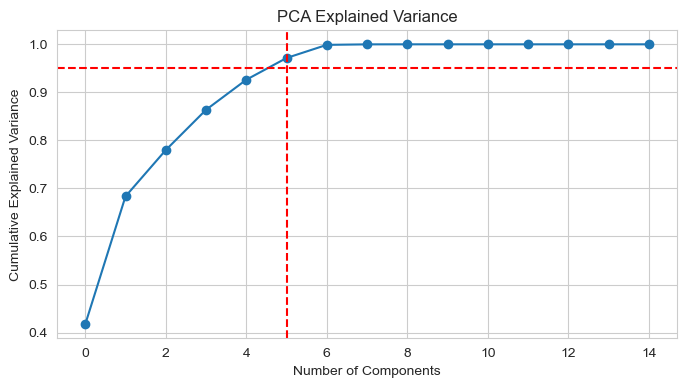

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 1, all points labeled as noise or single cluster.


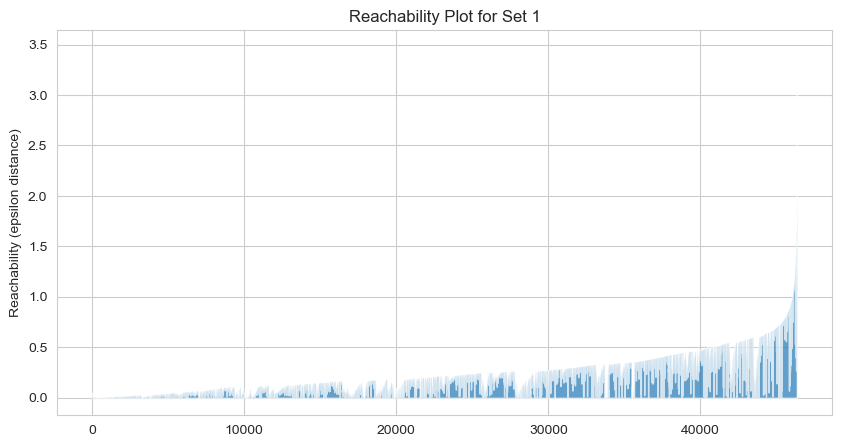

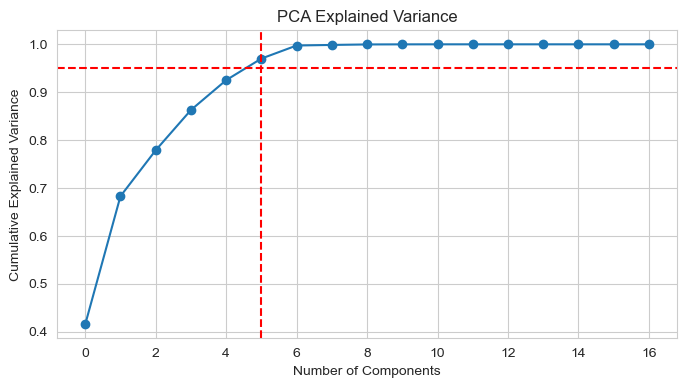

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 2, Silhouette Score: 0.5003889311954295


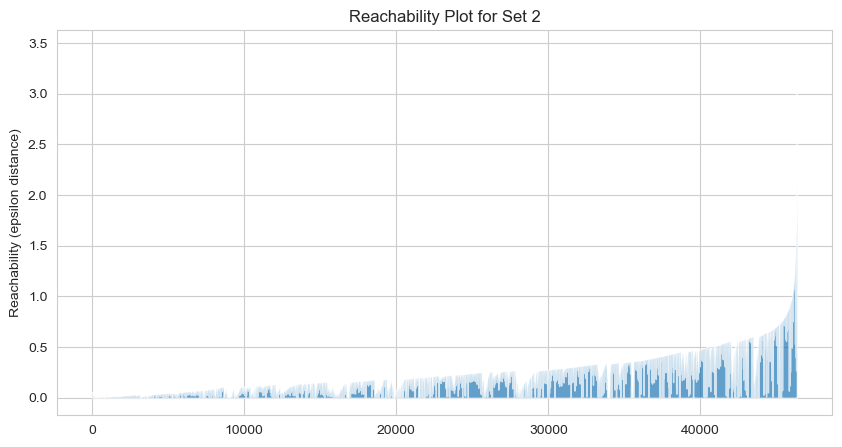

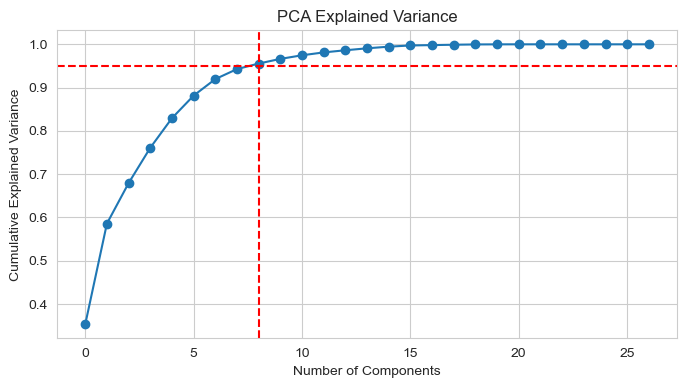

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 3, all points labeled as noise or single cluster.


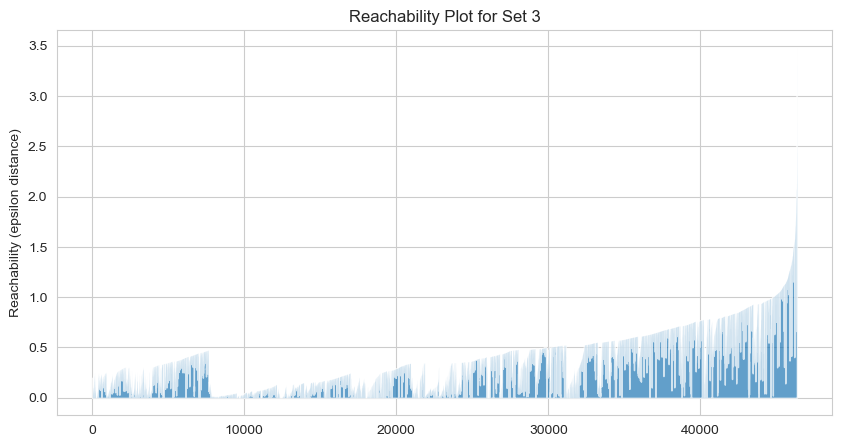

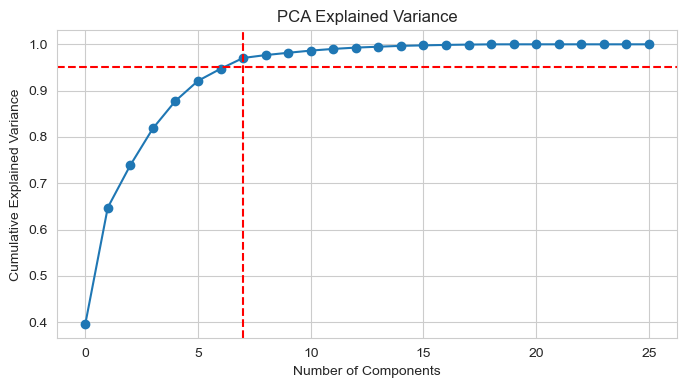

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 4, all points labeled as noise or single cluster.


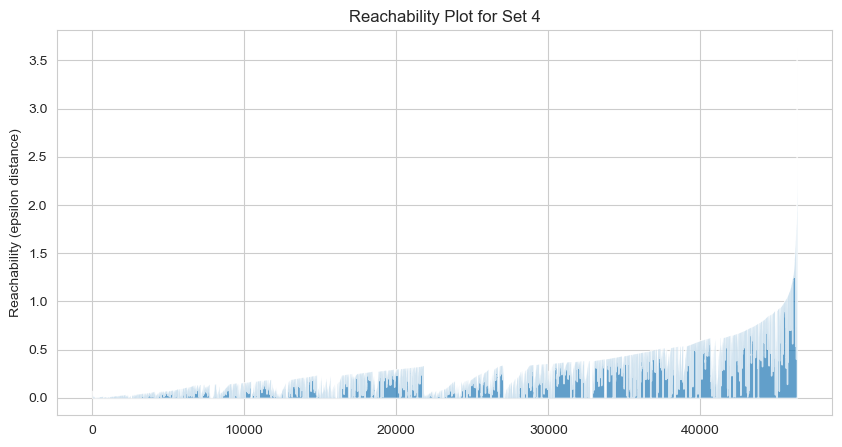

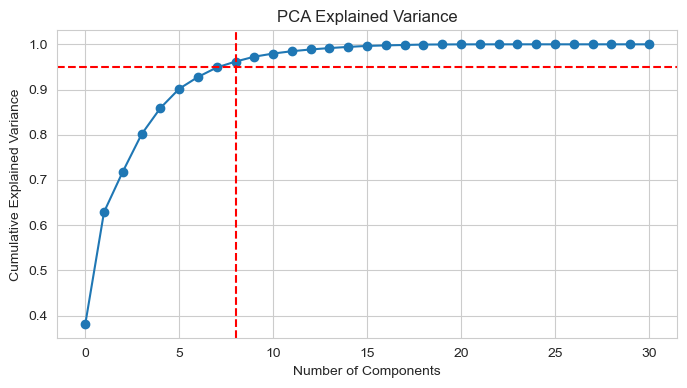

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 5, all points labeled as noise or single cluster.


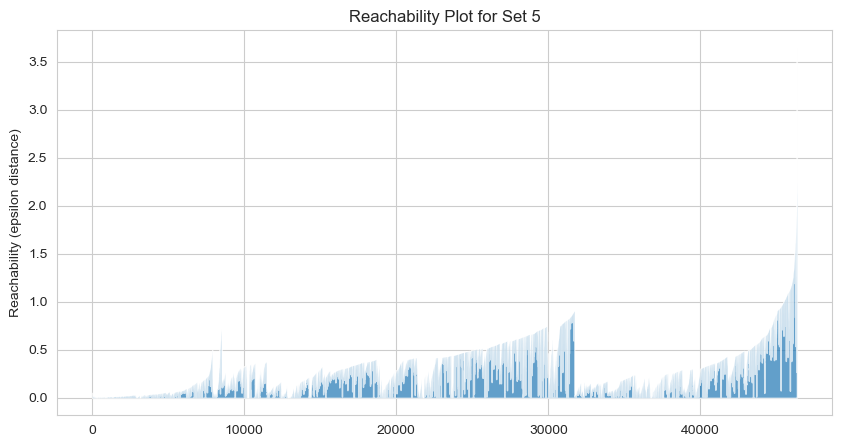

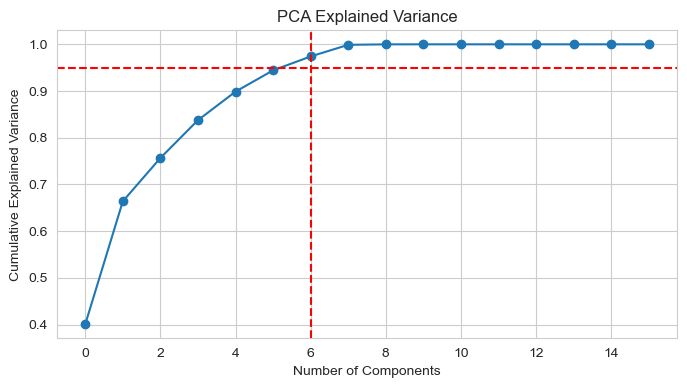

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 6, Silhouette Score: 0.5854937325168732


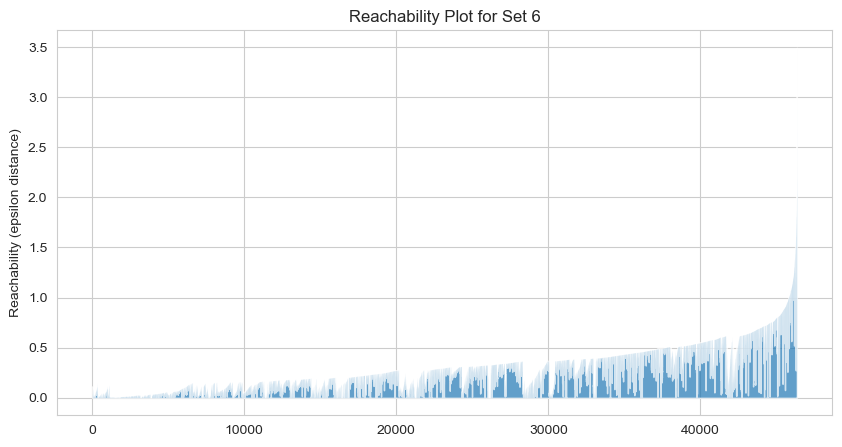

In [164]:
from sklearn.cluster import OPTICS

optics_labels = {}
silhouette_scores = {}
optimal_components_dict = {}

for name, dataset in feature_sets.items():
    preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
    data_processed = preprocessor.fit_transform(dataset)

    # Determine optimal number of components for PCA
    n_components = optimal_components(data_processed)
    optimal_components_dict[name] = n_components
    pca = PCA(n_components=n_components)
    data_reduced = pca.fit_transform(data_processed)

    # Initialize and fit the OPTICS model
    optics_model = OPTICS(min_samples=5, xi=0.05, min_cluster_size=0.05)
    optics_model.fit(data_reduced)

    # Retrieve the automatically determined labels
    labels = optics_model.labels_
    optics_labels[name] = labels

    # Silhouette Score to evaluate the performance, ignoring noise if present
    if np.unique(labels).size > 1:  # More than one cluster identified
        score = silhouette_score(data_reduced, labels)
        silhouette_scores[name] = score
        print(f"Feature set: {name}, Silhouette Score: {score}")
    else:
        print(f"Feature set: {name}, all points labeled as noise or single cluster.")

    # Plotting the reachability plot
    plt.figure(figsize=(10, 5))
    space = np.arange(len(data_reduced))
    reachability = optics_model.reachability_[optics_model.ordering_]
    plt.fill_between(space, reachability, alpha=0.7)
    plt.ylabel('Reachability (epsilon distance)')
    plt.title(f'Reachability Plot for {name}')
    plt.show()


***Data Analysis Interpretation***

***Interpretation of PCA Explained Variance Plots***

**Set 1 and Set 2**
* **PCA Performance**: Successfully captures 95% of the variance with 5 components.
* **Implication**: These sets have a relatively lower dimensionality, indicating that PCA can effectively reduce the data to a small number of components while retaining most of the variance.

**Set 3, 4, and 5**
* **PCA Performance**: Captures 95% of the variance with 8, 7, and 8 components, respectively.
* **Implication**: These sets have a slightly higher dimensionality compared to Set 1 and Set 2. PCA requires more components to capture a similar amount of variance, indicating more complex structures or diverse features in these datasets.

**Set 6**
* **PCA Performance**: Captures 95% of the variance with 6 components.
* **Implication**: This set has a dimensionality close to that of Set 1 and Set 2 but requires an additional component to capture the same amount of variance, suggesting slightly more complex or diverse features.

***Interpretation of Reachability Plots***

**Set 1, 2, 4, 6**
* **Observation**: The low reachability values (close to 0) suggest that most points are very close to their neighbors, indicating either a dense cluster or noise if they don't meet the minimum points requirement for a cluster.
* **Outliers**: Sharp increases at the end of the plot indicate points significantly distant from the main cluster, representing potential outliers.

**Set 3**
* **Initial Spike**: Shows a small spike with very low reachability at the beginning, suggesting a small group of points distant from its nearest neighbors. These might be outliers or a separate, smaller cluster.
* **Main Cluster**: After the spike, reachability values remain low and gradually increase, suggesting a dense cluster formation.
* **Outliers**: A sharp rise at the end indicates outliers or a separate group of points far from the main cluster.

**Set 5**
* **Observation**: Starts with low values but features two noticeable spikes before a sharp increase at the end.
* **Subclusters**: Suggests multiple subclusters or regions within a larger cluster, with spikes potentially representing boundaries within the cluster.
* **Outliers**: The sharp increase at the end and the earlier spikes suggest the possibility of multiple clusters or a more complex internal structure than a single dense cluster.

***Interpretation of Silhouette Score***

In our case, Set 2 and Set 6 generated a Silhouette Score of 0.5004 and 0.5855, respectively. However, based on the interpretation of the Reachability Plot, we can infer that the clusters potentially consist of a main cluster and outliers. Nevertheless, we will still perform visualizations on Set 2 and Set 6 to validate our assumption.

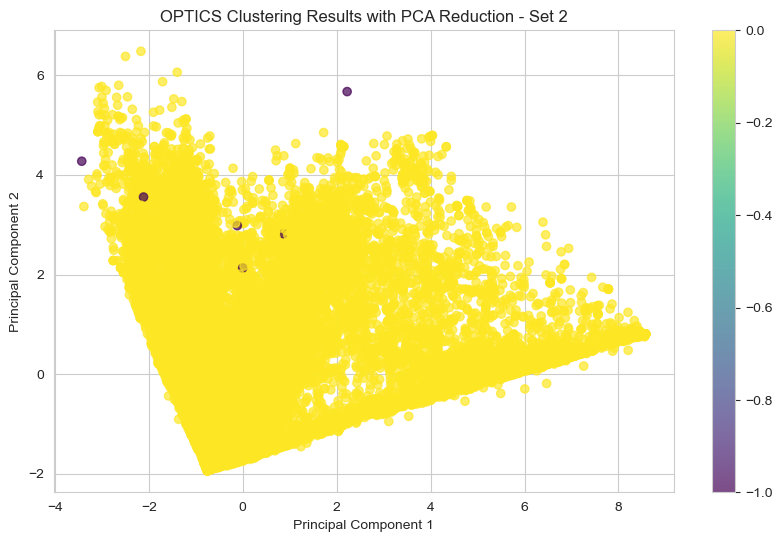

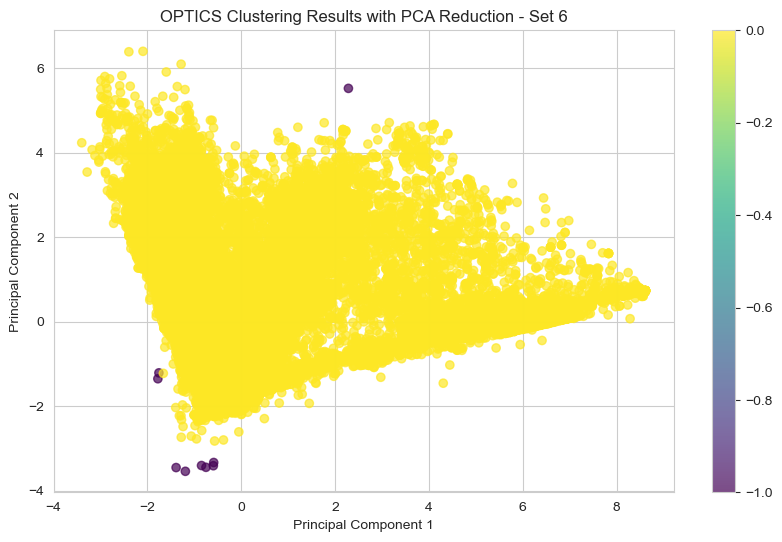

In [165]:
def plot_cluster_results(feature_set, n_components, optics_labels, set_name):
    preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
    data_processed = preprocessor.fit_transform(feature_set)

    pca = PCA(n_components=n_components)
    data_reduced = pca.fit_transform(data_processed)

    plt.figure(figsize=(10, 6))
    scatter = plt.scatter(data_reduced[:, 0], data_reduced[:, 1], c=optics_labels, alpha=0.7, cmap='viridis')
    plt.xlabel('Principal Component 1')
    plt.ylabel('Principal Component 2')
    plt.title(f'OPTICS Clustering Results with PCA Reduction - {set_name}')
    plt.colorbar(scatter)
    plt.grid(True)
    plt.show()

plot_cluster_results(feature_sets['Set 2'], 5, optics_labels['Set 2'], 'Set 2')
plot_cluster_results(feature_sets['Set 6'], 6, optics_labels['Set 6'], 'Set 6')

***Validation of Cluster Assumption***

- **Set 2 Visualization**: The visualized clusters closely align with the assumption of a main cluster and outliers, confirming the interpretation from the Reachability Plot.

- **Set 6 Visualization**: Similarly, the visualized clusters validate the assumption of a main cluster and outliers as suggested by the Reachability Plot interpretation.

### 3.5.2.1 Parameter Experimentation

Since we cannot know a priori the optimal parameters for all feature sets to obtain a valid result, experimentation becomes crucial. In this section, we make an adjustment on parameter `xi` from  0.05 to 0.03 increases sensitivity, potentially revealing smaller clusters or outliers.

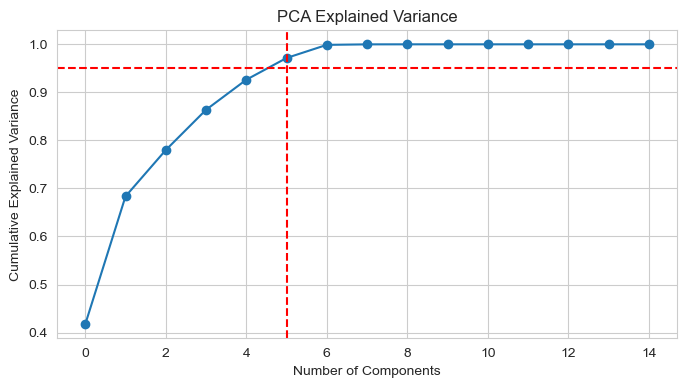

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 1, all points labeled as noise or single cluster.


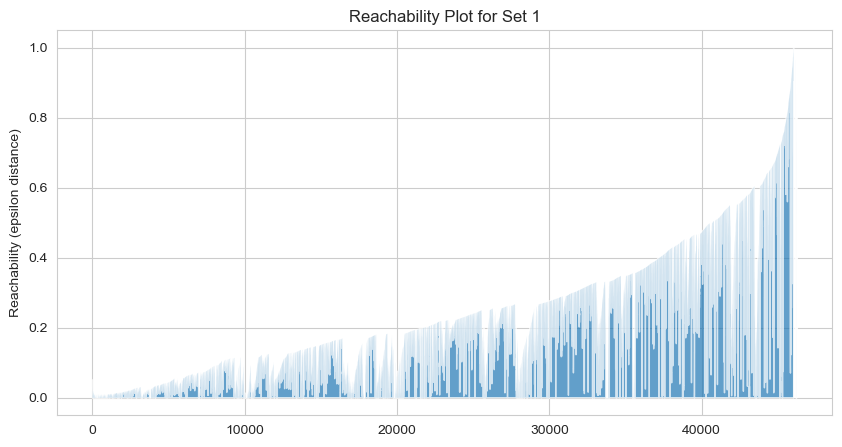

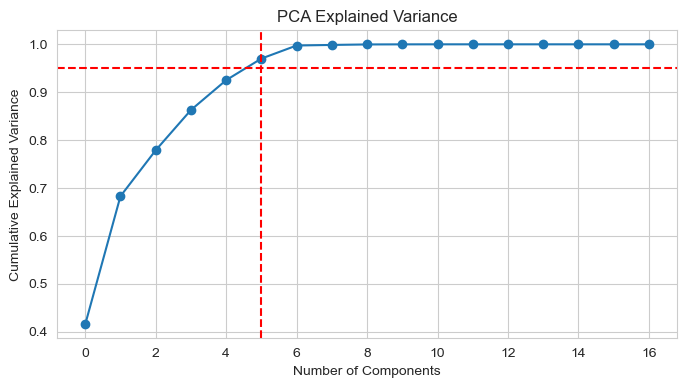

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 2, all points labeled as noise or single cluster.


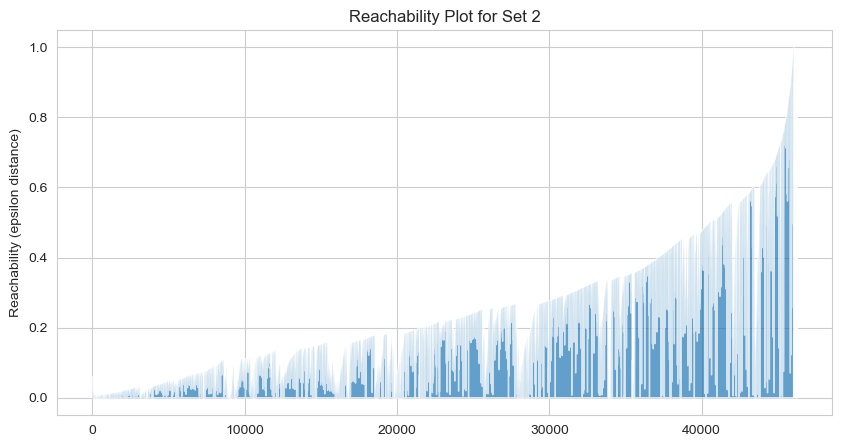

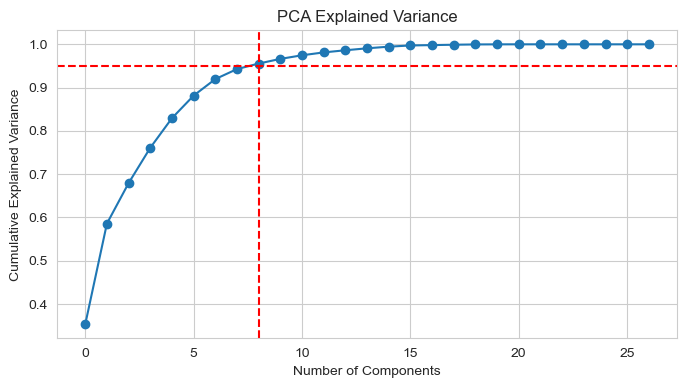

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 3, all points labeled as noise or single cluster.


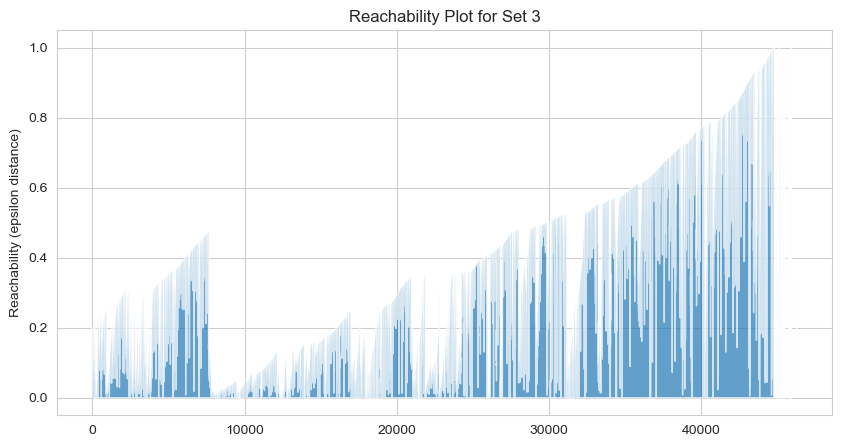

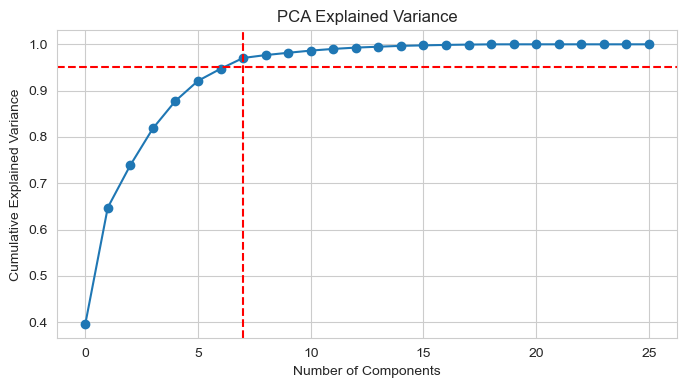

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 4, all points labeled as noise or single cluster.


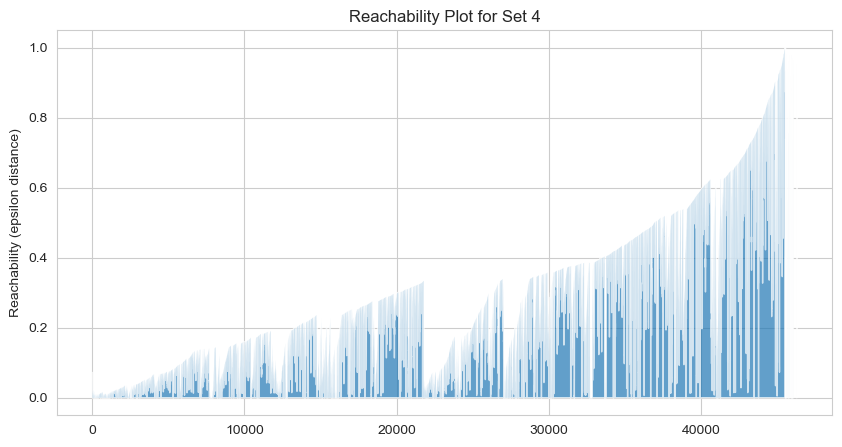

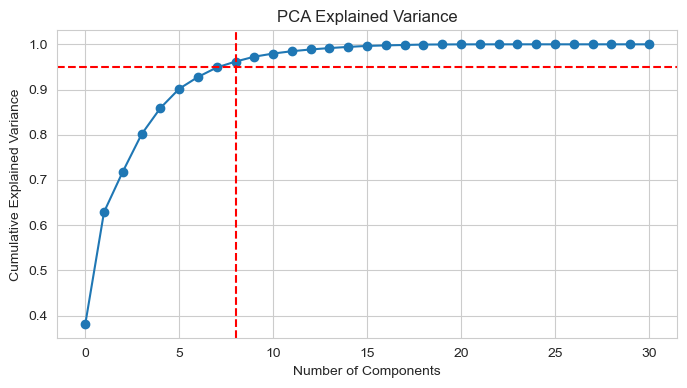

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 5, all points labeled as noise or single cluster.


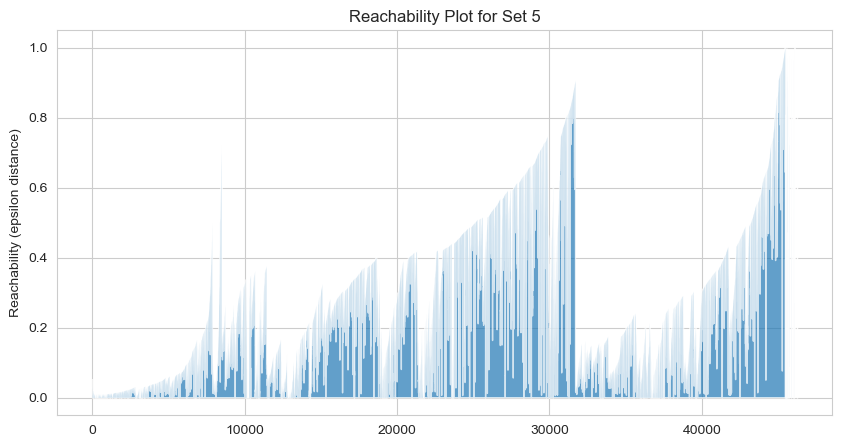

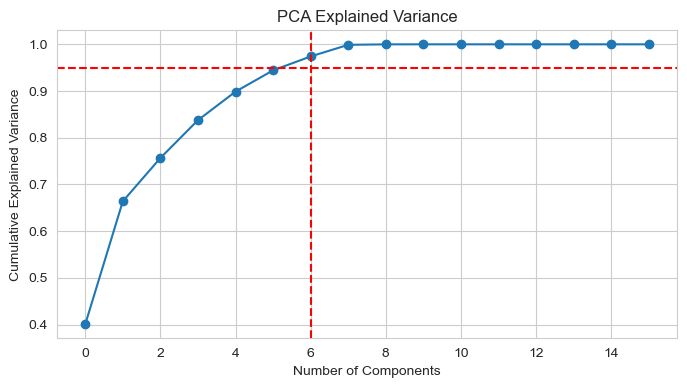

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



Feature set: Set 6, all points labeled as noise or single cluster.


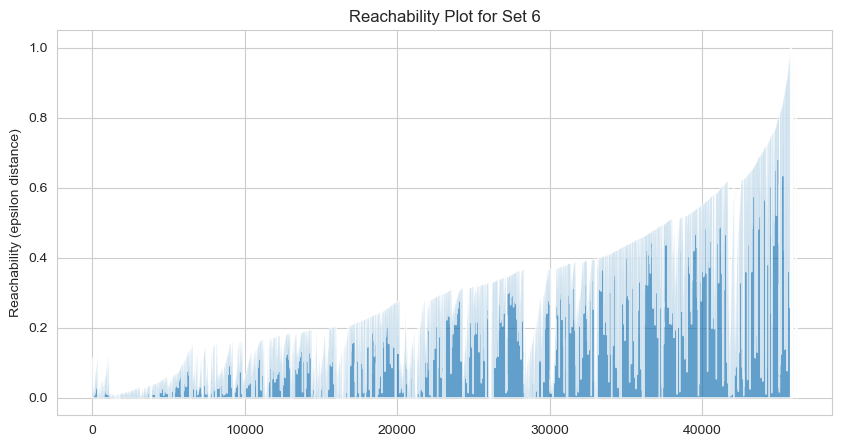

In [166]:
optics_labels = {}
silhouette_scores = {}
cluster_counts = {}

for name, dataset in feature_sets.items():
    preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
    data_processed = preprocessor.fit_transform(dataset)

    n_components = optimal_components(data_processed)
    optimal_components_dict[name] = n_components
    pca = PCA(n_components=n_components)
    data_reduced = pca.fit_transform(data_processed)

    # Adjusted OPTICS parameters based on dataset size
    optics_model = OPTICS(min_samples=5,
                          xi=0.03,
                          min_cluster_size=0.05,
                          max_eps=1)
    optics_model.fit(data_reduced)

    # Retrieve the automatically determined labels
    labels = optics_model.labels_
    optics_labels[name] = labels

    # Calculate the number of clusters (excluding noise)
    unique_labels = np.unique(labels)
    num_clusters = len(unique_labels[unique_labels != -1])
    cluster_counts[name] = num_clusters

    # Silhouette Score to evaluate the performance, ignoring noise if present
    if num_clusters > 1:
        score = silhouette_score(data_reduced, labels)
        silhouette_scores[name] = score
        print(f"Feature set: {name}, Silhouette Score: {score}, Number of Clusters: {num_clusters}")
    else:
        print(f"Feature set: {name}, all points labeled as noise or single cluster.")

    # Plotting the reachability plot
    plt.figure(figsize=(10, 5))
    space = np.arange(len(data_reduced))
    reachability = optics_model.reachability_[optics_model.ordering_]
    plt.fill_between(space, reachability, alpha=0.7)
    plt.ylabel('Reachability (epsilon distance)')
    plt.title(f'Reachability Plot for {name}')
    plt.show()

After analyzing the results from the Reachability Plots, it's evident that all feature sets failed to produce valid clusters with more than 2 components. Consequently, we need to explore alternative parameter configurations and dimensionality reduction techniques to improve clustering performance.

**Choice of Dataset for Parameter Testing: Set 1**
* **Reasoning**: Set 1 demonstrated the best performance in previous models.
* **Benefit**: Using Set 1 as the testing dataset establishes a consistent baseline for comparison and validation.

**Application of Different Dimensionality Reduction Methods**
* **Rationale**: Employing diverse dimensionality reduction techniques allows us to explore the dataset's structure from various perspectives.
* **Methods**: We'll apply both PCA and t-SNE to capture different aspects of the data and assess how clustering performance varies under different reduction strategies.

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



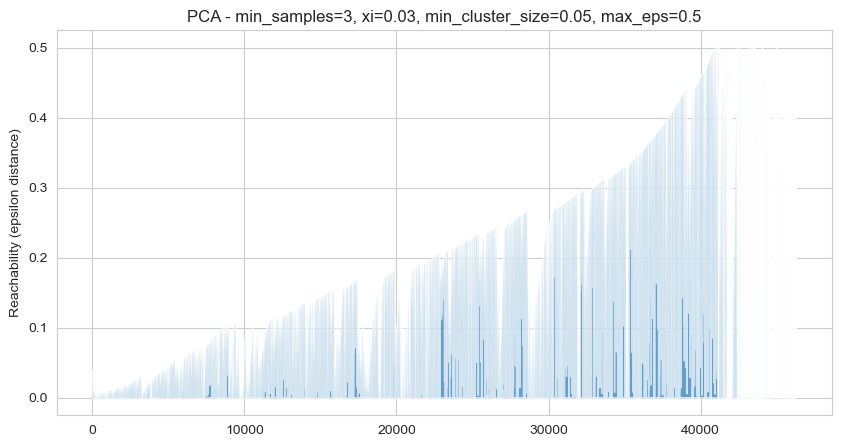

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



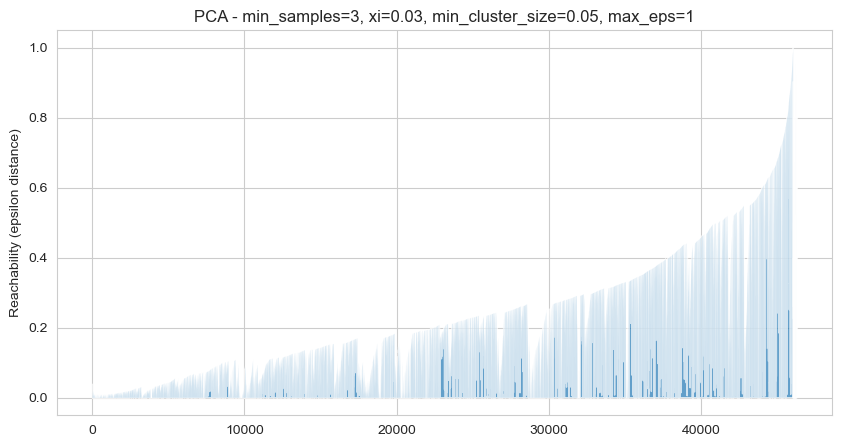

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



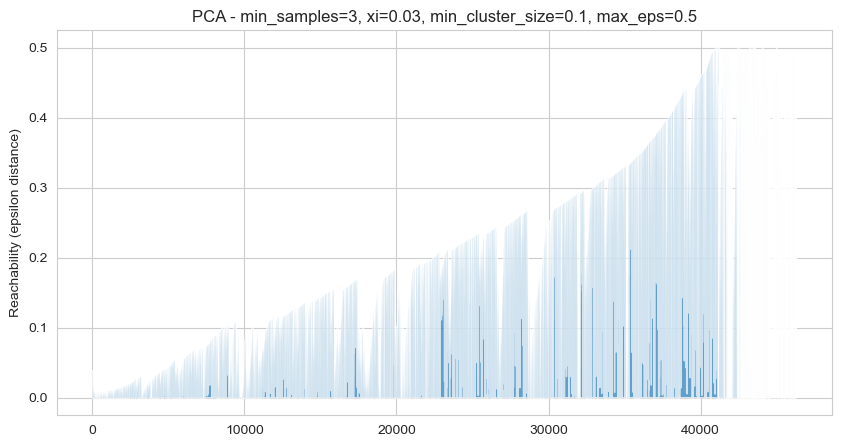

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



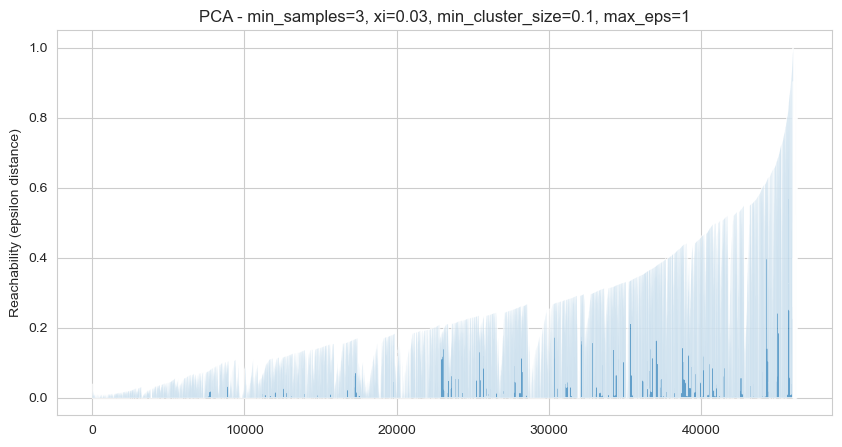

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



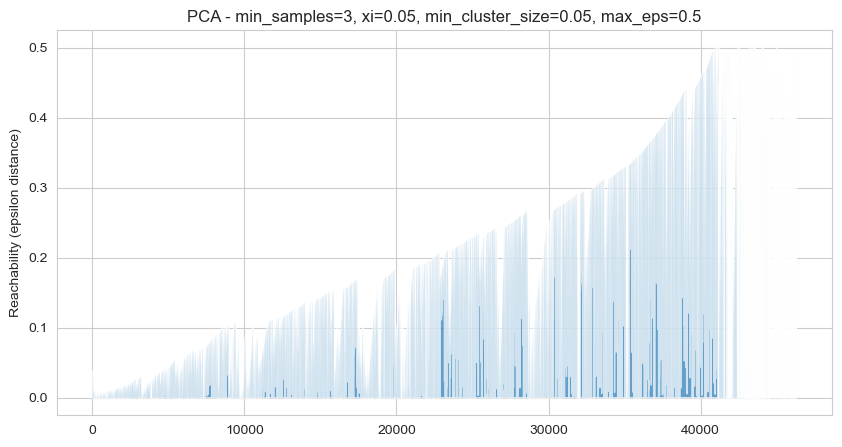

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



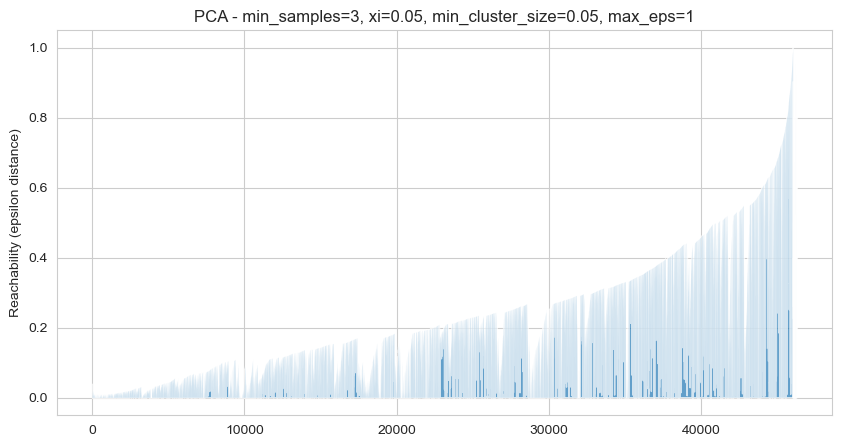

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



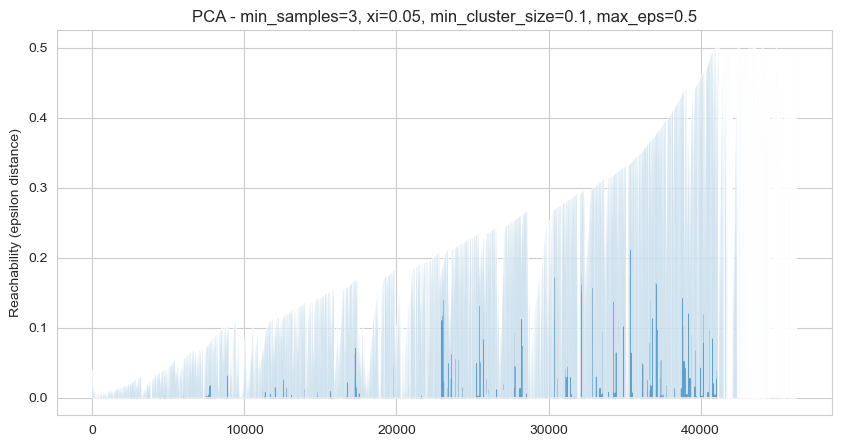

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



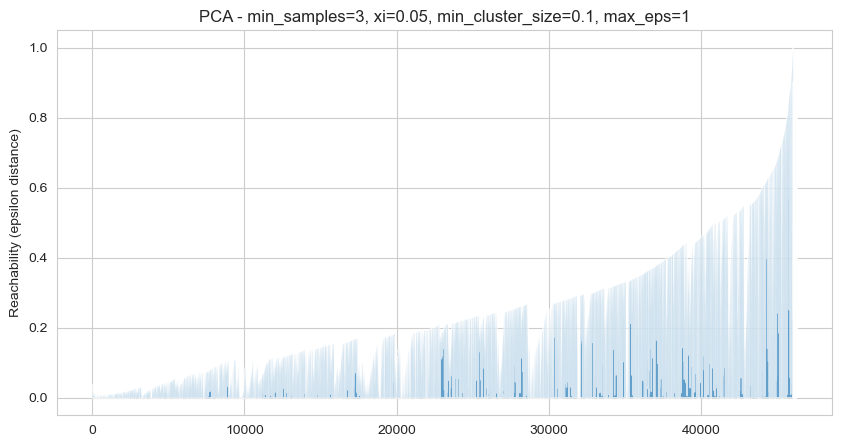

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



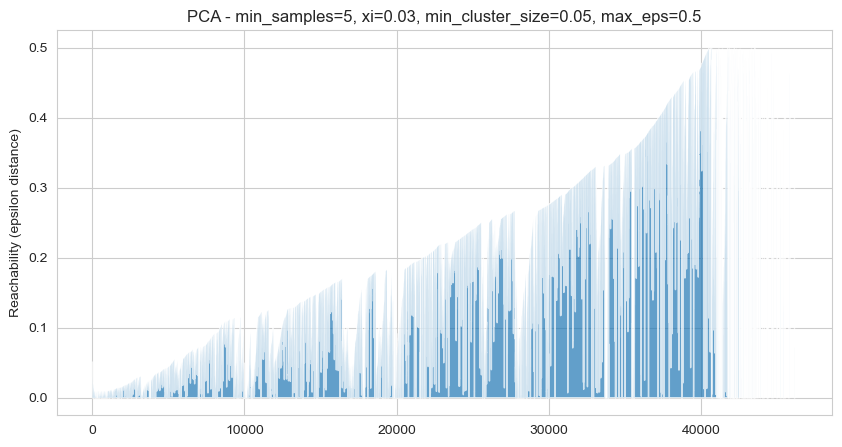

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



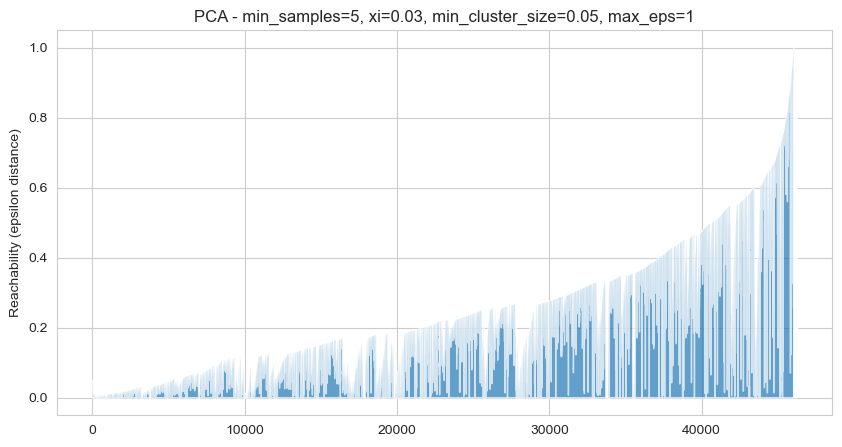

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



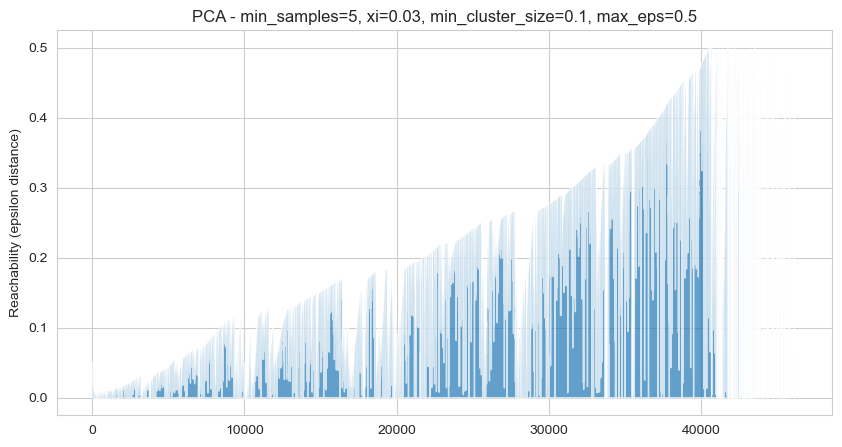

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



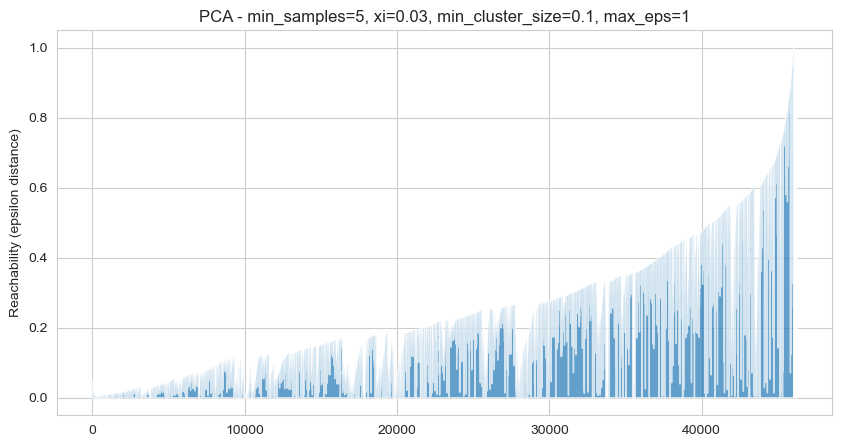

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



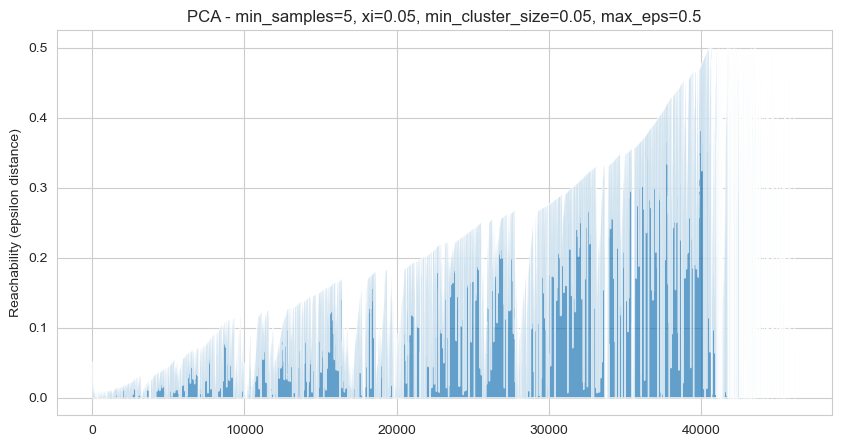

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



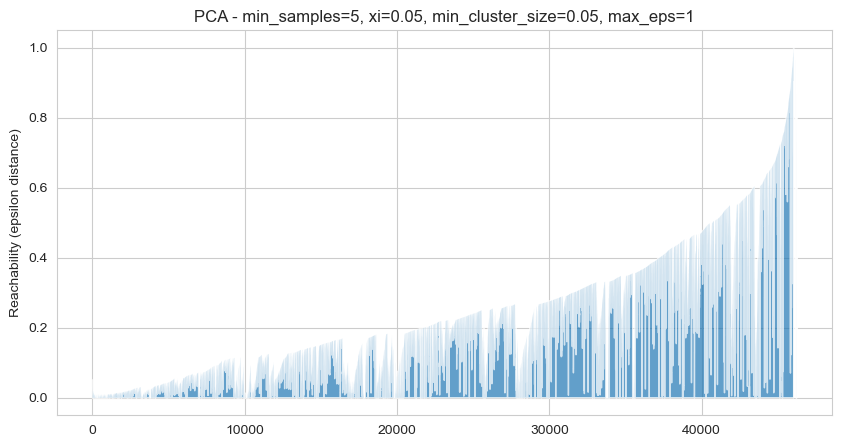

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



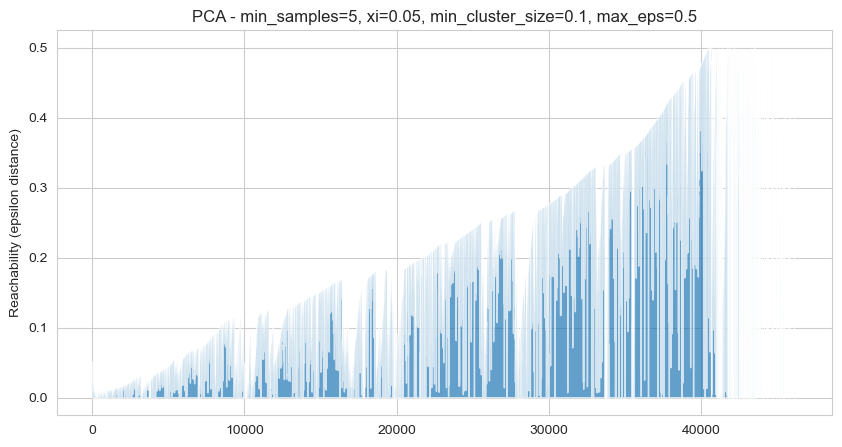

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



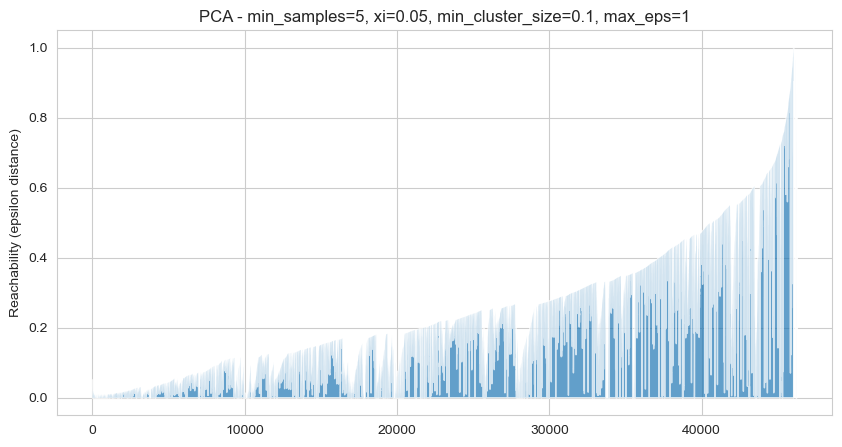

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



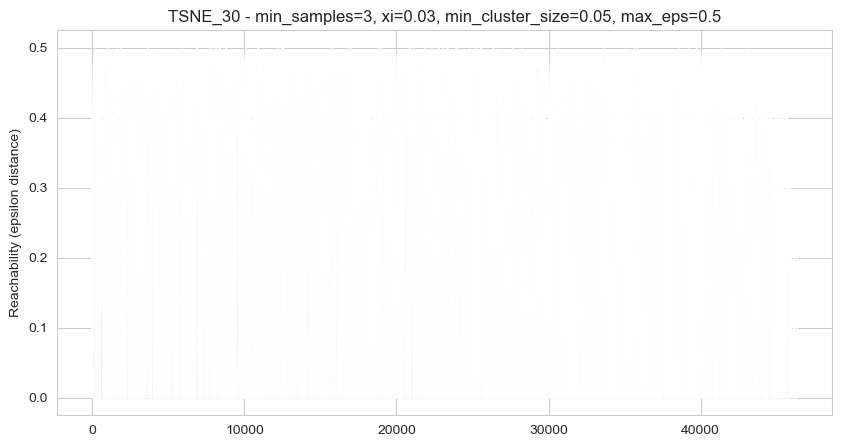

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



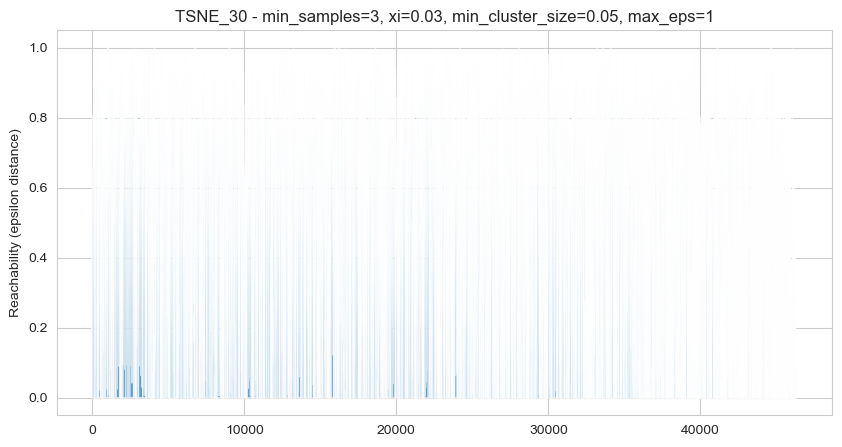

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



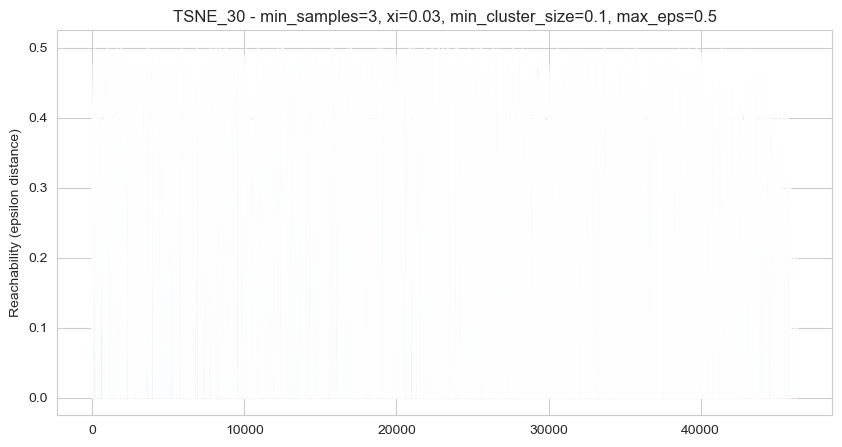

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



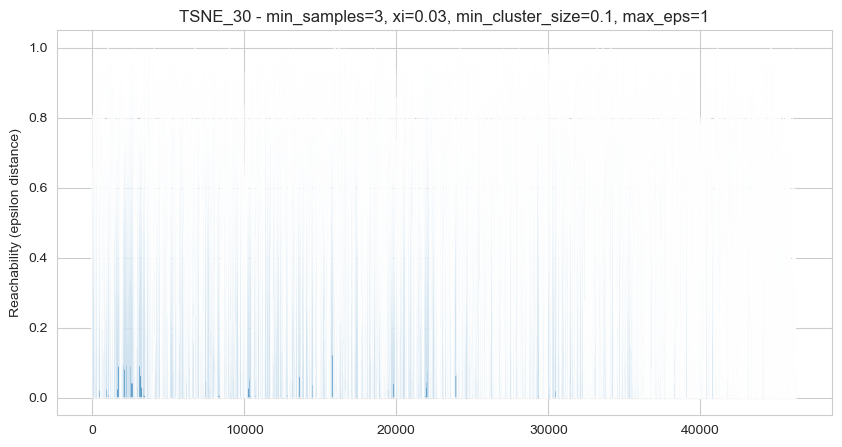

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



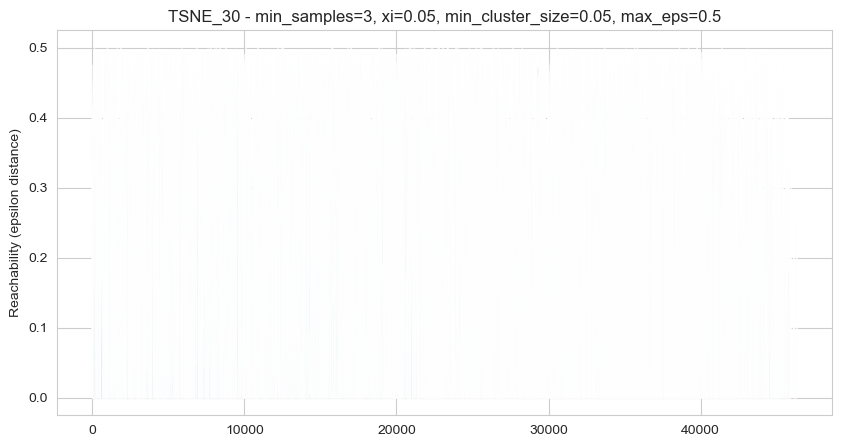

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



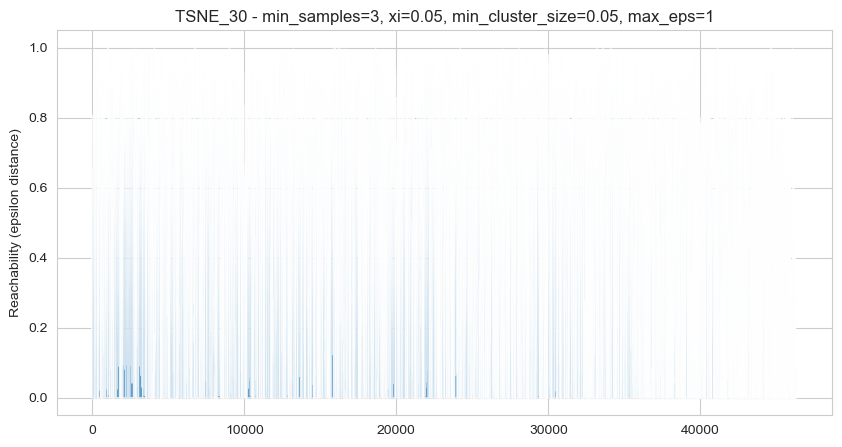

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



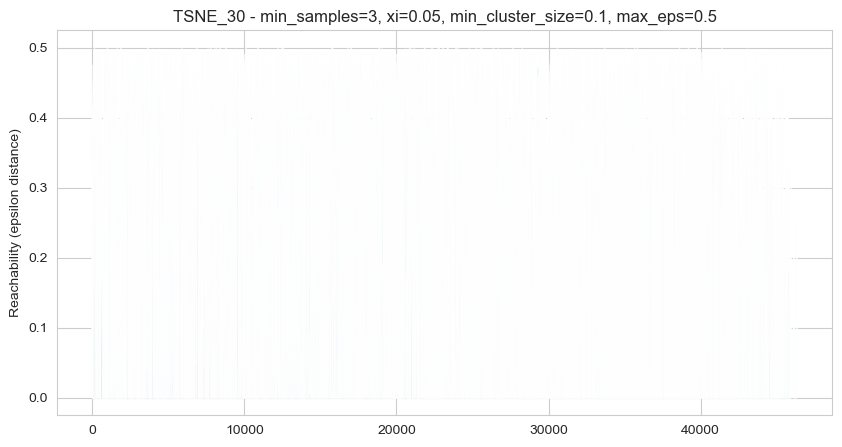

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



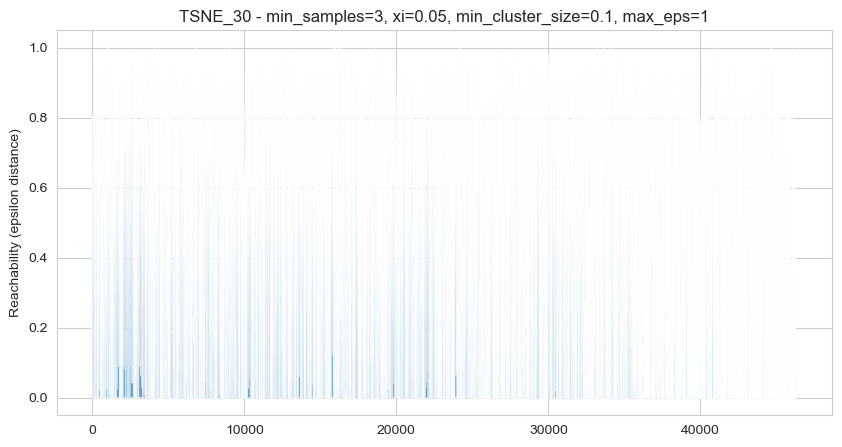

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



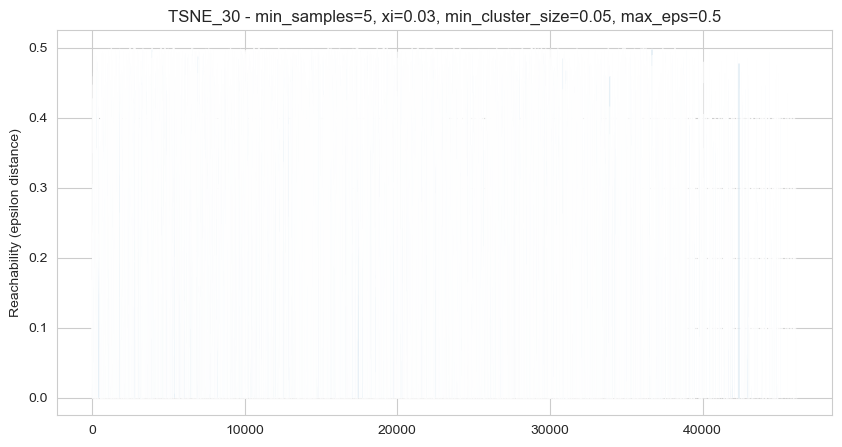

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



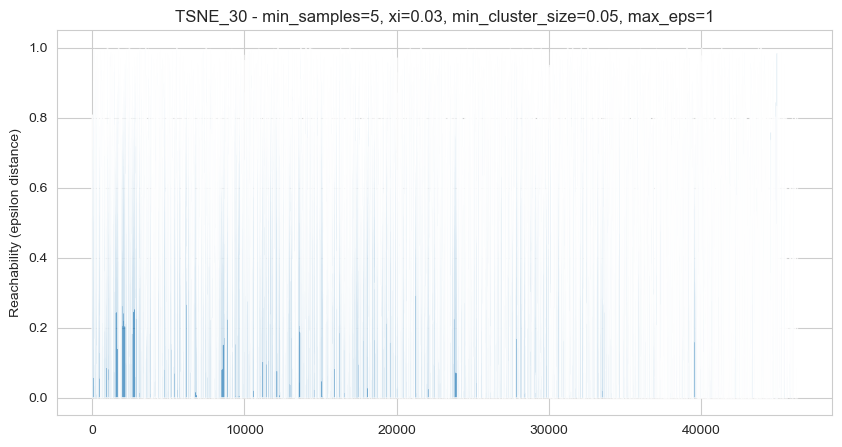

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



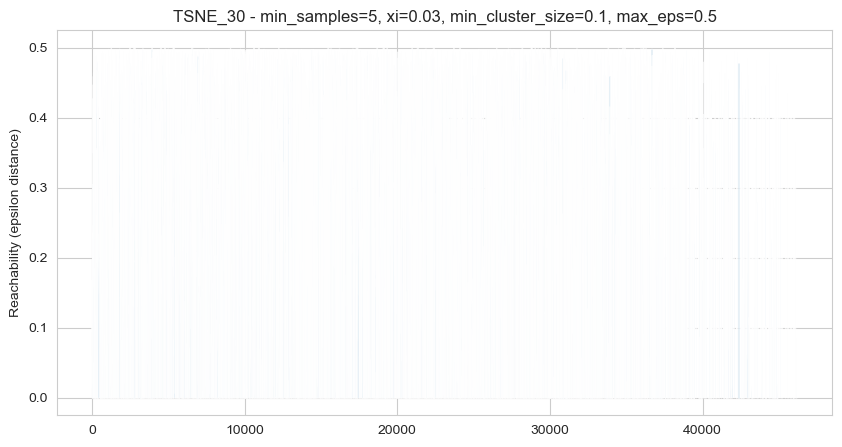

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



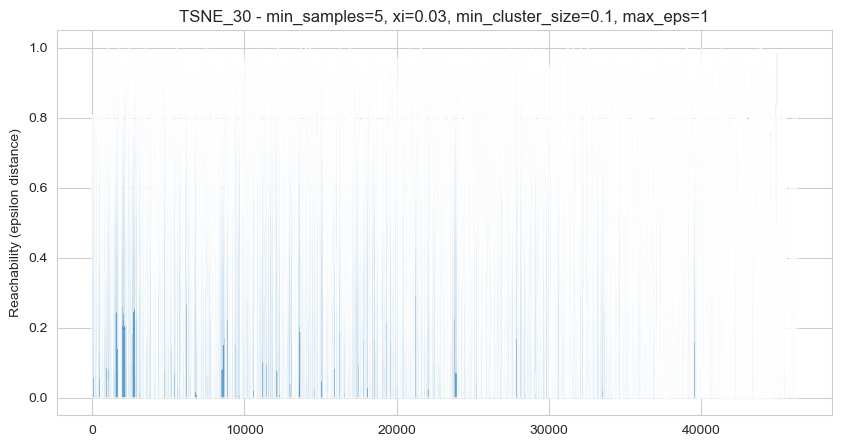

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



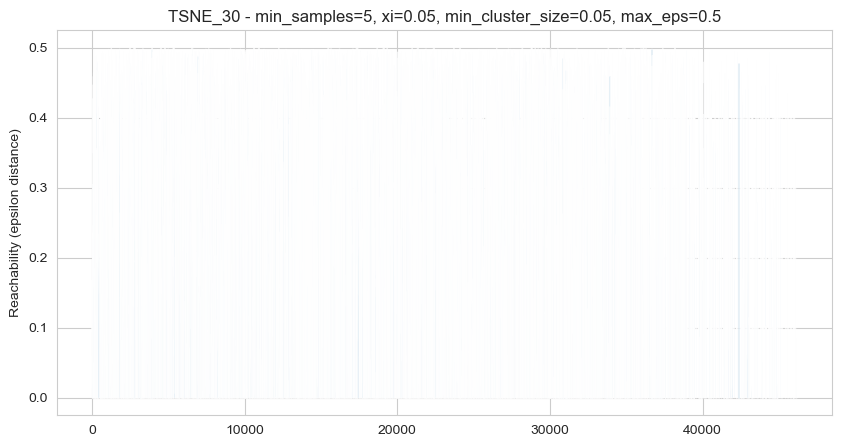

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



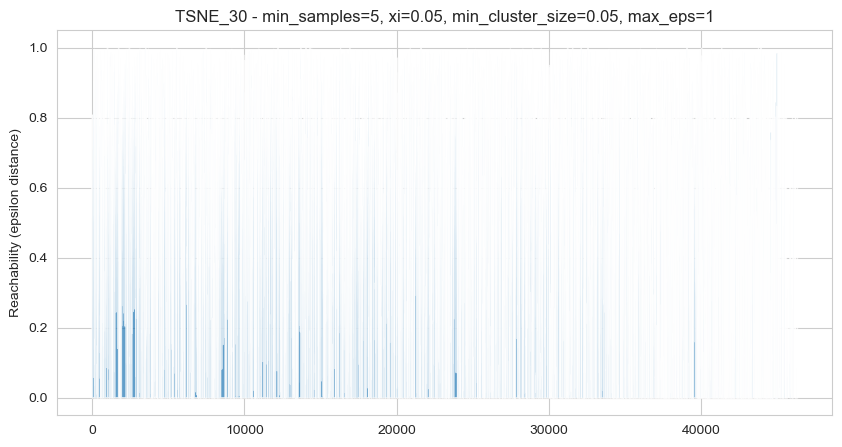

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



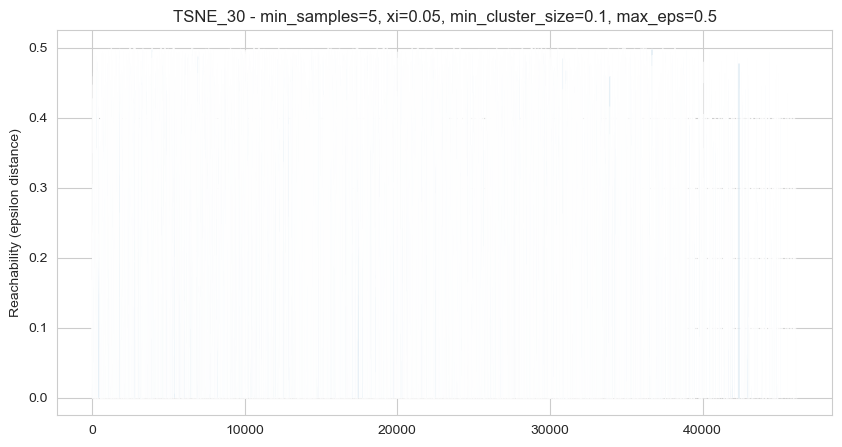

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



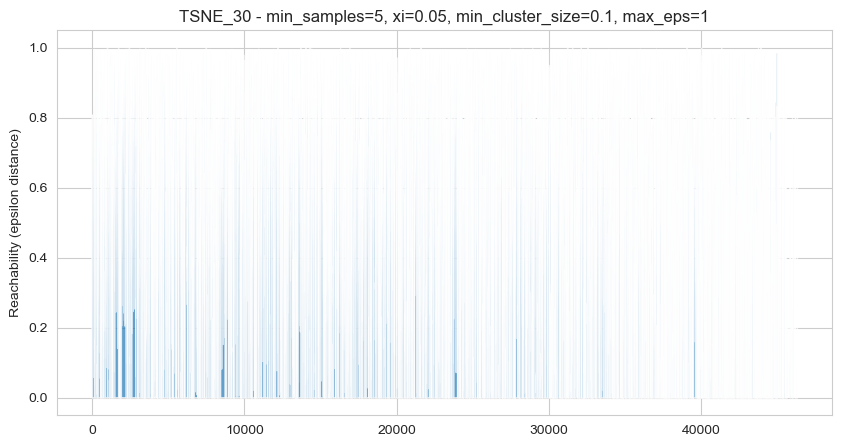

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



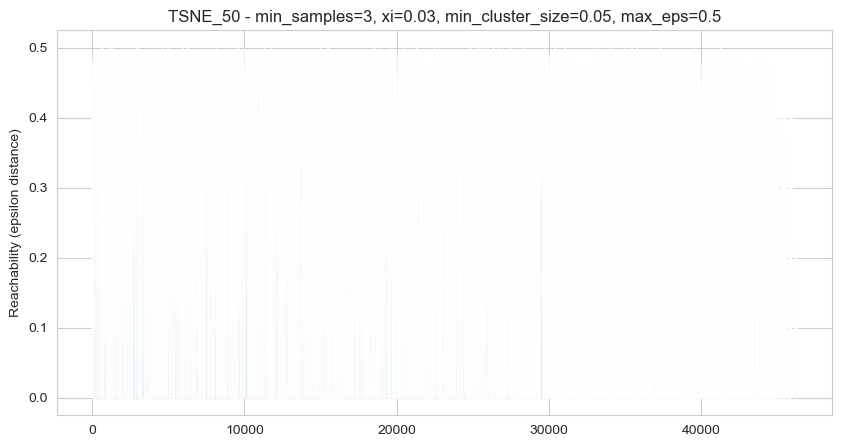

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



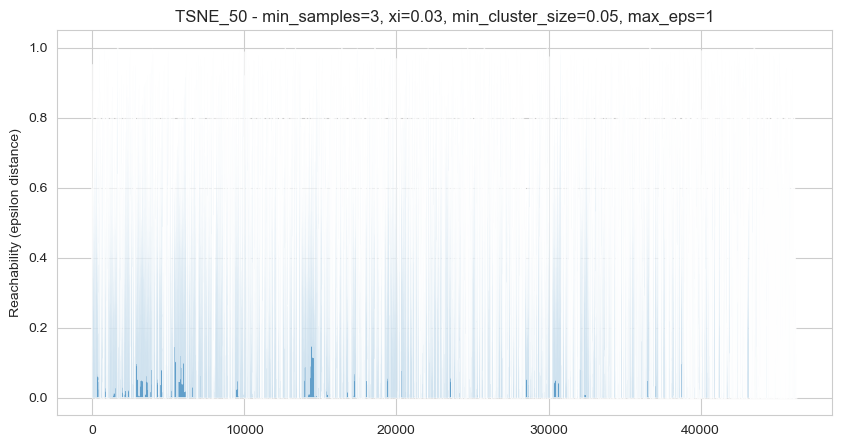

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



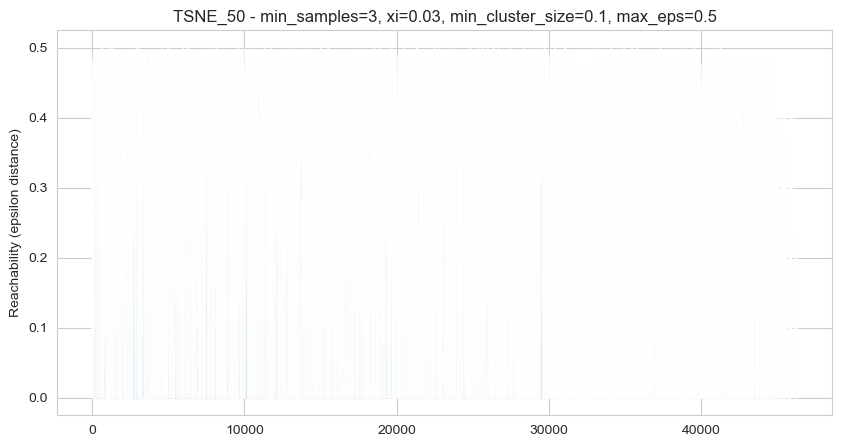

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



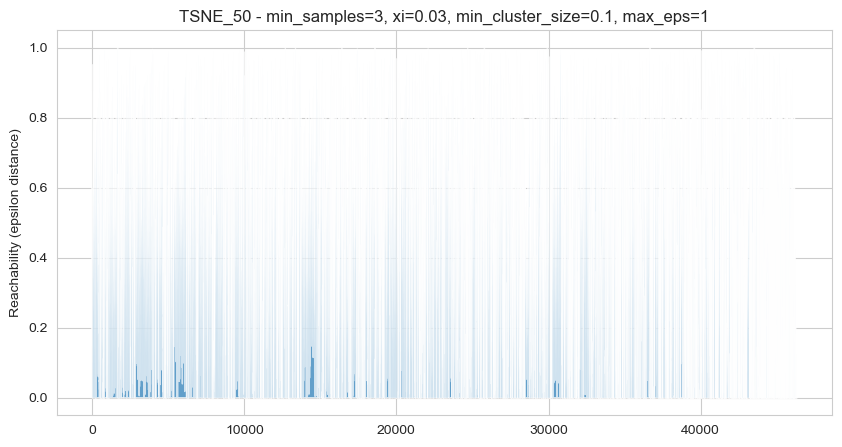

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



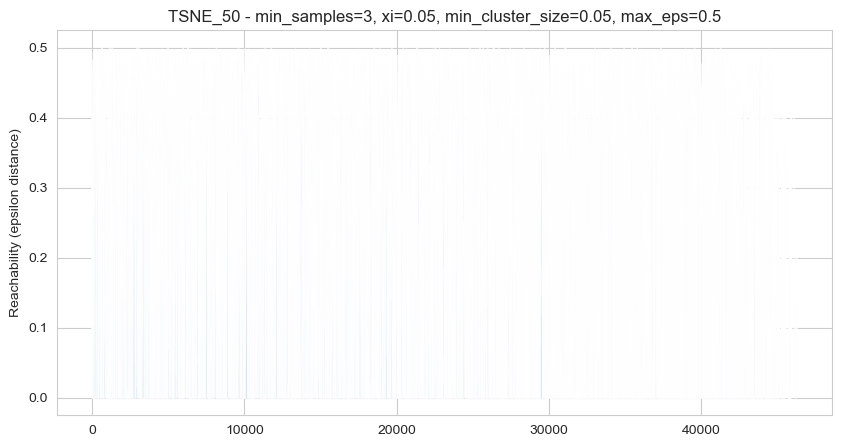

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



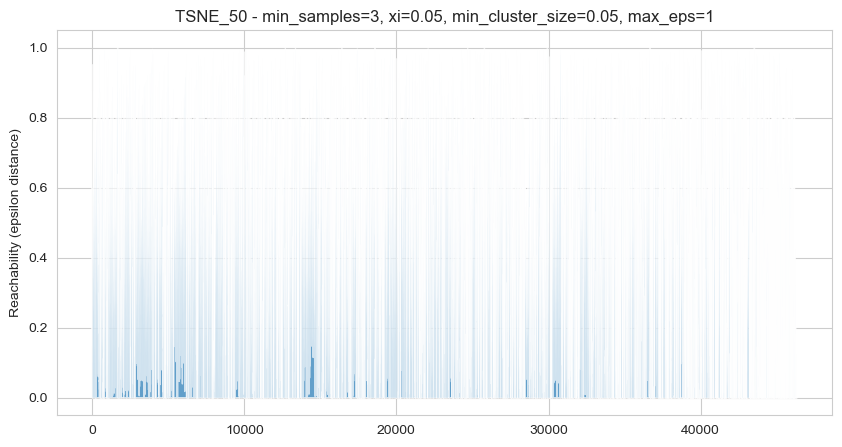

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



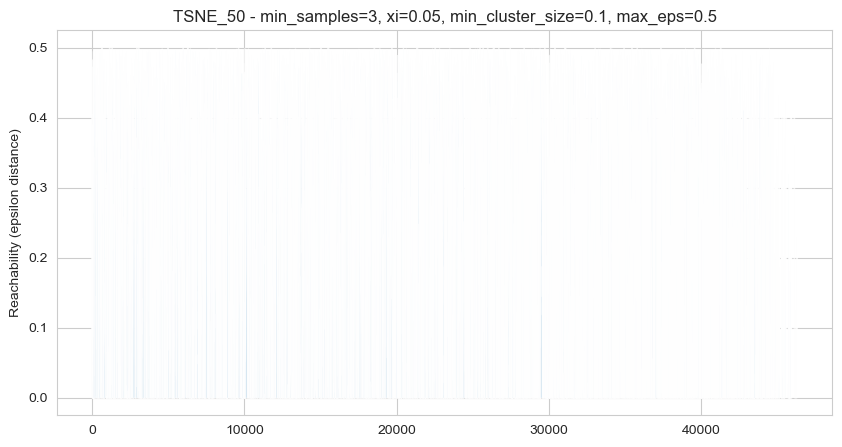

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



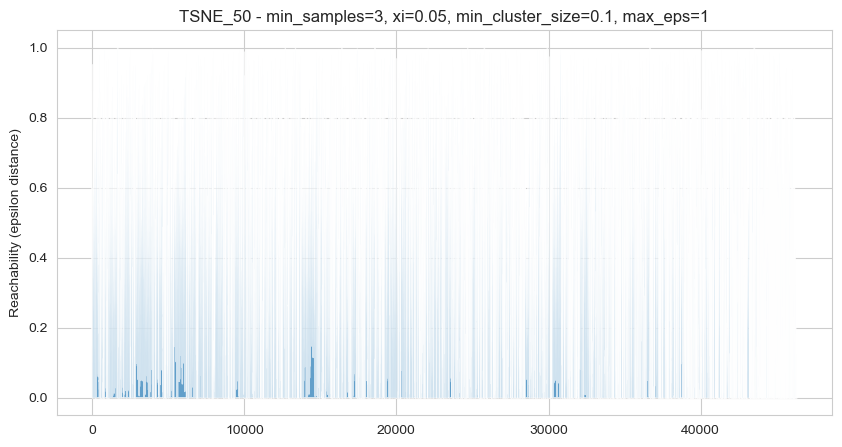

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



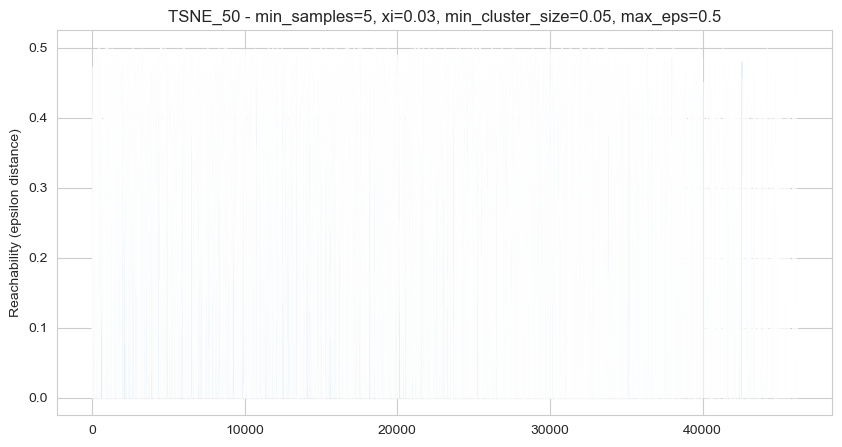

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



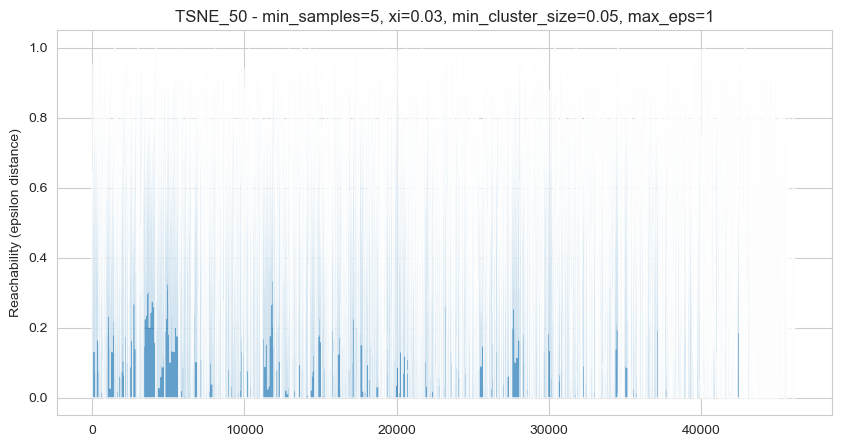

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



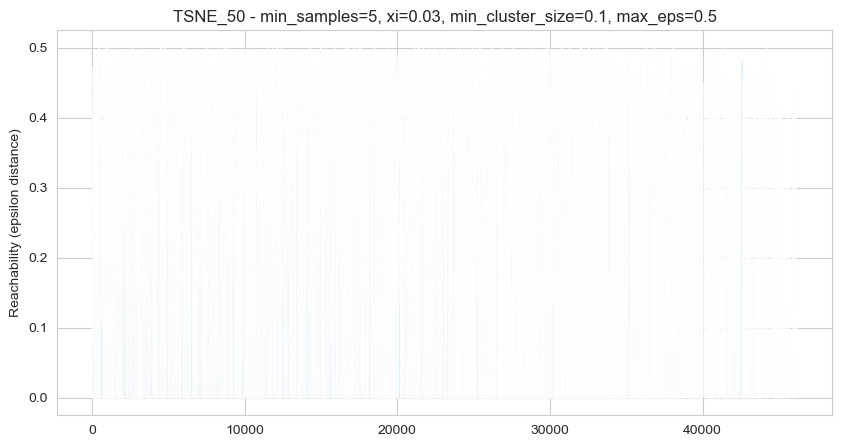

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



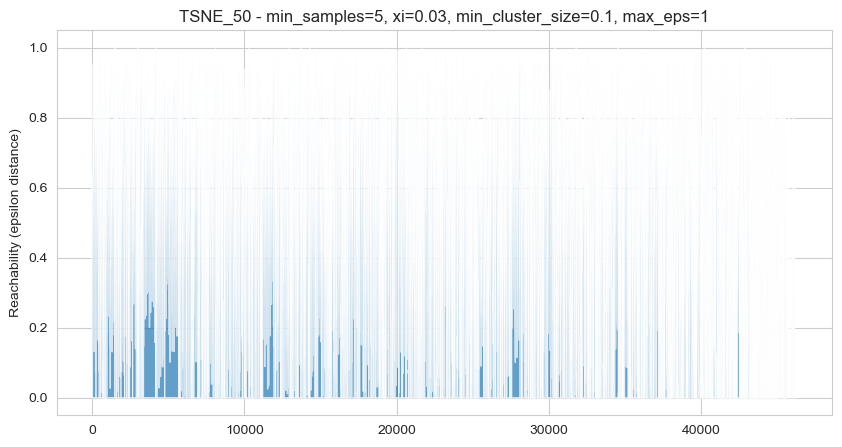

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



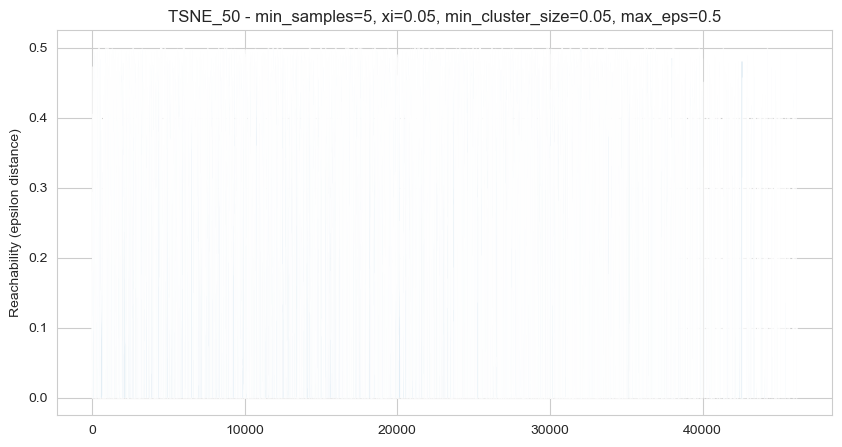

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



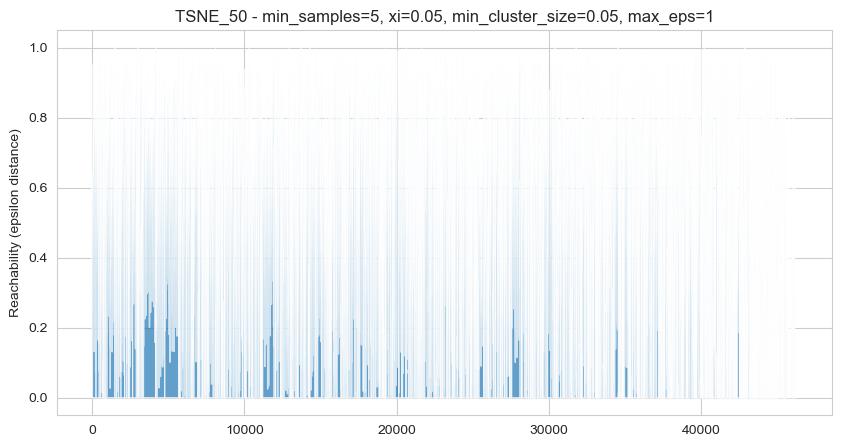

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



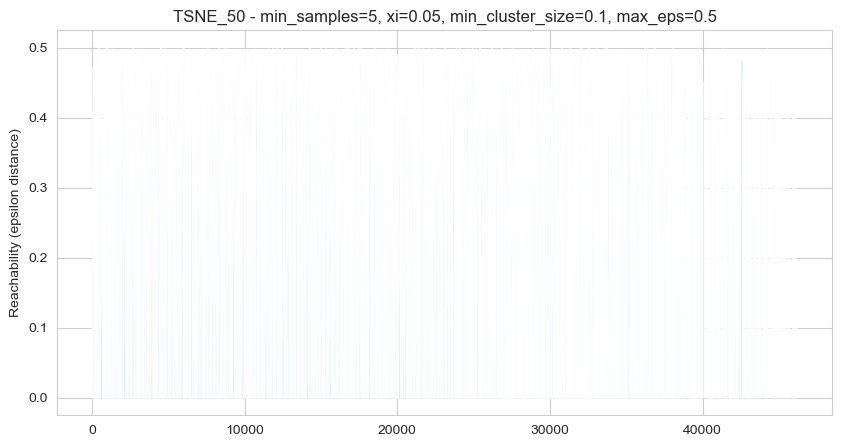

C:\Users\wr431\anaconda3\lib\site-packages\sklearn\cluster\_optics.py:1081: RuntimeWarning:

divide by zero encountered in divide



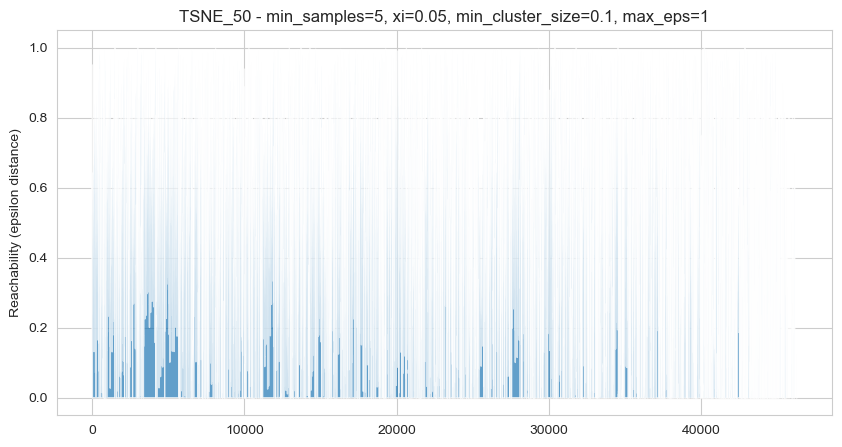

In [167]:
# Preprocess the data
dataset = feature_sets['Set 1']
preprocessor = CustomPreprocessor(nutritional_score_columns, nutritional_columns)
data_processed = preprocessor.fit_transform(dataset)

# Dimensionality Reductions
pca = PCA(n_components=6)
data_pca = pca.fit_transform(data_processed)

tsne_perplexities = [30, 50]  # Common choices for perplexity
data_tsne = {perplexity: TSNE(n_components=2, perplexity=perplexity, random_state=42).fit_transform(data_processed) for perplexity in tsne_perplexities}

# Combine all reduced data into one dictionary
dimension_reductions = {'PCA': data_pca}
dimension_reductions.update({f'TSNE_{perplexity}': data for perplexity, data in data_tsne.items()})

# OPTICS parameters for testing
optics_params = {
    'min_samples': [3, 5],
    'xi': [0.03, 0.05],
    'min_cluster_size': [0.05, 0.1],
    'max_eps': [0.5, 1]
}

# Test different combinations
results = {}
for method_name, reduced_data in dimension_reductions.items():
    for min_samples in optics_params['min_samples']:
        for xi in optics_params['xi']:
            for min_cluster_size in optics_params['min_cluster_size']:
                for max_eps in optics_params['max_eps']:
                    # Configure OPTICS
                    optics_model = OPTICS(min_samples=min_samples, xi=xi, min_cluster_size=min_cluster_size, max_eps=max_eps)
                    optics_model.fit(reduced_data)
                    labels = optics_model.labels_
                    num_clusters = len(np.unique(labels[labels != -1]))

                    # Silhouette Score
                    if num_clusters > 1:
                        score = silhouette_score(reduced_data, labels)
                    else:
                        score = None  # Not enough clusters to calculate silhouette

                    # Store results
                    param_key = (method_name, min_samples, xi, min_cluster_size, max_eps)
                    results[param_key] = {'score': score, 'num_clusters': num_clusters}

                    # Plotting for visualization
                    plt.figure(figsize=(10, 5))
                    reachability = optics_model.reachability_[optics_model.ordering_]
                    plt.fill_between(np.arange(len(reduced_data)), reachability, alpha=0.7)
                    plt.title(f'{method_name} - min_samples={min_samples}, xi={xi}, min_cluster_size={min_cluster_size}, max_eps={max_eps}')
                    plt.ylabel('Reachability (epsilon distance)')
                    plt.show()

# Print best results
for params, res in results.items():
    if res['score'] is not None:
        print(f"{params}: Silhouette Score = {res['score']}, Number of Clusters = {res['num_clusters']}")

In [168]:
results

{('PCA', 3, 0.03, 0.05, 0.5): {'score': None, 'num_clusters': 1},
 ('PCA', 3, 0.03, 0.05, 1): {'score': None, 'num_clusters': 1},
 ('PCA', 3, 0.03, 0.1, 0.5): {'score': None, 'num_clusters': 1},
 ('PCA', 3, 0.03, 0.1, 1): {'score': None, 'num_clusters': 1},
 ('PCA', 3, 0.05, 0.05, 0.5): {'score': None, 'num_clusters': 1},
 ('PCA', 3, 0.05, 0.05, 1): {'score': None, 'num_clusters': 1},
 ('PCA', 3, 0.05, 0.1, 0.5): {'score': None, 'num_clusters': 1},
 ('PCA', 3, 0.05, 0.1, 1): {'score': None, 'num_clusters': 1},
 ('PCA', 5, 0.03, 0.05, 0.5): {'score': None, 'num_clusters': 1},
 ('PCA', 5, 0.03, 0.05, 1): {'score': None, 'num_clusters': 1},
 ('PCA', 5, 0.03, 0.1, 0.5): {'score': None, 'num_clusters': 1},
 ('PCA', 5, 0.03, 0.1, 1): {'score': None, 'num_clusters': 1},
 ('PCA', 5, 0.05, 0.05, 0.5): {'score': None, 'num_clusters': 1},
 ('PCA', 5, 0.05, 0.05, 1): {'score': None, 'num_clusters': 1},
 ('PCA', 5, 0.05, 0.1, 0.5): {'score': None, 'num_clusters': 1},
 ('PCA', 5, 0.05, 0.1, 1): {'sc

After extensive testing of OPTICS with various parameter configurations and utilizing dimensionality reduction techniques such as PCA and t-SNE, the consistent outcome across experiments indicates the inability of OPTICS to identify distinct clusters within the dataset. This suggests that the dataset lacks distinguishable clusters based on the density criteria utilized by OPTICS.

**Possible Reasons for Lack of Clusters:**
1. **High Density**: The dataset may be too densely packed, making it challenging for OPTICS to delineate meaningful clusters based on density.
2. **Inherent Data Characteristics**: The underlying structure of the data might not conform to the assumptions of density-based clustering algorithms like OPTICS.

# <div align="center">End of Assignment</div>